In [1]:
# imports
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as stats
import gseapy as gp
import networkx as nx
import os

# this is necessary only for better label positioning
!pip install adjustText

# import all functions from utils.py that is inside src folder
from src.utils import *

In [259]:
pou2f2_ens = 'ENSG00000028277.21'
tert_ens = 'ENSG00000164362.18'
tp53_ens = 'ENSG00000141510.16'

## Raw expression and methylation


In [324]:
# Raw cms2 expression
cms2_expr = pd.read_csv("/Users/violafanfani/Documents/uni-harvard/projects/tcga-data-supplement/data/processed/batch-coad-subtype-20240510/tcga_coad_cms2/data_prepared/recount3/recount3_tcga_coad_cms2_purity03_normlogcpm_mintpm1_fracsamples02_tissuetumor_batchtcgagdcplatform_adjtcgagdcplatform.txt", sep = '\t', index_col = 0)
cms2_methyl = pd.read_csv("/Users/violafanfani/Documents/uni-harvard/projects/tcga-data-supplement/data/processed/batch-coad-subtype-20240510/tcga_coad_cms2/data_prepared/methylation/tcga_coad_cms2_tf_promoter_methylation_raw.csv", index_col = 0)
cms2_methyl.set_index('TCGA_barcode', inplace=True)

# cms4
# Raw cms2 expression
cms4_expr = pd.read_csv("/Users/violafanfani/Documents/uni-harvard/projects/tcga-data-supplement/data/processed/batch-coad-subtype-20240510/tcga_coad_cms4/data_prepared/recount3/recount3_tcga_coad_cms4_purity03_normlogcpm_mintpm1_fracsamples02_tissuetumor_batchtcgagdcplatform_adjtcgagdcplatform.txt", sep = '\t', index_col = 0)
cms4_methyl = pd.read_csv("/Users/violafanfani/Documents/uni-harvard/projects/tcga-data-supplement/data/processed/batch-coad-subtype-20240510/tcga_coad_cms4/data_prepared/methylation/tcga_coad_cms4_tf_promoter_methylation_raw.csv", index_col = 0)
cms4_methyl.set_index('TCGA_barcode', inplace=True)

In [325]:
# Raw cms1 expression
cms1_expr = pd.read_csv("/Users/violafanfani/Documents/uni-harvard/projects/tcga-data-supplement/data/processed/batch-coad-subtype-20240510/tcga_coad_cms1/data_prepared/recount3/recount3_tcga_coad_cms1_purity03_normlogcpm_mintpm1_fracsamples02_tissuetumor_batchtcgagdcplatform_adjtcgagdcplatform.txt", sep = '\t', index_col = 0)
cms1_methyl = pd.read_csv("/Users/violafanfani/Documents/uni-harvard/projects/tcga-data-supplement/data/processed/batch-coad-subtype-20240510/tcga_coad_cms1/data_prepared/methylation/tcga_coad_cms1_tf_promoter_methylation_raw.csv", index_col = 0)
cms1_methyl.set_index('TCGA_barcode', inplace=True)

# cms3
# Raw cms2 expression
cms3_expr = pd.read_csv("/Users/violafanfani/Documents/uni-harvard/projects/tcga-data-supplement/data/processed/batch-coad-subtype-20240510/tcga_coad_cms3/data_prepared/recount3/recount3_tcga_coad_cms3_purity03_normlogcpm_mintpm1_fracsamples02_tissuetumor_batchtcgagdcplatform_adjtcgagdcplatform.txt", sep = '\t', index_col = 0)
cms3_methyl = pd.read_csv("/Users/violafanfani/Documents/uni-harvard/projects/tcga-data-supplement/data/processed/batch-coad-subtype-20240510/tcga_coad_cms3/data_prepared/methylation/tcga_coad_cms3_tf_promoter_methylation_raw.csv", index_col = 0)
cms3_methyl.set_index('TCGA_barcode', inplace=True)

In [326]:
cms2_expr_oi = cms2_expr.loc[[pou2f2_ens, tp53_ens, tert_ens],:].T
cms2_expr_oi.columns = ['POU2F2_expression', 'TP53_expression', 'SNAPC4_expression']
# same for cms4
cms4_expr_oi = cms4_expr.loc[[pou2f2_ens, tp53_ens, tert_ens],:].T
cms4_expr_oi.columns = ['POU2F2_expression', 'TP53_expression', 'SNAPC4_expression']
# Same for cms1 and cms3
cms1_expr_oi = cms1_expr.loc[[pou2f2_ens, tp53_ens, tert_ens],:].T
cms1_expr_oi.columns = ['POU2F2_expression', 'TP53_expression', 'SNAPC4_expression']
cms3_expr_oi = cms3_expr.loc[[pou2f2_ens, tp53_ens, tert_ens],:].T
cms3_expr_oi.columns = ['POU2F2_expression', 'TP53_expression', 'SNAPC4_expression']

In [356]:
cms2_expr_oi.index = cms2_expr_oi.index.str[:16]
cms4_expr_oi.index = cms4_expr_oi.index.str[:16]
cms1_expr_oi.index = cms1_expr_oi.index.str[:16]
cms3_expr_oi.index = cms3_expr_oi.index.str[:16]

cms2_expr_oi['subtype'] = 'CMS2'
cms4_expr_oi['subtype'] = 'CMS4'
cms1_expr_oi['subtype'] = 'CMS1'
cms3_expr_oi['subtype'] = 'CMS3'
data_oi = pd.concat([cms2_expr_oi, cms4_expr_oi, cms1_expr_oi, cms3_expr_oi], axis=0)
data_oi_expr = data_oi.copy()

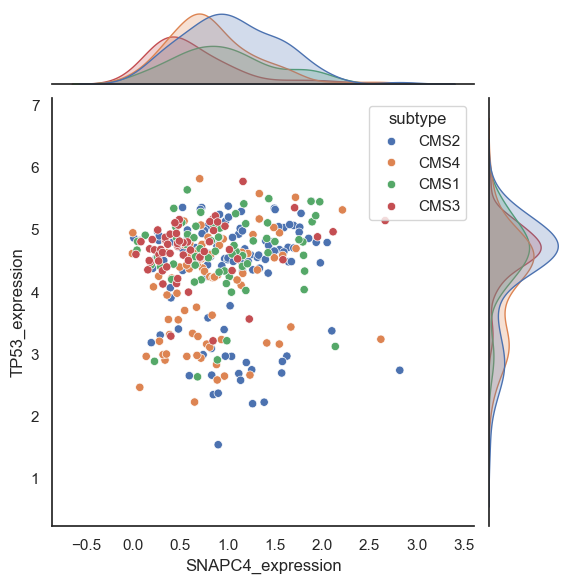

In [357]:
sns.jointplot(data=data_oi_expr, x='SNAPC4_expression', y='TP53_expression', hue = 'subtype')


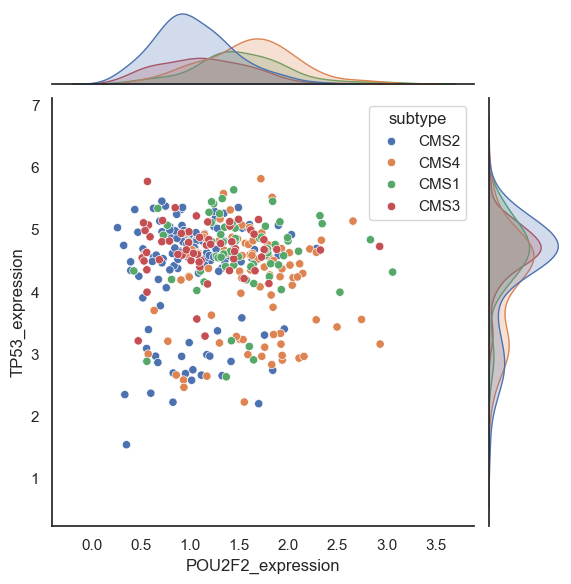

In [414]:
sns.jointplot(data=data_oi_expr, x='POU2F2_expression', y='TP53_expression', hue = 'subtype')


In [358]:
# Do the same to merge the methylation data
cms2_methyl_oi = cms2_methyl.loc[:,['POU2F2', 'TP53']]
cms2_methyl_oi.columns = ['POU2F2_methylation', 'TP53_methylation']
# same for cms4
cms4_methyl_oi = cms4_methyl.loc[:,['POU2F2', 'TP53']]
cms4_methyl_oi.columns = ['POU2F2_methylation', 'TP53_methylation']

# Do the same for cms1 and cms3
cms1_methyl_oi = cms1_methyl.loc[:,['POU2F2', 'TP53']]
cms1_methyl_oi.columns = ['POU2F2_methylation', 'TP53_methylation']
cms3_methyl_oi = cms3_methyl.loc[:,['POU2F2', 'TP53']]
cms3_methyl_oi.columns = ['POU2F2_methylation', 'TP53_methylation']

cms2_methyl_oi.index = cms2_methyl_oi.index.str[:16]
cms4_methyl_oi.index = cms4_methyl_oi.index.str[:16]
cms1_methyl_oi.index = cms1_methyl_oi.index.str[:16]
cms3_methyl_oi.index = cms3_methyl_oi.index.str[:16]

cms2_methyl_oi['subtype'] = 'CMS2'
cms4_methyl_oi['subtype'] = 'CMS4'
cms1_methyl_oi['subtype'] = 'CMS1'
cms3_methyl_oi['subtype'] = 'CMS3'

methyl_oi = pd.concat([cms2_methyl_oi, cms4_methyl_oi, cms1_methyl_oi, cms3_methyl_oi], axis=0)


<Axes: xlabel='POU2F2_methylation', ylabel='TP53_methylation'>

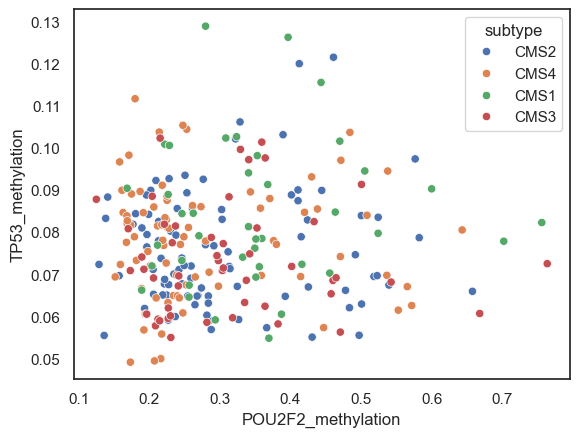

In [359]:
sns.scatterplot(data=methyl_oi.reset_index(), x='POU2F2_methylation', y = 'TP53_methylation', hue = 'subtype')


In [360]:
data_oi = data_oi.merge(methyl_oi, left_index=True, right_index=True, suffixes=('_expr', '_methyl'))


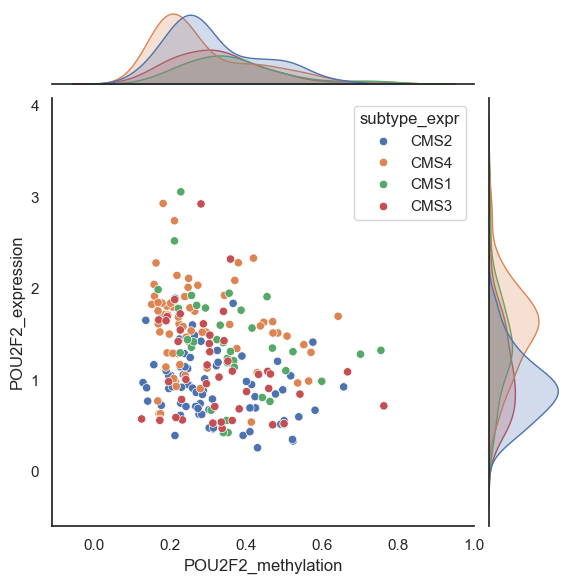

In [361]:
sns.jointplot(data=data_oi.reset_index(), x='POU2F2_methylation', y = 'POU2F2_expression', hue = 'subtype_expr')


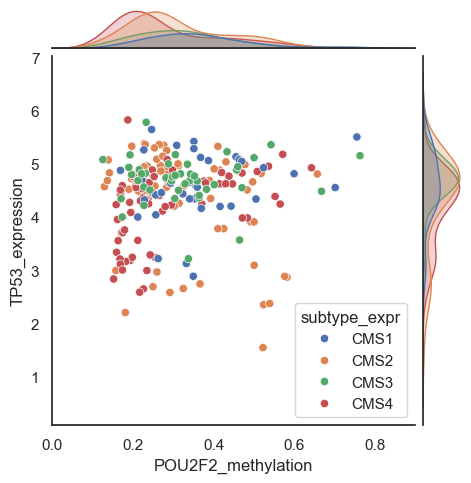

In [367]:
sns.jointplot(data=data_oi.reset_index(), x='POU2F2_methylation', y = 'TP53_expression', hue = 'subtype_expr', hue_order = ['CMS1', 'CMS2', 'CMS3', 'CMS4'], height=5, ratio=8, xlim=(0,.9))


In [208]:
data_oi

,POU2F2_expression,TP53_expression,TERT_expression,subtype_expr,POU2F2_methylation,TP53_methylation,subtype_methyl
TCGA-DM-A1DB-01A,1.048344,4.818085,0.837346,CMS2,0.518182,0.069504,CMS2
TCGA-D5-5537-01A,1.264494,4.686176,1.047821,CMS2,0.389492,0.103170,CMS2
TCGA-QG-A5YV-01A,1.052371,4.796965,2.050550,CMS2,0.202334,0.089966,CMS2
TCGA-G4-6306-01A,0.725536,4.537460,0.967422,CMS2,0.177118,0.081896,CMS2
TCGA-AA-3494-01A,0.771441,4.828325,0.071392,CMS2,0.141348,0.088365,CMS2
...,...,...,...,...,...,...,...
TCGA-A6-2685-01A,1.758779,3.115014,0.809954,CMS4,0.168504,0.083900,CMS4
TCGA-CM-6165-01A,1.186669,4.380418,0.319685,CMS4,0.358780,0.069757,CMS4
TCGA-CA-6717-01A,2.285011,4.639893,1.147805,CMS4,0.380109,0.077132,CMS4
TCGA-AZ-5403-01A,0.573717,3.005138,0.351778,CMS4,0.173804,0.081696,CMS4


In [ ]:
## Raw data

In [53]:
cms4_mutations = pd.read_csv("/Users/violafanfani/Documents/uni-harvard/projects/tcga-data-supplement/data/processed/data-coad/tcga_coad_cms4_mutations_pivot.csv", index_col=0)
cms2_mutations = pd.read_csv("/Users/violafanfani/Documents/uni-harvard/projects/tcga-data-supplement/data/processed/data-coad/tcga_coad_cms2_mutations_pivot.csv", index_col=0)

cms2_mutations

,Hugo_Symbol,TCGA-AA-A02J-01A-01W-A00E-09,TCGA-AA-3856-01A-01W-0900-09,TCGA-D5-5537-01A-21D-1924-10,TCGA-A6-A567-01A-31D-A28G-10,TCGA-CK-5912-01A-11D-1650-10,TCGA-AA-3819-01A-01W-0900-09,TCGA-AD-6890-01A-11D-1924-10,TCGA-CM-6161-01A-11D-1650-10,TCGA-CA-6715-01A-21D-1835-10,...,TCGA-D5-6537-01A-11D-1719-10,TCGA-DM-A0XF-01A-11D-A152-10,TCGA-G4-6306-01A-11D-1771-10,TCGA-AA-3534-01A-01D-1953-10,TCGA-AA-3529-01A-02D-1953-10,TCGA-AA-3524-01A-02D-1953-10,TCGA-AA-3561-01A-01D-1953-10,TCGA-AA-3531-01A-01D-1953-10,TCGA-AA-3517-01A-01D-1953-10,TCGA-AA-A00Z-01A-01D-A17O-10
Entrez_Gene_Id,,,,,,,,,,,,,,,,,,,,,
0,AC004593.2,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,AC004922.1,0,1,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,AC004947.2,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,AC005324.2,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,AC006059.2,0,0,0,0,0,1,1,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
100526842,RPL17-C18orf32,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
100529240,ZNF816-ZNF321P,0,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
100533467,BIVM-ERCC5,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


## Raw mutations

In [ ]:
cms4_mut_raw = pd.read_csv("/Users/violafanfani/Documents/uni-harvard/projects/tcga-data-supplement/data/processed/batch-coad-subtype-20250406/tcga_coad_cms4/data_download/mutations/tcga_coad_cms4_mutations.txt", sep=' ', index_col=0)
cms4_mut_raw

,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,normal_bam_uuid,case_id,GDC_FILTER,COSMIC,hotspot,RNA_Support,RNA_depth,RNA_ref_count,RNA_alt_count,callers
1,STPG1,90529,BCM,GRCh38,chr1,24383931,24383931,+,Missense_Mutation,SNP,...,59ba30dd-fd90-4874-a5e5-9c4a7ded15d7,4aadf2a2-ce1e-4f94-b146-59292e83e7fd,NaN,COSM1340993;COSM1340994,N,Unknown,NaN,NaN,NaN,muse;mutect2
2,PLPPR4,9890,BCM,GRCh38,chr1,99306239,99306239,+,Silent,SNP,...,59ba30dd-fd90-4874-a5e5-9c4a7ded15d7,4aadf2a2-ce1e-4f94-b146-59292e83e7fd,NaN,COSM1345152;COSM4698623,N,Unknown,NaN,NaN,NaN,muse;mutect2;varscan2
3,DAP3,7818,BCM,GRCh38,chr1,155737020,155737020,+,Silent,SNP,...,59ba30dd-fd90-4874-a5e5-9c4a7ded15d7,4aadf2a2-ce1e-4f94-b146-59292e83e7fd,NaN,NaN,N,Unknown,NaN,NaN,NaN,muse;mutect2;varscan2
4,VN1R5,317705,BCM,GRCh38,chr1,247257039,247257039,+,Missense_Mutation,SNP,...,59ba30dd-fd90-4874-a5e5-9c4a7ded15d7,4aadf2a2-ce1e-4f94-b146-59292e83e7fd,NaN,NaN,N,Unknown,NaN,NaN,NaN,muse;mutect2;varscan2
5,OR14I1,401994,BCM,GRCh38,chr1,248681580,248681581,+,Frame_Shift_Ins,INS,...,59ba30dd-fd90-4874-a5e5-9c4a7ded15d7,4aadf2a2-ce1e-4f94-b146-59292e83e7fd,NaN,COSM1341197,N,Unknown,NaN,NaN,NaN,mutect2;pindel;varscan2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41691,ZNF799,90576,BCM,GRCh38,chr19,12392611,12392611,+,Silent,SNP,...,c0605c93-7e67-42a1-8767-78cfa06971b7,f88c0259-58ff-4bcc-a777-7705cdbd8213,NaN,NaN,N,Unknown,NaN,NaN,NaN,muse;mutect2
41692,BPIFB4,149954,BCM,GRCh38,chr20,33089015,33089015,+,Missense_Mutation,SNP,...,c0605c93-7e67-42a1-8767-78cfa06971b7,f88c0259-58ff-4bcc-a777-7705cdbd8213,NaN,NaN,N,Unknown,NaN,NaN,NaN,muse;mutect2;varscan2
41693,ZNFX1,57169,BCM,GRCh38,chr20,49247958,49247958,+,Missense_Mutation,SNP,...,c0605c93-7e67-42a1-8767-78cfa06971b7,f88c0259-58ff-4bcc-a777-7705cdbd8213,NaN,NaN,N,Unknown,NaN,NaN,NaN,muse;mutect2
41694,CACNA1F,778,BCM,GRCh38,chrX,49211388,49211389,+,Frame_Shift_Del,DEL,...,c0605c93-7e67-42a1-8767-78cfa06971b7,f88c0259-58ff-4bcc-a777-7705cdbd8213,NaN,NaN,N,Unknown,NaN,NaN,NaN,pindel;varscan2


In [239]:
cms4_mut_raw[cms4_mut_raw['Hugo_Symbol'] == 'TP53'].sort_values(by = 'Variant_Classification', ascending=False)

,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,normal_bam_uuid,case_id,GDC_FILTER,COSMIC,hotspot,RNA_Support,RNA_depth,RNA_ref_count,RNA_alt_count,callers
41618,TP53,7157,BCM,GRCh38,chr17,7673534,7673534,+,Splice_Site,SNP,...,283c02d1-f035-4c69-91b9-1154bdc52a63,f4e047a5-bdb2-4bc2-aff0-e0f45bcc9062,NonExonic,COSM2744450;COSM323936;COSM4271709;COSM6918,Y,Unknown,NaN,NaN,NaN,muse;mutect2;varscan2
30055,TP53,7157,BCM,GRCh38,chr17,7674174,7674185,+,Splice_Site,DEL,...,fa9ba3aa-25e6-4422-bce6-c0127ec82564,c7c5348f-5708-45bf-b40e-1bf7c9348f60,NaN,NaN,N,Unknown,NaN,NaN,NaN,pindel;varscan2*
4761,TP53,7157,BCM,GRCh38,chr17,7673534,7673534,+,Splice_Site,SNP,...,aafc8a3c-f15a-4cf0-8d9f-119565d9714c,9cdca5d8-ea77-4df9-b2ba-0d5e8ec37bcd,NonExonic,COSM2744450;COSM323936;COSM4271709;COSM6918,Y,Unknown,NaN,NaN,NaN,muse;mutect2;varscan2
4515,TP53,7157,BCM,GRCh38,chr17,7675052,7675052,+,Splice_Site,SNP,...,d9b58d4d-8ad0-46e9-b24d-dcd9553ce9a7,85a57cfe-f1c9-44d9-8b50-022c0d3438d1,NonExonic,COSM131534;COSM131535;COSM131536;COSM131537;CO...,Y,Unknown,NaN,NaN,NaN,muse;mutect2;varscan2
18744,TP53,7157,BCM,GRCh38,chr17,7675993,7675993,+,Splice_Site,DEL,...,831befa3-d98a-43f4-8992-6eac06bb3a3f,20ccd267-74e5-4574-a8e1-028bcd74aaeb,NonExonic,COSM318394;COSM318395;COSM318396;COSM4603792;C...,Y,Unknown,NaN,NaN,NaN,mutect2;varscan2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2008,TP53,7157,WUGSC,GRCh38,chr17,7676072,7676075,+,Frame_Shift_Del,DEL,...,f58e0ea0-9084-494c-b29b-bc727c921575,01f493d4-229d-47a6-baa8-32a342c65d01,NaN,COSM278467;COSM278468;COSM278469,N,Unknown,NaN,NaN,NaN,mutect2;pindel;varscan2
5739,TP53,7157,BCM,GRCh38,chr17,7676398,7676398,+,Frame_Shift_Del,DEL,...,e2cb936f-9132-4e75-a1a7-fc7bb57d6f11,d655bbf6-c710-411d-aff5-ceb0fb6e6680,NaN,COSM296199;COSM296200;COSM296201;COSM4427617;C...,N,Unknown,NaN,NaN,NaN,mutect2;pindel;varscan2
16695,TP53,7157,BCM,GRCh38,chr17,7674922,7674923,+,Frame_Shift_Del,DEL,...,0dac3b4f-4de2-4f4e-8bcf-84a75b4f2b80,d259eeb2-d15e-436d-9d37-2d0b7658bc91,NaN,COSM1386715;COSM1386716;COSM1386717;COSM138671...,N,Unknown,NaN,NaN,NaN,pindel;varscan2
15311,TP53,7157,WUGSC,GRCh38,chr17,7675999,7675999,+,Frame_Shift_Del,DEL,...,4450eeba-2b67-4d19-8164-b480d8739d05,80809d79-92e1-4d6c-ba2e-0a9589997792,NaN,COSM4434421;COSM4434422;COSM4434423;COSM443442...,N,Unknown,NaN,NaN,NaN,mutect2;pindel;varscan2


In [368]:
cms2_mut_raw = pd.read_csv("/Users/violafanfani/Documents/uni-harvard/projects/tcga-data-supplement/data/processed/batch-coad-subtype-20250406/tcga_coad_cms2/data_download/mutations/tcga_coad_cms2_mutations.txt", sep=' ', index_col=0)
cms2_mut_raw

/var/folders/1b/jphhn26s4zgfr0k1rxj7wfqr0000gn/T/ipykernel_3020/1185464946.py:1: DtypeWarning: Columns (75,121) have mixed types. Specify dtype option on import or set low_memory=False.
  cms2_mut_raw = pd.read_csv("/Users/violafanfani/Documents/uni-harvard/projects/tcga-data-supplement/data/processed/batch-coad-subtype-20250406/tcga_coad_cms2/data_download/mutations/tcga_coad_cms2_mutations.txt", sep=' ', index_col=0)


,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,normal_bam_uuid,case_id,GDC_FILTER,COSMIC,hotspot,RNA_Support,RNA_depth,RNA_ref_count,RNA_alt_count,callers
1,CTRC,11330,BCM,GRCh38,chr1,15440345,15440345,+,Missense_Mutation,SNP,...,c5da08d3-a654-4ab7-9cd3-71f8d462bece,3aae5316-6a5d-4b83-9020-ad691d4edf99,NaN,COSM4651980,N,Unknown,NaN,NaN,NaN,muse;mutect2;varscan2
2,SSBP3,23648,BCM,GRCh38,chr1,54240908,54240908,+,Missense_Mutation,SNP,...,c5da08d3-a654-4ab7-9cd3-71f8d462bece,3aae5316-6a5d-4b83-9020-ad691d4edf99,NaN,COSM1227627;COSM1227628,N,Unknown,NaN,NaN,NaN,muse;mutect2;varscan2
3,RPE65,6121,BCM,GRCh38,chr1,68440995,68440995,+,Silent,SNP,...,c5da08d3-a654-4ab7-9cd3-71f8d462bece,3aae5316-6a5d-4b83-9020-ad691d4edf99,NaN,COSM1344093,N,Unknown,NaN,NaN,NaN,muse;mutect2;varscan2
4,DENND2C,163259,BCM,GRCh38,chr1,114625430,114625430,+,Silent,SNP,...,c5da08d3-a654-4ab7-9cd3-71f8d462bece,3aae5316-6a5d-4b83-9020-ad691d4edf99,NaN,COSM4218156;COSM894207,N,Unknown,NaN,NaN,NaN,muse;mutect2;varscan2
5,KPRP,448834,BCM,GRCh38,chr1,152760748,152760748,+,Missense_Mutation,SNP,...,c5da08d3-a654-4ab7-9cd3-71f8d462bece,3aae5316-6a5d-4b83-9020-ad691d4edf99,NaN,COSM1334226,N,Unknown,NaN,NaN,NaN,muse;mutect2;varscan2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13022,PHACTR3,116154,BCM,GRCh38,chr20,59767325,59767325,+,Missense_Mutation,SNP,...,ab5b51cd-f90e-4696-adce-c3799cd250e4,eb4e4e09-98b3-4e85-8dd2-75676ff2af14,NaN,NaN,N,Unknown,NaN,NaN,NaN,muse;mutect2;varscan2
13023,COL20A1,57642,BCM,GRCh38,chr20,63319533,63319533,+,Silent,SNP,...,ab5b51cd-f90e-4696-adce-c3799cd250e4,eb4e4e09-98b3-4e85-8dd2-75676ff2af14,NaN,COSM1413070;COSM5088044;COSM5088045,N,Unknown,NaN,NaN,NaN,muse;mutect2;varscan2
13024,SERPIND1,3053,BCM,GRCh38,chr22,20786029,20786029,+,Missense_Mutation,SNP,...,ab5b51cd-f90e-4696-adce-c3799cd250e4,eb4e4e09-98b3-4e85-8dd2-75676ff2af14,NaN,COSM1415017;COSM1415018,N,Unknown,NaN,NaN,NaN,muse;mutect2;varscan2
13025,DCX,1641,BCM,GRCh38,chrX,111410155,111410155,+,Missense_Mutation,SNP,...,ab5b51cd-f90e-4696-adce-c3799cd250e4,eb4e4e09-98b3-4e85-8dd2-75676ff2af14,NaN,COSM1113200;COSM1464917,N,Unknown,NaN,NaN,NaN,muse;mutect2;varscan2


## Check the mutations is TP53

In [59]:
#cms2_mutations.set_index('Hugo_Symbol', inplace=True)
#cms2_mutations = cms2_mutations.T
cms4_mutations.set_index('Hugo_Symbol', inplace=True)
cms4_mutations = cms4_mutations.T

In [63]:
#cms2_mutations.set_index('Hugo_Symbol', inplace=True)
#cms2_mutations = cms2_mutations.T
cms2_mutations['TP53'].sum()/len(cms2_mutations)

np.float64(0.6837606837606838)

In [62]:
cms4_mutations['TP53'].sum()/len(cms4_mutations)

np.float64(0.6842105263157895)

In [82]:
cms4_mutations

Hugo_Symbol,AC004593.2,AC004922.1,AC005324.2,AC005833.1,AC005863.1,AC006059.2,AC007952.2,AC008397.2,AC008676.3,AC009779.3,...,CSAG2,CT45A10,GAGE10,ZNF511-PRAP1,LRRC53,GET1-SH3BGR,EEF1AKMT4,EEF1AKMT4-ECE2,SLCO1B3-SLCO1B7,DUS4L-BCAP29
TCGA-A6-6781-01A-22D-1924-10,1,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0
TCGA-A6-6781-01A-22D-A270-10,1,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0
TCGA-AA-A00N-01A-02D-A17O-10,0,1,0,0,0,0,1,0,0,0,...,0,1,0,0,1,1,0,2,1,1
TCGA-AA-A00N-01A-02W-A00E-09,0,1,0,0,0,0,0,0,0,0,...,0,1,0,0,0,2,0,2,1,1
TCGA-AD-6964-01A-11D-1924-10,0,1,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TCGA-CM-5860-01A-01D-1650-10,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
TCGA-F4-6463-01A-11D-1719-10,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
TCGA-F4-6569-01A-11D-1771-10,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
TCGA-AA-3520-01A-01D-1953-10,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
cms2_mutations.loc[:,['TP53','POU2F2']]
cms4_mutations.loc[:,['TP53']]

Hugo_Symbol,TP53,POU2F2
TCGA-AA-A02J-01A-01W-A00E-09,1,0
TCGA-AA-3856-01A-01W-0900-09,1,0
TCGA-D5-5537-01A-21D-1924-10,0,0
TCGA-A6-A567-01A-31D-A28G-10,1,0
TCGA-CK-5912-01A-11D-1650-10,0,0
...,...,...
TCGA-AA-3524-01A-02D-1953-10,0,0
TCGA-AA-3561-01A-01D-1953-10,0,0
TCGA-AA-3531-01A-01D-1953-10,0,0
TCGA-AA-3517-01A-01D-1953-10,0,0


## Check the expression

In [3]:
cms2_expression = pd.read_csv("/Users/violafanfani/Documents/uni-harvard/projects/tcga-data-supplement/data/processed/data-coad/recount3_tcga_coad_cms2_purity03_normlogcpm_mintpm1_fracsamples02_tissuetumor_batchtcgagdcplatform_adjtcgagdcplatform.txt", index_col=0, sep = '\t')
# remove everything after dot in the index
cms2_expression.index = cms2_expression.index.str.split('.').str[0]
cms2_expression

,TCGA-AA-A01F-01A-01R-A002-07,TCGA-DM-A1DB-01A-11R-A155-07,TCGA-D5-5537-01A-21R-1928-07,TCGA-AA-3534-01A-01R-0821-07,TCGA-QG-A5YV-01A-11R-A28H-07,TCGA-AA-3989-01A-01R-1022-07,TCGA-G4-6306-01A-11R-1774-07,TCGA-AA-3494-01A-01R-1410-07,TCGA-AA-3856-01A-01R-0905-07,TCGA-CK-5912-01A-11R-1653-07,...,TCGA-AA-3678-01A-01R-0905-07,TCGA-AD-6965-01A-11R-1928-07,TCGA-A6-5659-01A-01R-A278-07,TCGA-AA-A02K-01A-03R-A32Y-07,TCGA-G4-6303-01A-11R-1774-07,TCGA-AA-A00W-01A-01R-A002-07,TCGA-F4-6854-01A-11R-1928-07,TCGA-CM-6170-01A-11R-1653-07,TCGA-AA-3561-01A-01R-0821-07,TCGA-G4-6295-01A-11R-1723-07
ENSG00000227232,2.336229,2.532302,2.441256,1.749152,2.358873,2.498946,2.524410,2.039316,2.136885,1.874978,...,2.021171,2.084954,1.680465,2.306683,2.057609,2.358896,2.244985,2.217470,1.902655,1.965568
ENSG00000268903,0.214425,0.238731,1.285633,0.462788,0.786056,1.283538,0.168056,0.642398,0.148626,0.326755,...,0.308897,0.022500,0.001439,0.237205,0.663118,0.739441,0.145014,0.791302,0.188761,0.096444
ENSG00000269981,0.335363,0.398688,0.991067,0.340074,0.565015,0.475664,0.191584,0.545912,0.244196,0.399060,...,0.279747,0.174547,-0.154009,0.251376,0.583783,0.501390,0.163334,0.574748,0.266965,0.311121
ENSG00000279457,2.563773,2.882126,3.024708,2.219584,2.641230,2.727518,3.094868,2.847748,2.487952,2.324706,...,2.377270,2.477627,1.941658,2.834605,2.381365,2.544785,2.603624,2.462024,2.257935,2.184514
ENSG00000241670,0.548475,0.371431,0.582887,0.352266,0.535851,0.487002,0.508914,0.897418,0.528684,0.685586,...,0.574058,0.730157,0.364904,0.707019,0.659834,0.568583,0.465446,0.501376,0.873925,0.647229
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ENSG00000229129,-0.333072,0.820343,0.910839,-0.137524,0.930019,2.261289,0.798911,1.865841,0.999309,0.820879,...,-0.337666,0.926537,1.232746,0.949676,1.032042,1.795490,0.812768,0.937787,1.509915,0.819362
ENSG00000185275,3.606817,2.422881,3.407615,4.018438,3.950900,4.251813,2.964308,3.275023,3.415019,4.453918,...,3.476297,2.785143,2.913974,4.107576,4.714477,4.066859,3.855417,4.501117,4.738925,3.018819
ENSG00000131002,3.614711,0.722595,3.609815,-0.028622,0.028622,3.339898,3.534767,3.855545,3.257452,3.164011,...,0.068728,0.817471,3.368900,4.169778,0.069744,0.493245,0.028622,0.028622,3.977129,0.049750
ENSG00000012817,3.421369,1.219109,3.314866,-0.016672,0.033107,3.201938,3.529543,3.153028,3.160435,2.859030,...,0.010086,1.630307,2.979013,3.991714,0.016672,1.079472,0.029985,0.016672,2.728002,0.037800


In [4]:
cms4_expression = pd.read_csv("/Users/violafanfani/Documents/uni-harvard/projects/tcga-data-supplement/data/processed/data-coad/recount3_tcga_coad_cms4_purity03_normlogcpm_mintpm1_fracsamples02_tissuetumor_batchtcgagdcplatform_adjtcgagdcplatform.txt", index_col=0, sep = '\t')
# remove everything after dot in the index
cms4_expression.index = cms4_expression.index.str.split('.').str[0]

Text(0, 0.5, 'POU2F2')

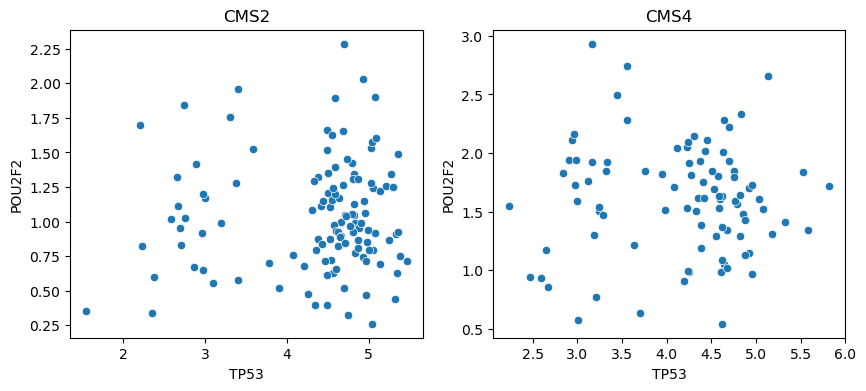

In [12]:
pou2f2_ens = 'ENSG00000028277'
tert_ens = 'ENSG00000164362'
tp53_ens = 'ENSG00000141510'
cms2_expression.loc[[tp53_ens,pou2f2_ens], :]
# scatter plot pou2f2 vs tert
f, ax = plt.subplots(1,2,figsize=(10, 4))
sns.scatterplot(data=cms2_expression.loc[[pou2f2_ens,tp53_ens], :].T, x=tp53_ens, y=pou2f2_ens, ax = ax[0])
sns.scatterplot(data=cms4_expression.loc[[pou2f2_ens,tp53_ens], :].T, x=tp53_ens, y=pou2f2_ens, ax = ax[1])
ax[0].set_title('CMS2')
ax[1].set_title('CMS4')
ax[0].set_xlabel('TP53')
ax[0].set_ylabel('POU2F2')
ax[1].set_xlabel('TP53')
ax[1].set_ylabel('POU2F2')

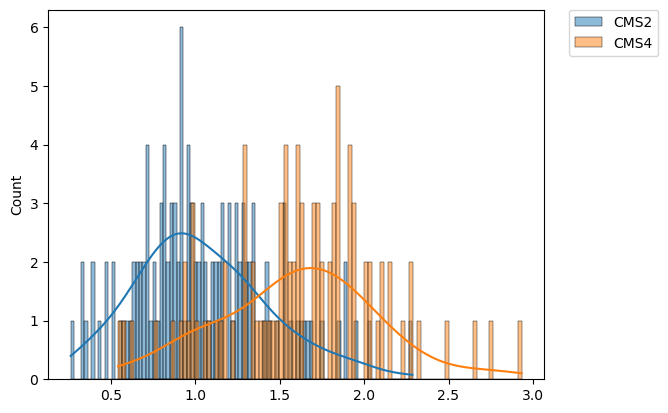

In [15]:
sns.histplot(cms2_expression.loc[pou2f2_ens, :].T.values, bins=100, kde=True, label = 'CMS2')
sns.histplot(cms4_expression.loc[pou2f2_ens, :].T.values, bins=100, kde=True, label = 'CMS4')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

<Axes: ylabel='Count'>

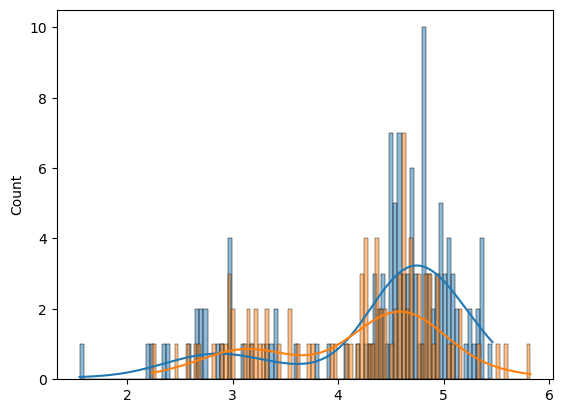

In [16]:
sns.histplot(cms2_expression.loc[tp53_ens, :].T.values, bins=100, kde=True)
sns.histplot(cms4_expression.loc[tp53_ens, :].T.values, bins=100, kde=True)

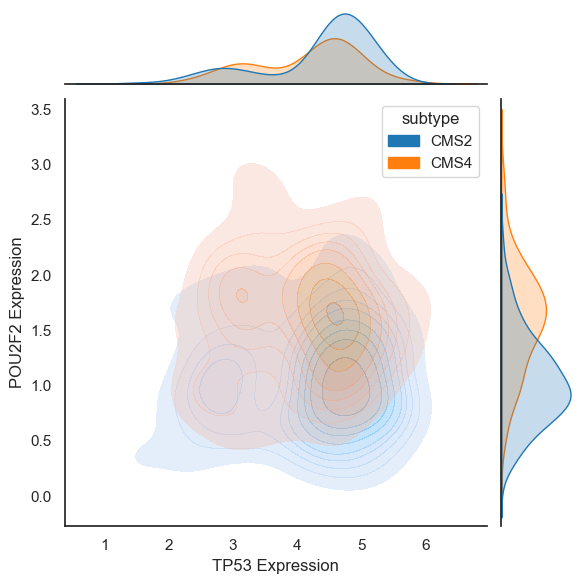

In [22]:
# Create a dataframe with the expression for tp53 and pou2f2 for both cms2 and cms4, with a column that is "subtype"
# such tat I can plot the distributions with marginals on the sides
cms2_tp53 = cms2_expression.loc[tp53_ens, :].T
cms2_pou2f2 = cms2_expression.loc[pou2f2_ens, :].T
cms4_tp53 = cms4_expression.loc[tp53_ens, :].T
cms4_pou2f2 = cms4_expression.loc[pou2f2_ens, :].T
cms2_df = pd.DataFrame({'TP53': cms2_tp53, 'POU2F2': cms2_pou2f2, 'subtype': 'CMS2'})
cms4_df = pd.DataFrame({'TP53': cms4_tp53, 'POU2F2': cms4_pou2f2, 'subtype': 'CMS4'})
cms_df = pd.concat([cms2_df, cms4_df], axis=0)
# plot the distributions with marginals on the sides
import seaborn as sns
import matplotlib.pyplot as plt

sns.set(style="white", font_scale=1)
g = sns.jointplot(data=cms_df, x='TP53', y='POU2F2', hue='subtype', kind='kde', fill=True, palette=['#1f77b4', '#ff7f0e'], height=6, alpha = .3)
g.ax_joint.set_xlabel('TP53 Expression')
g.ax_joint.set_ylabel('POU2F2 Expression')
#g.ax_joint.set_title('TP53 vs POU2F2 Expression in CMS2 and CMS4 Subtypes')
#g.ax_joint.legend(title='Subtype', loc='upper right')
plt.show()

## Raw methylation data

In [184]:
raw_data_cms2 = "/Users/violafanfani/Documents/uni-harvard/projects/tcga-coad-subtype/results/batch-coad-subtype-20250406/tcga_coad_cms2/analysis/dragon/tcga_coad_cms2_methylation_expression_dragon_input.tsv"

raw_data_cms4 = "/Users/violafanfani/Documents/uni-harvard/projects/tcga-coad-subtype/results/batch-coad-subtype-20250406/tcga_coad_cms4/analysis/dragon/tcga_coad_cms4_methylation_expression_dragon_input.tsv"

In [183]:
raw_data_cms2

'/Users/violafanfani/Documents/uni-harvard/projects/tcga-coad-subtype/results/batch-coad-subtype-20250406/tcga_coad_cms2/analysis/dragon/tcga_coad_cms2_methylation_expression_dragon_input.tsv'

In [185]:
data_cms2 = pd.read_csv(raw_data_cms2, sep='\t', index_col=0)
data_csm4 = pd.read_csv(raw_data_cms4, sep='\t', index_col=0)


In [198]:
data_cms2.shape

(68, 1410)

<Axes: xlabel='TP53_expression', ylabel='POU2F2_expression'>

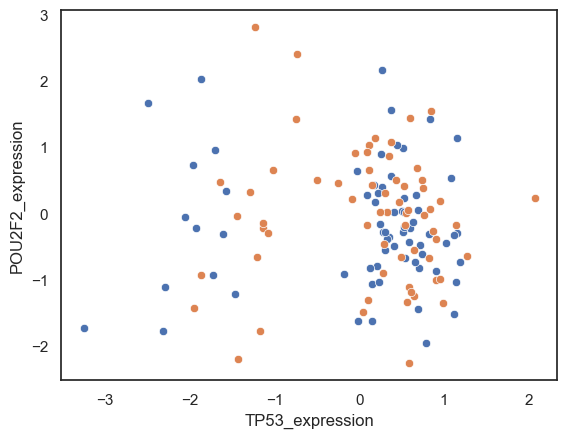

In [29]:
sns.scatterplot(data=data_cms2, x='TP53_expression', y='POU2F2_expression')
sns.scatterplot(data=data_csm4, x='TP53_expression', y='POU2F2_expression')


<Axes: xlabel='TP53_methylation', ylabel='TP53_expression'>

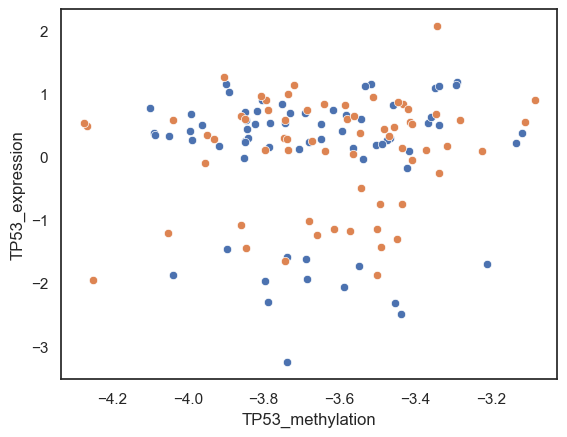

In [66]:
sns.scatterplot(data=data_cms2, x='TP53_methylation', y='TP53_expression')
sns.scatterplot(data=data_csm4, x='TP53_methylation', y='TP53_expression')

#sns.scatterplot(data=data_csm4, x='POU2F2_methylation', y='POU2F2_expression')

<Axes: xlabel='POU2F2_methylation', ylabel='POU2F2_expression'>

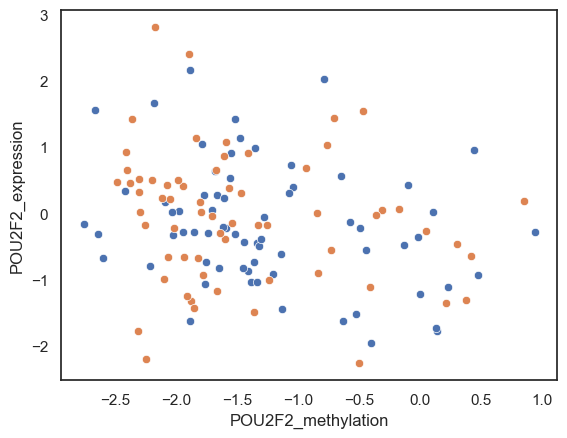

In [68]:
sns.scatterplot(data=data_cms2, x='POU2F2_methylation', y='POU2F2_expression')
sns.scatterplot(data=data_csm4, x='POU2F2_methylation', y='POU2F2_expression')

Text(0, 0.5, 'POU2F2 Expression')

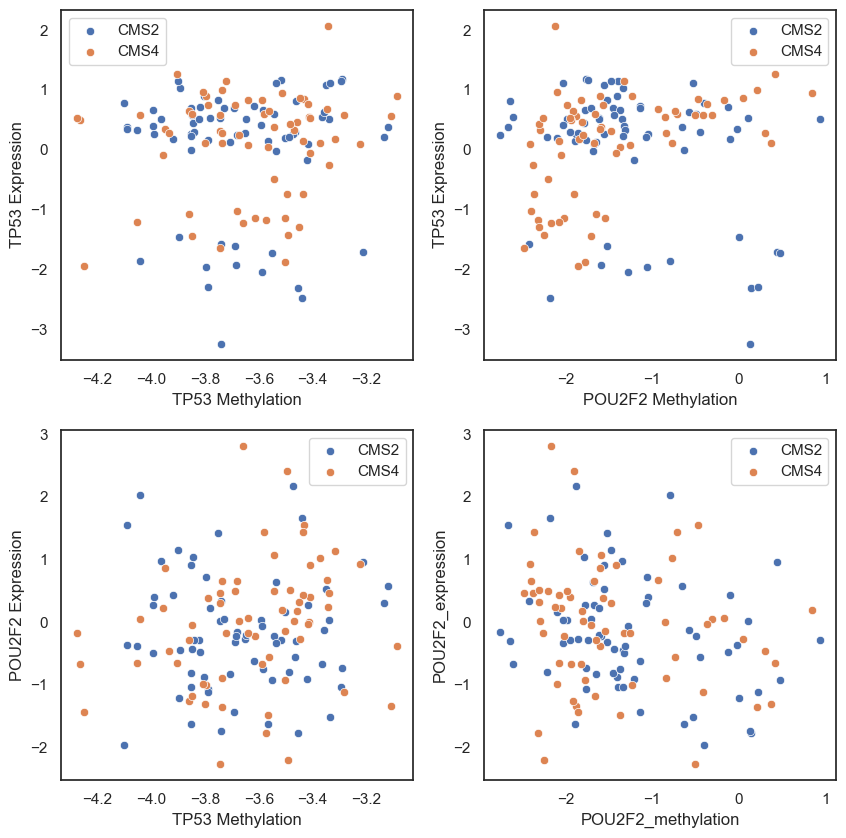

In [ ]:
f, ax = plt.subplots(2,2,figsize=(10, 10))
# TP53-TP53 for ax[0,0]
sns.scatterplot(data=data_cms2, x='TP53_methylation', y='TP53_expression', ax = ax[0,0], label = 'CMS2')
sns.scatterplot(data=data_csm4, x='TP53_methylation', y='TP53_expression', ax = ax[0,0], label = 'CMS4')
ax[0,0].set_xlabel('TP53 Methylation')
ax[0,0].set_ylabel('TP53 Expression') 
# POU2F2-POU2F2 for ax[1,1]
sns.scatterplot(data=data_cms2, x='POU2F2_methylation', y='POU2F2_expression', ax = ax[1,1], label = 'CMS2')
sns.scatterplot(data=data_csm4, x='POU2F2_methylation', y='POU2F2_expression', ax = ax[1,1], label = 'CMS4')
# POu2F2-TP53 for ax[0,1]
sns.scatterplot(data=data_cms2, x='POU2F2_methylation', y='TP53_expression', ax = ax[0,1], label = 'CMS2')
sns.scatterplot(data=data_csm4, x='POU2F2_methylation', y='TP53_expression', ax = ax[0,1], label = 'CMS4')
ax[0,1].set_xlabel('POU2F2 Methylation')
ax[0,1].set_ylabel('TP53 Expression')
# TP53-POU2F2 for ax[1,0]
sns.scatterplot(data=data_cms2, x='TP53_methylation', y='POU2F2_expression', ax = ax[1,0], label = 'CMS2')
sns.scatterplot(data=data_csm4, x='TP53_methylation', y='POU2F2_expression', ax = ax[1,0], label = 'CMS4')
ax[1,0].set_xlabel('TP53 Methylation')
ax[1,0].set_ylabel('POU2F2 Expression')

In [244]:
data_csm4['interesting'] = data_csm4['TP53_expression'] < 0

In [247]:
data_csm4[data_csm4.interesting]

,AC023509.3_methylation,AC092835.1_methylation,AC138696.1_methylation,AEBP1_methylation,AEBP2_methylation,AHDC1_methylation,AIRE_methylation,AKAP8_methylation,AKAP8L_methylation,AKNA_methylation,...,ZNF853_expression,ZNF860_expression,ZNF865_expression,ZNF880_expression,ZSCAN16_expression,ZSCAN22_expression,ZSCAN9_expression,ZXDB_expression,ZXDC_expression,interesting
TCGAbarcode,,,,,,,,,,,,,,,,,,,,,
TCGA-F4-6704-01A,-4.381330,-5.486815,-6.125768,-3.021600,-3.188647,-5.158936,-0.701902,-2.769876,-3.820312,1.732494,...,0.094067,-2.103338,0.616593,1.214853,-0.017394,0.539117,-0.860105,1.553578,2.643286,True
TCGA-A6-2675-01A,-4.662245,-5.738806,-6.265348,-1.586183,-3.113515,-5.353022,-1.285869,-2.659846,-3.854338,1.250734,...,-0.344773,-0.549711,-0.370744,-0.561439,0.923140,0.697552,0.465961,0.297807,0.323564,True
TCGA-D5-6541-01A,-4.167653,-5.635649,-6.472009,-0.219712,-2.962937,-5.232144,-1.309044,-2.803624,-3.867857,1.358257,...,-1.285549,0.010531,-0.108551,-0.812903,1.010559,0.748743,-0.087889,-0.718393,0.250871,True
TCGA-A6-2671-01A,-5.235491,-5.666094,-6.210993,0.841773,-2.354051,-5.249277,-1.394563,-2.748112,-3.875496,2.531511,...,1.518025,0.840979,1.125782,-1.044683,-0.495493,1.074220,0.342956,0.087250,1.251278,True
TCGA-AZ-6607-01A,-4.419995,-4.951489,-6.209383,-0.055470,-2.060769,-5.368738,-0.473064,-2.770063,-3.742858,1.804733,...,0.123490,2.858446,0.262902,0.384127,-1.685851,0.594465,-0.371171,1.625585,-0.785101,True
TCGA-CM-6679-01A,-4.932419,-5.519819,-6.138518,-1.659717,-2.626645,-5.218695,-0.422269,-2.730467,-3.829517,1.694521,...,1.409547,-0.029164,0.687990,0.709101,1.160229,0.413706,0.559870,1.388087,0.659408,True
TCGA-AZ-5403-01A,-4.878117,-5.632562,-6.260804,-2.164842,-3.249200,-5.131842,-0.374524,-2.709803,-3.692643,1.423596,...,0.033055,-0.262149,-1.534994,2.253369,1.199815,-0.857028,-0.206323,-0.346350,-1.320325,True
TCGA-CA-6719-01A,-4.111914,-5.711230,-5.974573,1.060136,-2.317662,-5.299265,-0.020565,-2.689224,-4.017665,2.175563,...,-0.757605,-1.043545,-0.045981,-0.066614,0.958872,0.408734,1.579991,1.036950,0.710305,True
TCGA-CM-6167-01A,-4.090677,-5.489997,-6.372532,-1.801699,-2.767835,-5.324448,-0.549267,-2.723365,-3.874465,1.311464,...,0.957259,0.288912,-0.158391,-0.504509,-0.847594,-0.164220,-0.356944,-0.278677,-1.237429,True


Text(0, 0.5, 'POU2F2 Expression')

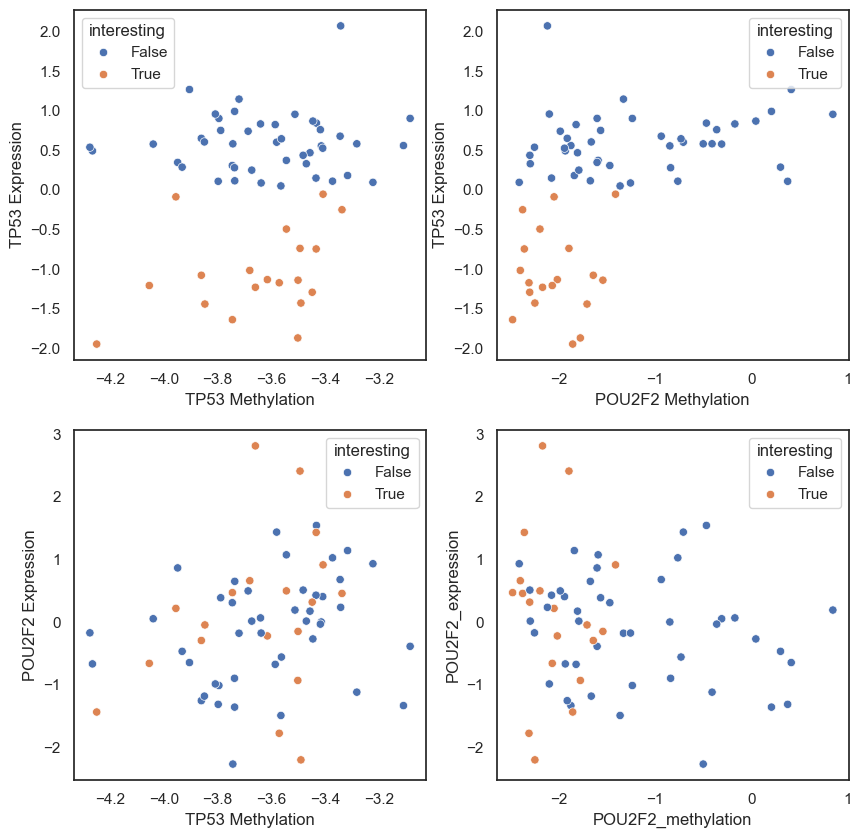

In [110]:
f, ax = plt.subplots(2,2,figsize=(10, 10))
# TP53-TP53 for ax[0,0]\
sns.scatterplot(data=data_csm4, x='TP53_methylation', y='TP53_expression', ax = ax[0,0], hue = 'interesting')
ax[0,0].set_xlabel('TP53 Methylation')
ax[0,0].set_ylabel('TP53 Expression') 
# POU2F2-POU2F2 for ax[1,1]
sns.scatterplot(data=data_csm4, x='POU2F2_methylation', y='POU2F2_expression', ax = ax[1,1], hue = 'interesting')
# POu2F2-TP53 for ax[0,1]
sns.scatterplot(data=data_csm4, x='POU2F2_methylation', y='TP53_expression', ax = ax[0,1], hue = 'interesting')
ax[0,1].set_xlabel('POU2F2 Methylation')
ax[0,1].set_ylabel('TP53 Expression')
# TP53-POU2F2 for ax[1,0]
sns.scatterplot(data=data_csm4, x='TP53_methylation', y='POU2F2_expression', ax = ax[1,0], hue = 'interesting')
ax[1,0].set_xlabel('TP53 Methylation')
ax[1,0].set_ylabel('POU2F2 Expression')

In [270]:
def plot_quadrant_data(data1, data2, name1 = 'cms2', name2 = 'cms4', g1 = 'POU2F2', g2 = 'TP53'):
    g1_expr = f'{g1}_expression'
    g2_expr = f'{g2}_expression'
    g1_methyl = f'{g1}_methylation'
    g2_methyl = f'{g2}_methylation'
    
    f, ax = plt.subplots(2,2,figsize=(10, 10))
    # TP53-TP53 for ax[0,0]
    sns.scatterplot(data=data1, x=g1_methyl, y=g1_expr, ax = ax[0,0], label = name1)
    sns.scatterplot(data=data2, x=g1_methyl, y=g1_expr, ax = ax[0,0], label = name2)
    ax[0,0].set_xlabel(f'{g1} Methylation')
    ax[0,0].set_ylabel(f'{g1} Expression') 
    # POU2F2-POU2F2 for ax[1,1]
    sns.scatterplot(data=data1, x=g2_methyl, y=g2_expr, ax = ax[1,1], label = name1)
    sns.scatterplot(data=data2, x=g2_methyl, y=g2_expr, ax = ax[1,1], label = name2)
    ax[0,0].set_xlabel(f'{g2} Methylation')
    ax[0,0].set_ylabel(f'{g2} Expression') 
    # POu2F2-TP53 for ax[0,1]
    sns.scatterplot(data=data1, x=g2_methyl, y=g1_expr, ax = ax[0,1], label = name1)
    sns.scatterplot(data=data2, x=g2_methyl, y=g1_expr, ax = ax[0,1], label = name2)
    ax[0,1].set_xlabel(f'{g2} Methylation')
    ax[0,1].set_ylabel(f'{g1} Expression')
    # TP53-POU2F2 for ax[1,0]
    sns.scatterplot(data=data1, x=g1_methyl, y=g2_expr, ax = ax[1,0], label = name1)
    sns.scatterplot(data=data2, x=g1_methyl, y=g2_expr, ax = ax[1,0], label = name2)
    ax[1,0].set_xlabel(f'{g1} Methylation')
    ax[1,0].set_ylabel(f'{g2} Expression')

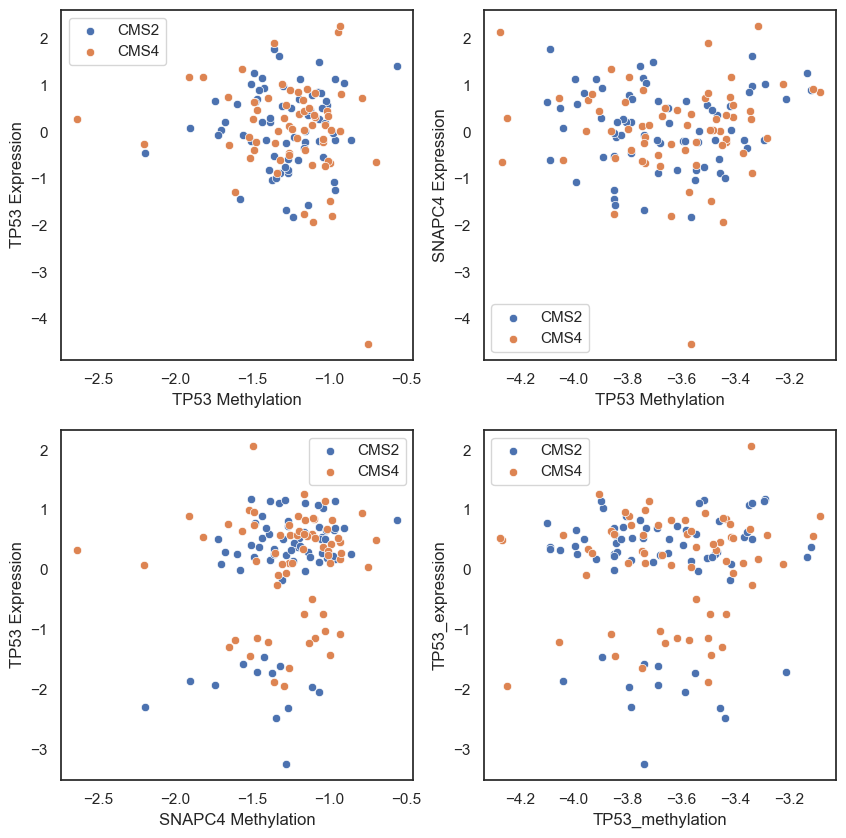

In [272]:
plot_quadrant_data(data_cms2, data_csm4, name1 = 'CMS2', name2 = 'CMS4', g1 = 'SNAPC4', g2 = 'TP53')

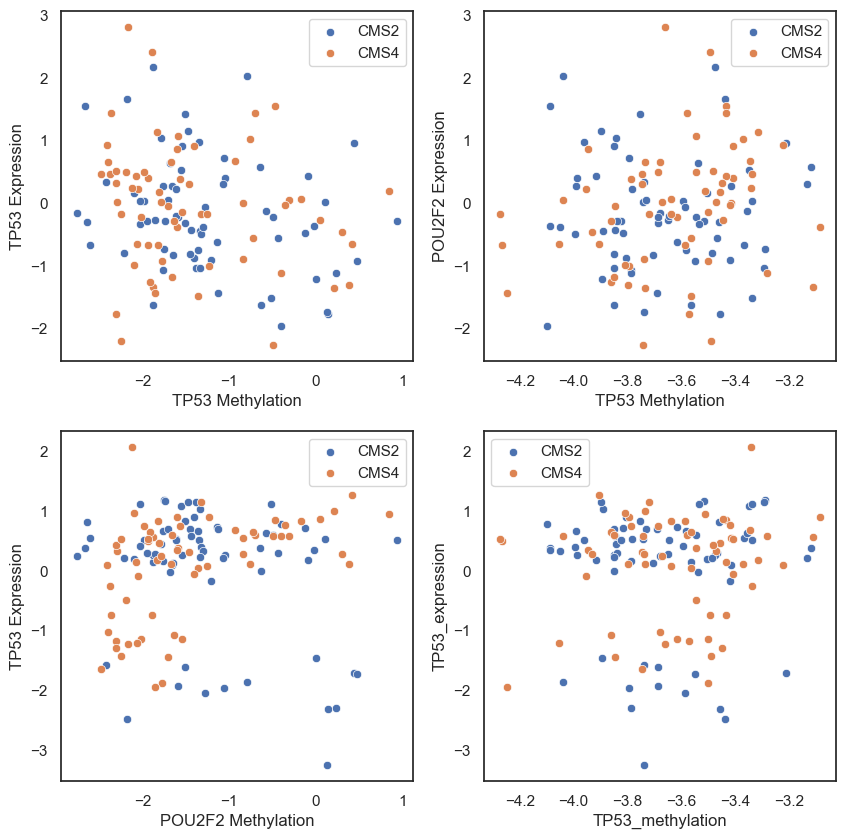

In [273]:
plot_quadrant_data(data_cms2, data_csm4, name1 = 'CMS2', name2 = 'CMS4', g1 = 'POU2F2', g2 = 'TP53')

<Axes: xlabel='POU2F2_methylation', ylabel='TP53_expression'>

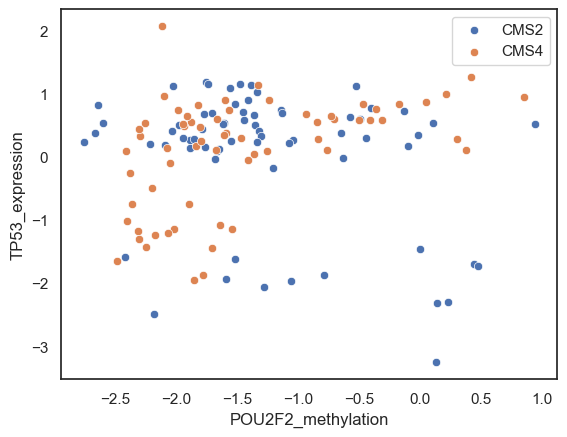

In [75]:
sns.scatterplot(data=data_cms2, x='POU2F2_methylation', y='TP53_expression', label = 'CMS2')
sns.scatterplot(data=data_csm4, x='POU2F2_methylation', y='TP53_expression', label = 'CMS4')

In [84]:
data_cms2

,AC023509.3_methylation,AC092835.1_methylation,AC138696.1_methylation,AEBP1_methylation,AEBP2_methylation,AHDC1_methylation,AIRE_methylation,AKAP8_methylation,AKAP8L_methylation,AKNA_methylation,...,ZNF84_expression,ZNF853_expression,ZNF860_expression,ZNF865_expression,ZNF880_expression,ZSCAN16_expression,ZSCAN22_expression,ZSCAN9_expression,ZXDB_expression,ZXDC_expression
TCGAbarcode,,,,,,,,,,,,,,,,,,,,,
TCGA-G4-6626-01A,-4.970173,-5.612756,-6.337138,-3.229618,-2.986055,-4.787337,-1.448966,-2.699762,-3.708088,1.878484,...,-1.448174,0.392137,-0.210345,1.107989,-0.760811,1.301388,0.547075,0.837663,-0.275672,1.479207
TCGA-A6-A567-01A,-4.471308,-5.417304,-6.015523,-3.598115,-2.611852,-5.249022,-0.360448,-2.697763,-3.825216,1.999613,...,-0.007124,0.524667,2.310655,-0.042525,0.323035,0.536641,-0.444584,0.630659,-0.380156,1.277751
TCGA-CA-6715-01A,-4.055340,-5.766921,-6.163975,-3.705882,-2.652211,-5.229484,-1.229714,-2.728254,-3.947307,2.173892,...,-0.008522,0.835158,1.476563,-0.138843,1.486986,0.231247,0.583249,-0.845975,0.695341,0.174861
TCGA-CK-5915-01A,-4.689190,-5.476764,-6.030267,2.034599,-2.651329,-5.317829,-3.492276,-2.794904,-3.948743,2.307265,...,0.728321,-0.478363,0.347655,0.272613,-1.693632,-0.111595,1.550114,0.665216,0.968182,0.833723
TCGA-A6-5666-01A,-4.344626,-4.652622,-5.192942,-0.765345,-3.801382,-4.388269,-2.893028,-2.586765,-3.793654,2.048462,...,0.230384,-1.118809,-0.276059,-1.084710,0.893165,0.483398,-0.257287,-1.312111,1.725757,-0.682291
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TCGA-D5-6537-01A,-4.460827,-5.952559,-6.382792,-0.071106,-2.893766,-5.651856,-1.531464,-2.795673,-3.849786,2.334264,...,0.201673,1.821902,0.488927,0.794464,-1.130264,0.038740,2.318666,0.236186,0.014303,-1.043533
TCGA-D5-6532-01A,-3.816736,-5.661597,-6.454736,-0.161943,-2.650681,-5.513553,-1.242457,-2.870386,-3.994516,2.211927,...,-0.425111,-0.397968,0.063758,0.064281,-1.116680,-0.811495,0.770919,-1.216274,1.582340,0.770035
TCGA-D5-5537-01A,-4.048515,-5.222745,-5.687094,0.996205,-1.948841,-4.882795,-0.673935,-2.750114,-3.788972,2.282258,...,0.722336,-0.381830,1.636186,-0.706635,-0.450628,-0.955860,-1.421642,0.031481,0.540036,-0.232758


In [91]:
cms2_mutations['sample'] = cms2_mutations.index.str[:16]
cms4_mutations['sample'] = cms4_mutations.index.str[:16]
cms2_mutations['sample']

TCGA-AA-A02J-01A-01W-A00E-09    TCGA-AA-A02J-01A
TCGA-AA-3856-01A-01W-0900-09    TCGA-AA-3856-01A
TCGA-D5-5537-01A-21D-1924-10    TCGA-D5-5537-01A
TCGA-A6-A567-01A-31D-A28G-10    TCGA-A6-A567-01A
TCGA-CK-5912-01A-11D-1650-10    TCGA-CK-5912-01A
                                      ...       
TCGA-AA-3524-01A-02D-1953-10    TCGA-AA-3524-01A
TCGA-AA-3561-01A-01D-1953-10    TCGA-AA-3561-01A
TCGA-AA-3531-01A-01D-1953-10    TCGA-AA-3531-01A
TCGA-AA-3517-01A-01D-1953-10    TCGA-AA-3517-01A
TCGA-AA-A00Z-01A-01D-A17O-10    TCGA-AA-A00Z-01A
Name: sample, Length: 117, dtype: object

In [90]:
data_cms2_oi = data_cms2.loc[:, ['TP53_methylation', 'POU2F2_methylation', 'TP53_expression', 'POU2F2_expression']]
cms2_mutations_oi = cms2_mutations.loc[:, ['sample', 'TP53', 'POU2F2']]
data_cms2_oi = data_cms2_oi.merge(cms2_mutations_oi, left_index=True, right_on='sample', how='left')
data_cms2_oi    


,TP53_methylation,POU2F2_methylation,TP53_expression,POU2F2_expression,sample,TP53,POU2F2
TCGA-G4-6626-01A-11D-1771-10,-3.752220,-1.515657,0.839547,1.427403,TCGA-G4-6626-01A,1.0,0.0
TCGA-A6-A567-01A-31D-A28G-10,-3.416384,-1.665047,0.090758,0.272230,TCGA-A6-A567-01A,1.0,0.0
TCGA-CA-6715-01A-21D-1835-10,-3.786533,-1.762942,0.154945,-1.068097,TCGA-CA-6715-01A,1.0,0.0
TCGA-CK-5915-01A-11D-1650-10,-3.804854,-1.406212,0.904330,-0.878086,TCGA-CK-5915-01A,0.0,0.0
TCGA-A6-5666-01A-01D-1650-10,-3.851348,-0.629311,-0.012661,-1.623048,TCGA-A6-5666-01A,0.0,0.0
...,...,...,...,...,...,...,...
TCGA-D5-6537-01A-11D-1719-10,-3.647995,-1.613648,0.521977,-0.209717,TCGA-D5-6537-01A,0.0,0.0
TCGA-D5-6532-01A-11D-1719-10,-3.839979,-1.944341,0.300128,-0.280562,TCGA-D5-6532-01A,1.0,0.0
TCGA-D5-5537-01A-21D-1924-10,-3.119806,-0.648419,0.378178,0.568798,TCGA-D5-5537-01A,0.0,0.0
TCGA-DM-A282-01A-12D-A16V-10,-3.849493,-1.336122,0.231389,-1.042596,TCGA-DM-A282-01A,0.0,0.0


In [96]:
data_cms4_oi = data_csm4.loc[:, ['TP53_methylation', 'POU2F2_methylation', 'TP53_expression', 'POU2F2_expression']]
cms4_mutations_oi = cms4_mutations.loc[:, ['sample', 'TP53']]
data_cms4_oi = data_cms4_oi.merge(cms4_mutations_oi, left_index=True, right_on='sample', how='left')
data_cms4_oi    

,TP53_methylation,POU2F2_methylation,TP53_expression,POU2F2_expression,sample,TP53
TCGA-CA-6717-01A-11D-1835-10,-3.580726,-0.705600,0.601537,1.435284,TCGA-CA-6717-01A,0
TCGA-CM-5868-01A-01D-1650-10,-3.743319,-0.498771,0.580941,-2.266134,TCGA-CM-5868-01A,1
TCGA-A6-4107-01A-02D-1408-10,-3.640589,-0.169591,0.832210,0.066185,TCGA-A6-4107-01A,0
TCGA-A6-A566-01A-11D-A28G-10,-3.373314,-0.762779,0.109362,1.025152,TCGA-A6-A566-01A,0
TCGA-F4-6704-01A-11D-1835-10,-3.615165,-2.016006,-1.133817,-0.221470,TCGA-F4-6704-01A,0
...,...,...,...,...,...,...
TCGA-D5-6924-01A-11D-1924-10,-3.408482,-1.410668,-0.054868,0.912497,TCGA-D5-6924-01A,1
TCGA-A6-6142-01A-11D-1771-10,-3.686655,-1.985161,0.740353,0.496951,TCGA-A6-6142-01A,2
TCGA-A6-2685-01A-01D-1408-10,-3.448763,-2.302930,-1.293115,0.317610,TCGA-A6-2685-01A,1
TCGA-F4-6805-01A-11D-1835-10,-3.673184,-1.792081,0.248883,0.014908,TCGA-F4-6805-01A,1


<Axes: xlabel='POU2F2_methylation', ylabel='TP53_expression'>

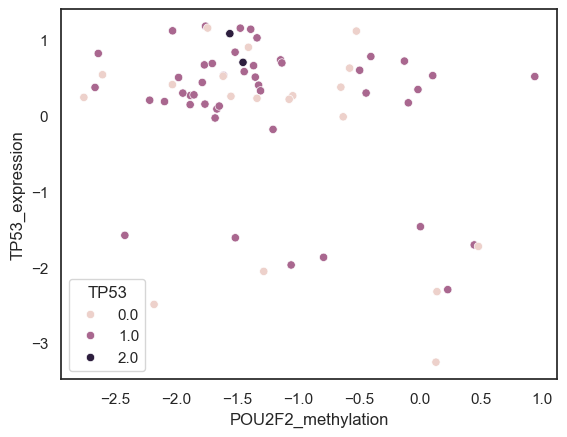

In [98]:
sns.scatterplot(data=data_cms2_oi, x='POU2F2_methylation', y='TP53_expression', hue = 'TP53')
#sns.scatterplot(data=data_csm4, x='POU2F2_methylation', y='TP53_expression', label = 'CMS4')

In [302]:
data_cms4_oi

,TP53_methylation,POU2F2_methylation,TP53_expression,POU2F2_expression,sample,TP53
TCGA-CA-6717-01A-11D-1835-10,-3.580726,-0.705600,0.601537,1.435284,TCGA-CA-6717-01A,0
TCGA-CM-5868-01A-01D-1650-10,-3.743319,-0.498771,0.580941,-2.266134,TCGA-CM-5868-01A,1
TCGA-A6-4107-01A-02D-1408-10,-3.640589,-0.169591,0.832210,0.066185,TCGA-A6-4107-01A,0
TCGA-A6-A566-01A-11D-A28G-10,-3.373314,-0.762779,0.109362,1.025152,TCGA-A6-A566-01A,0
TCGA-F4-6704-01A-11D-1835-10,-3.615165,-2.016006,-1.133817,-0.221470,TCGA-F4-6704-01A,0
...,...,...,...,...,...,...
TCGA-D5-6924-01A-11D-1924-10,-3.408482,-1.410668,-0.054868,0.912497,TCGA-D5-6924-01A,1
TCGA-A6-6142-01A-11D-1771-10,-3.686655,-1.985161,0.740353,0.496951,TCGA-A6-6142-01A,2
TCGA-A6-2685-01A-01D-1408-10,-3.448763,-2.302930,-1.293115,0.317610,TCGA-A6-2685-01A,1
TCGA-F4-6805-01A-11D-1835-10,-3.673184,-1.792081,0.248883,0.014908,TCGA-F4-6805-01A,1


<Axes: xlabel='POU2F2_methylation', ylabel='TP53_expression'>

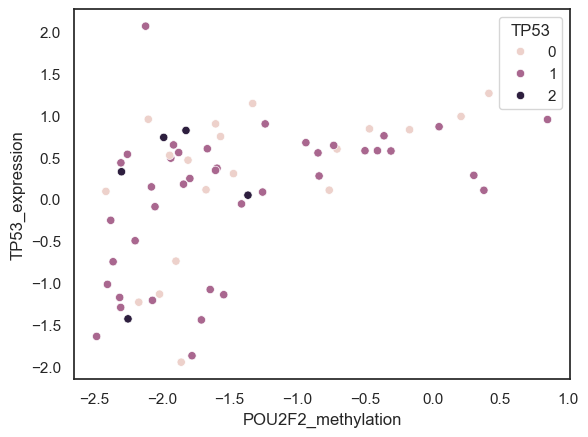

In [99]:
sns.scatterplot(data=data_cms4_oi, x='POU2F2_methylation', y='TP53_expression', hue = 'TP53')

In [280]:
data_csm4

,AC023509.3_methylation,AC092835.1_methylation,AC138696.1_methylation,AEBP1_methylation,AEBP2_methylation,AHDC1_methylation,AIRE_methylation,AKAP8_methylation,AKAP8L_methylation,AKNA_methylation,...,ZNF853_expression,ZNF860_expression,ZNF865_expression,ZNF880_expression,ZSCAN16_expression,ZSCAN22_expression,ZSCAN9_expression,ZXDB_expression,ZXDC_expression,interesting
TCGAbarcode,,,,,,,,,,,,,,,,,,,,,
TCGA-CA-6717-01A,-4.949929,-5.448789,-6.181580,-0.321795,-2.310449,-4.950083,0.461473,-2.704708,-3.618511,1.368418,...,-0.170632,0.482995,0.381727,-0.425493,-0.067724,0.196778,-0.052870,-0.829916,0.346598,False
TCGA-CM-5868-01A,-4.741851,-5.791462,-6.156482,-0.788508,-3.398321,-5.280101,-0.998431,-2.741247,-3.820727,1.792112,...,0.479414,0.615547,0.525655,1.510477,1.268562,-0.199001,-0.122363,-0.551516,0.118601,False
TCGA-A6-4107-01A,-5.369660,-5.691472,-6.247491,0.960895,-2.219144,-5.366077,-0.313719,-2.832121,-3.782670,2.289490,...,-0.586960,-1.107854,-0.299650,-0.730249,1.423941,0.030976,0.572522,-0.098553,-1.563255,False
TCGA-A6-A566-01A,-4.011744,-0.575245,-6.133610,0.114651,-1.703178,-5.251787,-0.153638,-2.748063,-3.752276,1.464036,...,-0.971752,-1.014003,-0.953295,-0.501893,-1.473254,-0.680344,-0.566303,-1.833558,-0.347293,False
TCGA-F4-6704-01A,-4.381330,-5.486815,-6.125768,-3.021600,-3.188647,-5.158936,-0.701902,-2.769876,-3.820312,1.732494,...,0.094067,-2.103338,0.616593,1.214853,-0.017394,0.539117,-0.860105,1.553578,2.643286,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TCGA-D5-6924-01A,-4.077486,-5.412759,-5.845444,-0.210874,-1.963618,-5.031765,-0.281104,-2.703163,-3.796625,1.931651,...,1.408069,0.498282,-0.514297,-0.943745,-0.508100,-0.382752,-0.045324,0.702306,0.948822,True
TCGA-A6-6142-01A,-4.802446,-5.583965,-6.240920,-2.389885,-2.802781,-5.274716,-0.608970,-2.710969,-3.791887,0.798350,...,1.762579,-0.088627,1.107191,-0.008971,-0.721933,-1.465212,-0.173585,-0.921157,1.571176,False
TCGA-A6-2685-01A,-3.919872,-5.565090,-6.019933,-3.474583,-2.730607,-4.988718,-0.510428,-2.699760,-3.696513,1.530737,...,-0.062040,-0.354022,-0.562150,0.886010,-1.066034,-1.763756,-1.680252,-0.820261,0.133387,True


In [370]:

# get the barcodes
cms2_mut_raw['patient'] = cms2_mut_raw['Tumor_Sample_Barcode'].str[:16]
cms2_mut_dragon = cms2_mut_raw.merge(data_cms2.loc[:,['TP53_expression','TP53_methylation', 'POU2F2_expression', 'POU2F2_methylation']], left_on='patient', right_index=True, how='inner')#[['Hugo_Symbol', 'Variant_Classification', 'TP53_expression', 'TP53_methylation', 'POU2F2_expression', 'POU2F2_methylation']]
cms2_mut_dragon

,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,RNA_Support,RNA_depth,RNA_ref_count,RNA_alt_count,callers,patient,TP53_expression,TP53_methylation,POU2F2_expression,POU2F2_methylation
1,CTRC,11330,BCM,GRCh38,chr1,15440345,15440345,+,Missense_Mutation,SNP,...,Unknown,NaN,NaN,NaN,muse;mutect2;varscan2,TCGA-G4-6626-01A,0.839547,-3.752220,1.427403,-1.515657
2,SSBP3,23648,BCM,GRCh38,chr1,54240908,54240908,+,Missense_Mutation,SNP,...,Unknown,NaN,NaN,NaN,muse;mutect2;varscan2,TCGA-G4-6626-01A,0.839547,-3.752220,1.427403,-1.515657
3,RPE65,6121,BCM,GRCh38,chr1,68440995,68440995,+,Silent,SNP,...,Unknown,NaN,NaN,NaN,muse;mutect2;varscan2,TCGA-G4-6626-01A,0.839547,-3.752220,1.427403,-1.515657
4,DENND2C,163259,BCM,GRCh38,chr1,114625430,114625430,+,Silent,SNP,...,Unknown,NaN,NaN,NaN,muse;mutect2;varscan2,TCGA-G4-6626-01A,0.839547,-3.752220,1.427403,-1.515657
5,KPRP,448834,BCM,GRCh38,chr1,152760748,152760748,+,Missense_Mutation,SNP,...,Unknown,NaN,NaN,NaN,muse;mutect2;varscan2,TCGA-G4-6626-01A,0.839547,-3.752220,1.427403,-1.515657
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12800,TCF20,6942,BCM,GRCh38,chr22,42213580,42213580,+,Missense_Mutation,SNP,...,Unknown,NaN,NaN,NaN,muse;mutect2;varscan2,TCGA-AD-A5EK-01A,0.129068,-3.706954,-0.822469,-1.645588
12801,CLCN5,1184,BCM,GRCh38,chrX,50090800,50090800,+,Silent,SNP,...,Unknown,NaN,NaN,NaN,muse;mutect2;varscan2,TCGA-AD-A5EK-01A,0.129068,-3.706954,-0.822469,-1.645588
12802,SMC1A,8243,BCM,GRCh38,chrX,53405359,53405359,+,Silent,SNP,...,Unknown,NaN,NaN,NaN,muse;mutect2;varscan2,TCGA-AD-A5EK-01A,0.129068,-3.706954,-0.822469,-1.645588
12803,IL1RAPL2,26280,BCM,GRCh38,chrX,105767061,105767061,+,Silent,SNP,...,Unknown,NaN,NaN,NaN,muse;mutect2;varscan2,TCGA-AD-A5EK-01A,0.129068,-3.706954,-0.822469,-1.645588


In [308]:
#cms4_mut_raw[cms4_mut_raw['Hugo_Symbol'] == 'TP53']
# get the barcodes
cms4_mut_raw['patient'] = cms4_mut_raw['Tumor_Sample_Barcode'].str[:16]
cms4_mut_dragon = cms4_mut_raw.merge(data_csm4.loc[:,['TP53_expression','TP53_methylation', 'POU2F2_expression', 'POU2F2_methylation']], left_on='patient', right_index=True, how='inner')#[['Hugo_Symbol', 'Variant_Classification', 'TP53_expression', 'TP53_methylation', 'POU2F2_expression', 'POU2F2_methylation']]
cms4_mut_dragon

,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_Position,End_Position,Strand,Variant_Classification,Variant_Type,...,RNA_Support,RNA_depth,RNA_ref_count,RNA_alt_count,callers,patient,TP53_expression,TP53_methylation,POU2F2_expression,POU2F2_methylation
1,STPG1,90529,BCM,GRCh38,chr1,24383931,24383931,+,Missense_Mutation,SNP,...,Unknown,NaN,NaN,NaN,muse;mutect2,TCGA-CM-5868-01A,0.580941,-3.743319,-2.266134,-0.498771
2,PLPPR4,9890,BCM,GRCh38,chr1,99306239,99306239,+,Silent,SNP,...,Unknown,NaN,NaN,NaN,muse;mutect2;varscan2,TCGA-CM-5868-01A,0.580941,-3.743319,-2.266134,-0.498771
3,DAP3,7818,BCM,GRCh38,chr1,155737020,155737020,+,Silent,SNP,...,Unknown,NaN,NaN,NaN,muse;mutect2;varscan2,TCGA-CM-5868-01A,0.580941,-3.743319,-2.266134,-0.498771
4,VN1R5,317705,BCM,GRCh38,chr1,247257039,247257039,+,Missense_Mutation,SNP,...,Unknown,NaN,NaN,NaN,muse;mutect2;varscan2,TCGA-CM-5868-01A,0.580941,-3.743319,-2.266134,-0.498771
5,OR14I1,401994,BCM,GRCh38,chr1,248681580,248681581,+,Frame_Shift_Ins,INS,...,Unknown,NaN,NaN,NaN,mutect2;pindel;varscan2,TCGA-CM-5868-01A,0.580941,-3.743319,-2.266134,-0.498771
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41691,ZNF799,90576,BCM,GRCh38,chr19,12392611,12392611,+,Silent,SNP,...,Unknown,NaN,NaN,NaN,muse;mutect2,TCGA-A6-5664-01A,0.525763,-3.409689,0.405643,-1.941134
41692,BPIFB4,149954,BCM,GRCh38,chr20,33089015,33089015,+,Missense_Mutation,SNP,...,Unknown,NaN,NaN,NaN,muse;mutect2;varscan2,TCGA-A6-5664-01A,0.525763,-3.409689,0.405643,-1.941134
41693,ZNFX1,57169,BCM,GRCh38,chr20,49247958,49247958,+,Missense_Mutation,SNP,...,Unknown,NaN,NaN,NaN,muse;mutect2,TCGA-A6-5664-01A,0.525763,-3.409689,0.405643,-1.941134
41694,CACNA1F,778,BCM,GRCh38,chrX,49211388,49211389,+,Frame_Shift_Del,DEL,...,Unknown,NaN,NaN,NaN,pindel;varscan2,TCGA-A6-5664-01A,0.525763,-3.409689,0.405643,-1.941134


<Axes: xlabel='POU2F2_methylation', ylabel='TP53_expression'>

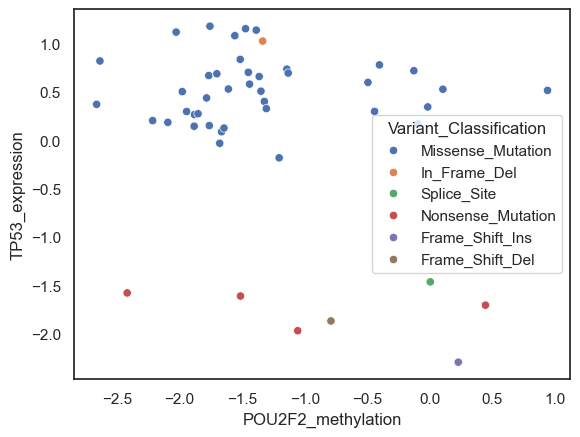

In [371]:
sns.scatterplot(data = (cms2_mut_dragon[cms2_mut_dragon['Hugo_Symbol'] == 'TP53']), x='POU2F2_methylation', y='TP53_expression', hue = 'Variant_Classification')

<Axes: xlabel='POU2F2_methylation', ylabel='TP53_expression'>

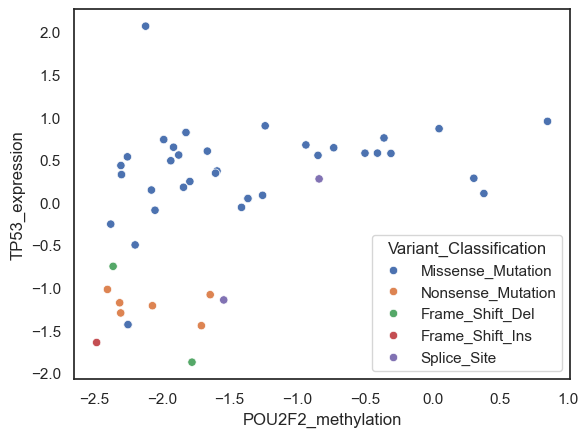

In [305]:
sns.scatterplot(data = (cms4_mut_dragon[cms4_mut_dragon['Hugo_Symbol'] == 'TP53']), x='POU2F2_methylation', y='TP53_expression', hue = 'Variant_Classification')

In [304]:
cms4_mut_dragon[cms4_mut_dragon['Hugo_Symbol'] == 'TP53']

,Hugo_Symbol,Variant_Classification,TP53_expression,TP53_methylation,POU2F2_expression,POU2F2_methylation
75,TP53,Missense_Mutation,0.580941,-3.743319,-2.266134,-0.498771
904,TP53,Missense_Mutation,0.555209,-3.415016,0.001110,-0.845817
1927,TP53,Missense_Mutation,0.901835,-3.795120,-1.012346,-1.235877
2107,TP53,Nonsense_Mutation,-1.078648,-3.860310,-0.294202,-1.641892
2222,TP53,Missense_Mutation,0.559132,-3.110039,-1.333190,-1.874668
2310,TP53,Missense_Mutation,0.581445,-3.283179,-1.118650,-0.406754
2457,TP53,Missense_Mutation,0.954037,-3.512818,0.191469,0.849300
2568,TP53,Missense_Mutation,-0.088400,-3.954748,0.218080,-2.049559
2677,TP53,Missense_Mutation,0.329542,-3.470603,0.015390,-2.297177
2678,TP53,Missense_Mutation,0.329542,-3.470603,0.015390,-2.297177


In [73]:
stats.spearmanr(data_cms2['TP53_methylation'], data_cms2['TP53_expression']),\
stats.spearmanr(data_csm4['TP53_methylation'], data_csm4['TP53_expression']),\
stats.spearmanr(data_cms2['POU2F2_methylation'], data_cms2['POU2F2_expression']),\
stats.spearmanr(data_csm4['POU2F2_methylation'], data_csm4['POU2F2_expression'])

(SignificanceResult(statistic=np.float64(0.014619994655876626), pvalue=np.float64(0.9058056343491389)),
 SignificanceResult(statistic=np.float64(0.05274725274725274), pvalue=np.float64(0.6789110507097769)),
 SignificanceResult(statistic=np.float64(-0.28705576974462726), pvalue=np.float64(0.017624106824274507)),
 SignificanceResult(statistic=np.float64(-0.2202838827838828), pvalue=np.float64(0.08027484906396119)))

sns.scatte

In [2]:
# Set output folder
output_folder = '../results/cms-post/'
# Check if folder exists
if os.path.exists(output_folder):
    print('Folder exists')
else:
    os.mkdir(output_folder)

Folder exists


In [32]:
# dictionary of file names for all dragons of interest
# This needs you to have downloaded the data from the storage

dragon_fn  = {'cms1':'../../tcga-coad-subtype/results/batch-coad-subtype-20240510/tcga_coad_cms1/analysis/dragon/tcga_coad_cms1_dragon_mat.tsv',
             'cms2': '../../tcga-coad-subtype/results/batch-coad-subtype-20240510/tcga_coad_cms2/analysis/dragon/tcga_coad_cms2_dragon_mat.tsv',
             'cms3': '../../tcga-coad-subtype/results/batch-coad-subtype-20240510/tcga_coad_cms3/analysis/dragon/tcga_coad_cms3_dragon_mat.tsv',
             'cms4': '../../tcga-coad-subtype/results/batch-coad-subtype-20240510/tcga_coad_cms4/analysis/dragon/tcga_coad_cms4_dragon_mat.tsv'}

In [33]:
# Read the dragons with the function from utils.py
dragons = read_dragons(dragon_fn)

cms1
cms2
cms3
cms4


In [34]:
dragons['cms2'].loc[:, ['POU2F2_methylation', 'POU2F2_expression']].sort_values(by = 'POU2F2_methylation', ascending=True)

,POU2F2_methylation,POU2F2_expression
SNAPC4_methylation,-0.029514,-0.000685
MSGN1_methylation,-0.026269,-0.002233
TP53_expression,-0.024709,-0.001940
KAT7_methylation,-0.024373,0.005832
ZKSCAN8_methylation,-0.023209,0.004281
...,...,...
HHEX_methylation,0.024136,-0.000998
NFAT5_methylation,0.024281,0.006595
NFATC4_methylation,0.025690,-0.001476
GLIS3_methylation,0.037797,0.000286


In [24]:
dragons['cms4'].loc[:, ['POU2F2_methylation', 'POU2F2_expression']].sort_values(by = 'POU2F2_methylation', ascending=False)

,POU2F2_methylation,POU2F2_expression
SP5_methylation,0.023711,0.004037
PROX2_methylation,0.022506,0.002530
TFAP2D_methylation,0.022188,-0.002295
NFATC4_methylation,0.022105,-0.004231
TP53_expression,0.021735,0.000343
...,...,...
MTERF1_methylation,-0.016488,0.001322
EGR3_expression,-0.016531,0.000306
TMF1_methylation,-0.016613,-0.002473
NFATC4_expression,-0.016756,0.003033


In [207]:
dragons['cms4'].loc[:, ['TP53_expression']].sort_values(by = 'TP53_expression', ascending=False)

,TP53_expression
POU2F2_methylation,0.021735
EVX2_methylation,0.020583
PROX2_methylation,0.017224
LBX1_methylation,0.017084
HMGN3_methylation,0.016876
...,...
RXRG_methylation,-0.015268
HOXC5_methylation,-0.015368
JUND_methylation,-0.015490
PAX5_methylation,-0.016832


In [218]:
dragons['cms2'].loc[:, ['TP53_expression']].sort_values(by = 'TP53_expression', ascending=False)

,TP53_expression
SNAPC4_methylation,0.024152
ZNF385B_methylation,0.021238
YY2_methylation,0.018189
ZNF304_methylation,0.017559
MITF_methylation,0.016090
...,...
LBX2_methylation,-0.016809
KLF11_methylation,-0.017006
ZNF414_methylation,-0.017483
NFATC2_methylation,-0.018198


In [462]:
dragons['cms4'].loc[:, ['NFKB1_expression']].sort_values(by = 'NFKB1_expression', ascending=True)

,NFKB1_expression
SOX30_methylation,-0.017691
PRDM14_methylation,-0.017468
ZNF280D_methylation,-0.015837
ZNF140_methylation,-0.015230
CUX2_methylation,-0.013712
...,...
POU5F2_methylation,0.013370
MLXIP_methylation,0.013376
TFDP1_expression,0.014601
FAM170A_methylation,0.014870


In [217]:
dragons['cms4'].loc[:, ['TP53_expression']].sort_values(by = 'TP53_expression', ascending=False)

,TP53_expression
POU2F2_methylation,0.021735
EVX2_methylation,0.020583
PROX2_methylation,0.017224
LBX1_methylation,0.017084
HMGN3_methylation,0.016876
...,...
RXRG_methylation,-0.015268
HOXC5_methylation,-0.015368
JUND_methylation,-0.015490
PAX5_methylation,-0.016832


In [225]:
# merge dragon cms2 and cms4 for columns TP53_expression, TP53_methylation, POU2F2_expression, POU2F2_methylation
cms2_oi = dragons['cms2'].loc[:, ['TP53_expression', 'TP53_methylation', 'POU2F2_expression', 'POU2F2_methylation']]
cms4_oi = dragons['cms4'].loc[:, ['TP53_expression', 'TP53_methylation', 'POU2F2_expression', 'POU2F2_methylation']]
cms2_oi.columns = ['TP53_expression_cms2', 'TP53_methylation_cms2', 'POU2F2_expression_cms2', 'POU2F2_methylation_cms2']
cms4_oi.columns = ['TP53_expression_cms4', 'TP53_methylation_cms4', 'POU2F2_expression_cms4', 'POU2F2_methylation_cms4']
cmsoi = cms2_oi.merge(cms4_oi, left_index=True, right_index=True, how='outer')

In [236]:
cmsoi.sort_values(by = 'TP53_expression_cms2', ascending=False)

,TP53_expression_cms2,TP53_methylation_cms2,POU2F2_expression_cms2,POU2F2_methylation_cms2,TP53_expression_cms4,TP53_methylation_cms4,POU2F2_expression_cms4,POU2F2_methylation_cms4
SNAPC4_methylation,0.024152,0.004521,-0.000685,-0.029514,0.004656,-0.003508,-0.000393,0.000758
ZNF385B_methylation,0.021238,0.007683,0.000160,-0.003138,0.007008,0.001674,-0.002109,-0.005682
YY2_methylation,0.018189,0.003579,0.009717,-0.013682,0.000546,-0.003232,0.006131,0.000096
ZNF304_methylation,0.017559,-0.005767,-0.002991,-0.007956,0.004829,0.003808,0.008126,-0.004525
MITF_methylation,0.016090,0.015175,-0.001684,-0.000975,0.008105,0.005130,0.003775,-0.001857
...,...,...,...,...,...,...,...,...
ZIC5_expression,NaN,NaN,NaN,NaN,-0.004817,0.000035,0.004208,0.005580
ZNF382_expression,NaN,NaN,NaN,NaN,0.003357,-0.000672,0.002181,0.002590
ZNF385D_expression,NaN,NaN,NaN,NaN,-0.003119,-0.001807,0.000800,-0.004207
ZNF540_expression,NaN,NaN,NaN,NaN,0.001398,-0.000948,0.002746,0.005932


In [415]:
cmsoi.sort_values(by = 'POU2F2_expression_cms2', ascending=False)

,TP53_expression_cms2,TP53_methylation_cms2,POU2F2_expression_cms2,POU2F2_methylation_cms2,TP53_expression_cms4,TP53_methylation_cms4,POU2F2_expression_cms4,POU2F2_methylation_cms4
PAX5_expression,-0.000283,0.003057,0.013471,0.000432,0.001312,-0.002346,0.005405,0.004013
SPI1_expression,0.005309,0.003057,0.011744,-0.007944,-0.006787,0.002583,0.004583,0.000871
ZNF830_methylation,0.006818,0.002658,0.011628,-0.016537,-0.011262,0.001938,-0.005229,-0.002955
BHLHA9_methylation,-0.002042,-0.000876,0.011448,0.000171,-0.002210,-0.005869,0.003361,0.004860
HOXA3_methylation,-0.000696,0.009010,0.011071,-0.004292,0.007950,-0.005864,0.005502,0.010951
...,...,...,...,...,...,...,...,...
ZIC5_expression,NaN,NaN,NaN,NaN,-0.004817,0.000035,0.004208,0.005580
ZNF382_expression,NaN,NaN,NaN,NaN,0.003357,-0.000672,0.002181,0.002590
ZNF385D_expression,NaN,NaN,NaN,NaN,-0.003119,-0.001807,0.000800,-0.004207
ZNF540_expression,NaN,NaN,NaN,NaN,0.001398,-0.000948,0.002746,0.005932


<Axes: xlabel='POU2F2_expression_cms2', ylabel='TP53_expression_cms2'>

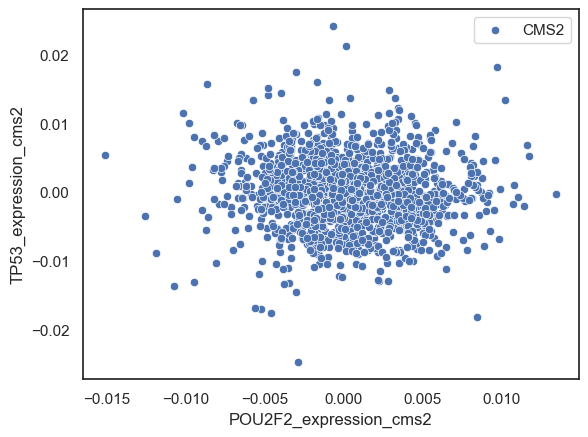

In [422]:

sns.scatterplot(data=cmsoi, x='POU2F2_expression_cms2', y='TP53_expression_cms2', label = 'CMS2')
#sns.scatterplot(data=cmsoi, x='POU2F2_expression_cms4', y='TP53_expression_cms4', label = 'CMS4')

<Axes: xlabel='POU2F2_expression_cms2', ylabel='TP53_expression_cms2'>

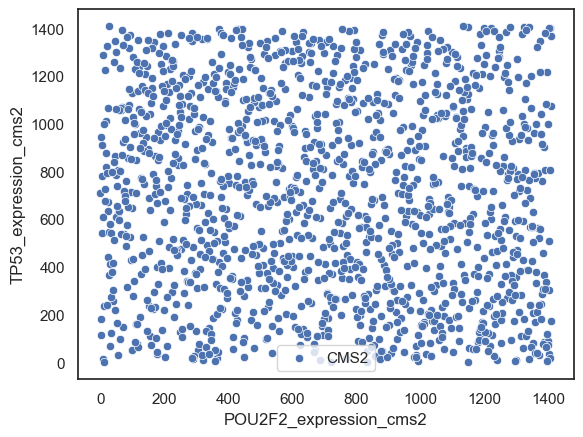

In [ ]:
cmsoi_ranks = cmsoi.copy()
# rank the values in each column
for col in cmsoi_ranks.columns:
    cmsoi_ranks[col] = cmsoi_ranks[col].rank(ascending=False)

In [435]:
cmsoi_expression = cmsoi[cmsoi.index.str.contains('expression')]
cmsoi_expression_ranks = cmsoi_expression.copy()
# rank the values in each column
for col in cmsoi_expression_ranks.columns:
    cmsoi_expression_ranks[col] = cmsoi_expression_ranks[col].rank(ascending=False)

In [436]:
cmsoi_expression[(cmsoi_expression_ranks['TP53_expression_cms2']<100) & (cmsoi_ranks['POU2F2_expression_cms2']<100)]

/var/folders/1b/jphhn26s4zgfr0k1rxj7wfqr0000gn/T/ipykernel_3020/831534721.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  cmsoi_expression[(cmsoi_expression_ranks['TP53_expression_cms2']<100) & (cmsoi_ranks['POU2F2_expression_cms2']<100)]


,TP53_expression_cms2,TP53_methylation_cms2,POU2F2_expression_cms2,POU2F2_methylation_cms2,TP53_expression_cms4,TP53_methylation_cms4,POU2F2_expression_cms4,POU2F2_methylation_cms4
MBD4_expression,0.004019,0.002400,0.008178,0.008973,-0.006467,-0.002684,0.002268,-0.004401
RXRB_expression,0.003611,-0.000939,0.008044,-0.004024,-0.002406,-0.000969,0.003445,0.000013
SPI1_expression,0.005309,0.003057,0.011744,-0.007944,-0.006787,0.002583,0.004583,0.000871
STAT1_expression,0.004879,-0.005034,0.007637,-0.008327,-0.001279,-0.005661,0.002954,0.001109


<Axes: xlabel='POU2F2_expression_cms2', ylabel='TP53_expression_cms2'>

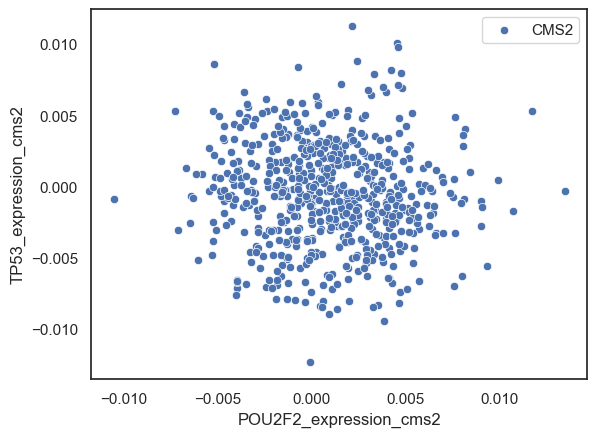

In [455]:
sns.scatterplot(data=cmsoi_expression, x='POU2F2_expression_cms2', y='TP53_expression_cms2', label = 'CMS2')
#sns.scatterplot(data=cmsoi_expression, x='POU2F2_expression_cms4', y='TP53_expression_cms4', label = 'CMS4')

In [451]:
cmsoi_expression[cmsoi_expression['TP53_expression_cms2'].abs()>0.005]

,TP53_expression_cms2,TP53_methylation_cms2,POU2F2_expression_cms2,POU2F2_methylation_cms2,TP53_expression_cms4,TP53_methylation_cms4,POU2F2_expression_cms4,POU2F2_methylation_cms4
AKAP8_expression,-0.006503,-0.002698,0.001922,0.005785,-0.001940,0.003267,0.003069,0.008715
AR_expression,-0.006674,0.002436,0.005707,0.010621,0.000216,-0.005352,0.005379,-0.000337
ATF6B_expression,0.005165,0.002074,0.005329,-0.003045,0.001840,-0.000353,0.001188,-0.005495
ATMIN_expression,-0.007053,-0.003089,-0.002447,0.003457,-0.001244,-0.008703,0.000340,0.004907
BACH1_expression,-0.005105,-0.005086,-0.001324,-0.008758,-0.001206,-0.003107,-0.001561,0.000652
...,...,...,...,...,...,...,...,...
ZNF689_expression,-0.007005,-0.008166,0.007599,0.001494,-0.012614,-0.000974,-0.002363,-0.001353
ZNF800_expression,-0.008142,0.004086,-0.000354,0.005827,-0.003647,0.003429,-0.003007,-0.003120
ZNF805_expression,-0.012366,-0.001004,-0.000093,0.004515,-0.003606,-0.003826,-0.001722,-0.001787
ZNF860_expression,-0.005141,0.006478,0.002867,0.002060,-0.003859,0.000865,-0.005447,-0.002798


In [450]:
cmsoi_expression[cmsoi_expression['POU2F2_expression_cms2'].abs()>0.01]

,TP53_expression_cms2,TP53_methylation_cms2,POU2F2_expression_cms2,POU2F2_methylation_cms2,TP53_expression_cms4,TP53_methylation_cms4,POU2F2_expression_cms4,POU2F2_methylation_cms4
IRF4_expression,-0.001749,-0.001838,0.010741,-0.004753,-0.000429,0.001653,0.011502,0.000962
PAX5_expression,-0.000283,0.003057,0.013471,0.000432,0.001312,-0.002346,0.005405,0.004013
SPI1_expression,0.005309,0.003057,0.011744,-0.007944,-0.006787,0.002583,0.004583,0.000871
ZNF74_expression,-0.000903,0.000104,-0.010554,0.002960,-0.000719,-0.002030,-0.003375,-0.002436


In [444]:
cmsoi_expression[(cmsoi_expression_ranks['TP53_expression_cms2']>538) & (cmsoi_ranks['POU2F2_expression_cms2']<100)]

/var/folders/1b/jphhn26s4zgfr0k1rxj7wfqr0000gn/T/ipykernel_3020/3065339546.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  cmsoi_expression[(cmsoi_expression_ranks['TP53_expression_cms2']>538) & (cmsoi_ranks['POU2F2_expression_cms2']<100)]


,TP53_expression_cms2,TP53_methylation_cms2,POU2F2_expression_cms2,POU2F2_methylation_cms2,TP53_expression_cms4,TP53_methylation_cms4,POU2F2_expression_cms4,POU2F2_methylation_cms4
GFI1_expression,-0.005623,0.001387,0.009316,0.000354,-0.001669,0.002459,0.004105,-0.003141
NFATC1_expression,-0.006266,0.000614,0.008006,0.005559,0.001628,0.001435,0.003001,-0.005562
ZNF689_expression,-0.007005,-0.008166,0.007599,0.001494,-0.012614,-0.000974,-0.002363,-0.001353


In [446]:
cmsoi_expression[(cmsoi_expression_ranks['TP53_expression_cms2']<100) & (cmsoi_expression_ranks['POU2F2_expression_cms2']>538)]

,TP53_expression_cms2,TP53_methylation_cms2,POU2F2_expression_cms2,POU2F2_methylation_cms2,TP53_expression_cms4,TP53_methylation_cms4,POU2F2_expression_cms4,POU2F2_methylation_cms4
CEBPB_expression,0.004903,-0.001582,-0.003437,-0.006705,-0.004448,-0.003410,-0.000796,-0.003793
ETV4_expression,0.005302,-0.001123,-0.005236,-0.006216,-0.000235,0.002576,-0.003679,-0.008043
MLXIPL_expression,0.005588,-0.001691,-0.003409,0.006107,-0.000309,-0.001917,0.005631,0.006948
PATZ1_expression,0.004376,0.006429,-0.004141,0.002829,0.002912,0.000917,0.001903,0.000590
PCGF2_expression,0.005157,0.003629,-0.003868,-0.002160,-0.004575,-0.006472,-0.004998,0.000930
RXRA_expression,0.004194,0.003855,-0.003818,-0.002559,0.000101,0.003700,0.001074,0.000749
SREBF2_expression,0.006647,0.000655,-0.003582,-0.002780,0.001431,-0.002864,0.002839,-0.000577
TBX10_expression,0.004232,0.010098,-0.004671,-0.006995,0.004667,-0.009322,0.000343,0.000256
TFAP2C_expression,0.004933,-0.004330,-0.004934,0.000488,0.000143,0.001066,0.000118,0.007893
TIGD4_expression,0.003330,-0.002414,-0.004117,0.001355,0.003011,0.002768,-0.000347,-0.006238


In [447]:
cmsoi[(cmsoi_ranks['TP53_expression_cms2']>1338) & (cmsoi_ranks['POU2F2_expression_cms2']>1338)]

,TP53_expression_cms2,TP53_methylation_cms2,POU2F2_expression_cms2,POU2F2_methylation_cms2,TP53_expression_cms4,TP53_methylation_cms4,POU2F2_expression_cms4,POU2F2_methylation_cms4
ETV6_methylation,-0.013574,0.005468,-0.010737,0.019912,-0.000883,0.003901,-0.002554,0.007376
HMX2_methylation,-0.008383,0.002659,-0.006985,0.000494,0.007291,0.007326,-0.003261,-0.007258
LBX2_methylation,-0.016809,0.003476,-0.005627,0.007163,-0.001495,0.003183,-0.000925,0.008413
ZBTB45_methylation,-0.008879,-0.008945,-0.011908,0.014865,-0.004831,0.013629,-0.013423,0.017956
ZNF512_methylation,-0.013083,0.001204,-0.009479,0.017261,-0.000249,-0.005630,0.003032,0.005496
ZNF84_methylation,-0.010308,0.005967,-0.008107,0.016994,-0.006648,-0.001182,0.004530,0.001824


In [428]:
cmsoi_ranks[(cmsoi_ranks['TP53_expression_cms2']<100) & (cmsoi_ranks['POU2F2_expression_cms2']<100)]

,TP53_expression_cms2,TP53_methylation_cms2,POU2F2_expression_cms2,POU2F2_methylation_cms2,TP53_expression_cms4,TP53_methylation_cms4,POU2F2_expression_cms4,POU2F2_methylation_cms4
ASCL2_methylation,53.0,833.0,99.0,444.0,440.0,174.0,226.0,343.0
FOXI3_methylation,15.0,1027.0,8.0,1084.0,356.0,1185.0,1002.0,535.0
HOXC12_methylation,32.0,652.0,56.0,1400.0,1365.0,1368.0,92.0,206.0
MAFA_methylation,99.0,1366.0,62.0,640.0,63.0,1156.0,700.0,418.0
VAX2_methylation,69.0,1037.0,31.0,1346.0,558.0,1412.0,20.0,835.0
YY2_methylation,3.0,404.0,11.0,1376.0,632.0,1164.0,110.0,735.0


In [416]:
cmsoi.sort_values(by = 'TP53_expression_cms2', ascending=False)

,TP53_expression_cms2,TP53_methylation_cms2,POU2F2_expression_cms2,POU2F2_methylation_cms2,TP53_expression_cms4,TP53_methylation_cms4,POU2F2_expression_cms4,POU2F2_methylation_cms4
SNAPC4_methylation,0.024152,0.004521,-0.000685,-0.029514,0.004656,-0.003508,-0.000393,0.000758
ZNF385B_methylation,0.021238,0.007683,0.000160,-0.003138,0.007008,0.001674,-0.002109,-0.005682
YY2_methylation,0.018189,0.003579,0.009717,-0.013682,0.000546,-0.003232,0.006131,0.000096
ZNF304_methylation,0.017559,-0.005767,-0.002991,-0.007956,0.004829,0.003808,0.008126,-0.004525
MITF_methylation,0.016090,0.015175,-0.001684,-0.000975,0.008105,0.005130,0.003775,-0.001857
...,...,...,...,...,...,...,...,...
ZIC5_expression,NaN,NaN,NaN,NaN,-0.004817,0.000035,0.004208,0.005580
ZNF382_expression,NaN,NaN,NaN,NaN,0.003357,-0.000672,0.002181,0.002590
ZNF385D_expression,NaN,NaN,NaN,NaN,-0.003119,-0.001807,0.000800,-0.004207
ZNF540_expression,NaN,NaN,NaN,NaN,0.001398,-0.000948,0.002746,0.005932


### Values for KLF10, HOXD13, HOXC5, GATA3



<Axes: >

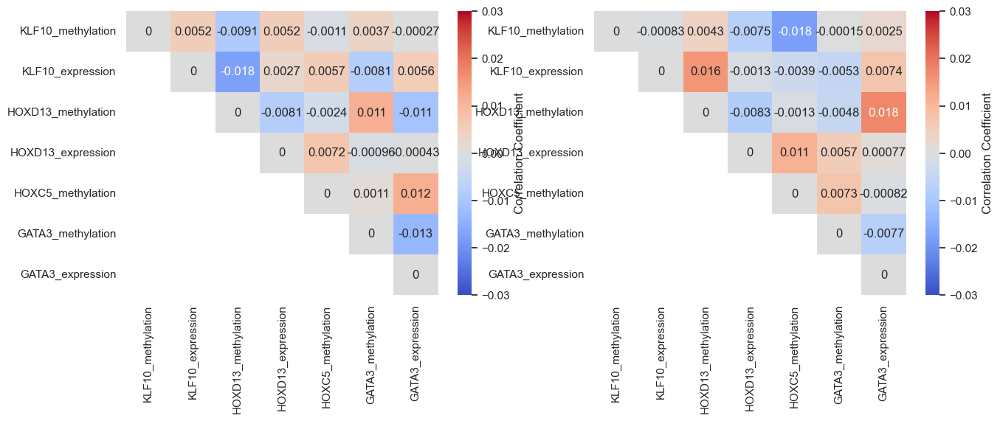

In [520]:
columns_oi = ['KLF10_methylation', 'KLF10_expression', 'HOXD13_methylation', 'HOXD13_expression', 'HOXC5_methylation', 'GATA3_methylation', 'GATA3_expression']
f, ax = plt.subplots(1,2, figsize = (15,5))
sns.heatmap(dragons['cms2'].loc[columns_oi, columns_oi], annot=True, cmap='coolwarm', center=0, cbar_kws={'label': 'Correlation Coefficient'}, vmin = -0.03, vmax = 0.03, mask = np.tril(np.ones(dragons['cms2'].loc[columns_oi, columns_oi].shape), k=-1), ax = ax[0])
sns.heatmap(dragons['cms4'].loc[columns_oi, columns_oi], annot=True, cmap='coolwarm', center=0, cbar_kws={'label': 'Correlation Coefficient'}, vmin = -0.03, vmax = 0.03, mask = np.tril(np.ones(dragons['cms4'].loc[columns_oi, columns_oi].shape), k=-1), ax = ax[1])

<Axes: >

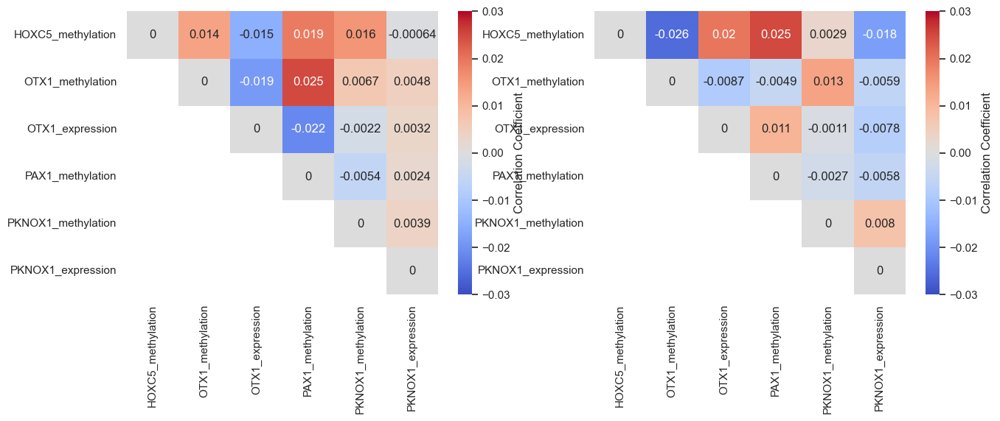

In [526]:
columns_oi = ['HOXC5_methylation', 'OTX1_methylation', 'OTX1_expression', 'PAX1_methylation',  'PKNOX1_methylation', 'PKNOX1_expression']
f, ax = plt.subplots(1,2, figsize = (15,5))
sns.heatmap(dragons['cms2'].loc[columns_oi, columns_oi], annot=True, cmap='coolwarm', center=0, cbar_kws={'label': 'Correlation Coefficient'}, vmin = -0.03, vmax = 0.03, mask = np.tril(np.ones(dragons['cms2'].loc[columns_oi, columns_oi].shape), k=-1), ax = ax[0])
sns.heatmap(dragons['cms4'].loc[columns_oi, columns_oi], annot=True, cmap='coolwarm', center=0, cbar_kws={'label': 'Correlation Coefficient'}, vmin = -0.03, vmax = 0.03, mask = np.tril(np.ones(dragons['cms4'].loc[columns_oi, columns_oi].shape), k=-1), ax = ax[1])

<Axes: >

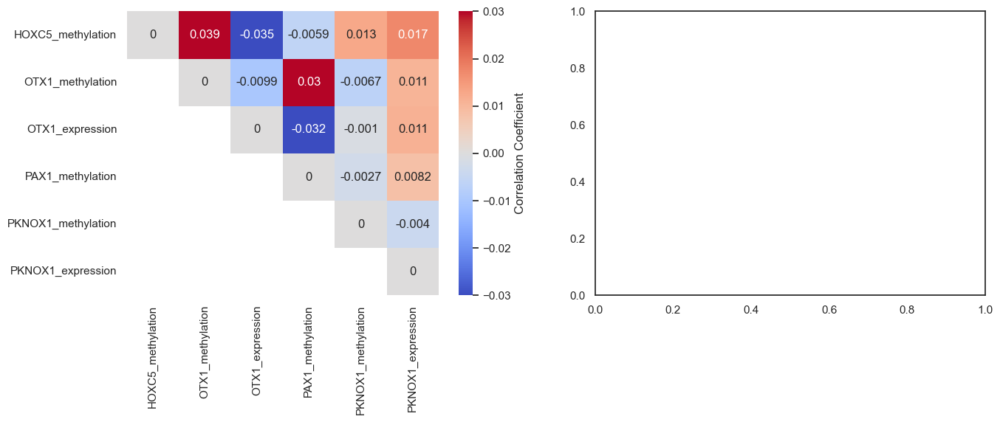

In [527]:
f, ax = plt.subplots(1,2, figsize = (15,5))
sns.heatmap(dragons['cms2'].loc[columns_oi, columns_oi]-dragons['cms4'].loc[columns_oi, columns_oi] , annot=True, cmap='coolwarm', center=0, cbar_kws={'label': 'Correlation Coefficient'}, vmin = -0.03, vmax = 0.03, mask = np.tril(np.ones(dragons['cms2'].loc[columns_oi, columns_oi].shape), k=-1), ax = ax[0])

### Values of CMS2 and CMS4 POU2F2 - TP53

In [473]:
columns_oi = ['POU2F2_methylation', 'POU2F2_expression', 'TP53_methylation', 'TP53_expression','SNAPC4_expression', 'SNAPC4_methylation', 'NFKB2_methylation', 'NFKB2_expression']
dragons['cms2'].loc[columns_oi, columns_oi]

,POU2F2_methylation,POU2F2_expression,TP53_methylation,TP53_expression,SNAPC4_expression,SNAPC4_methylation,NFKB2_methylation,NFKB2_expression
POU2F2_methylation,0.000000,-0.002874,0.002333,-0.024709,0.007299,-0.029514,-0.004731,-0.010850
POU2F2_expression,-0.002874,0.000000,0.000759,-0.001940,0.002036,-0.000685,-0.001227,0.002401
TP53_methylation,0.002333,0.000759,0.000000,-0.002305,0.003417,0.004521,-0.001458,0.003330
TP53_expression,-0.024709,-0.001940,-0.002305,0.000000,0.003521,0.024152,0.004429,0.008833
SNAPC4_expression,0.007299,0.002036,0.003417,0.003521,0.000000,0.001459,-0.001559,0.002398
SNAPC4_methylation,-0.029514,-0.000685,0.004521,0.024152,0.001459,0.000000,0.003347,0.008470
NFKB2_methylation,-0.004731,-0.001227,-0.001458,0.004429,-0.001559,0.003347,0.000000,-0.002602
NFKB2_expression,-0.010850,0.002401,0.003330,0.008833,0.002398,0.008470,-0.002602,0.000000


<Axes: >

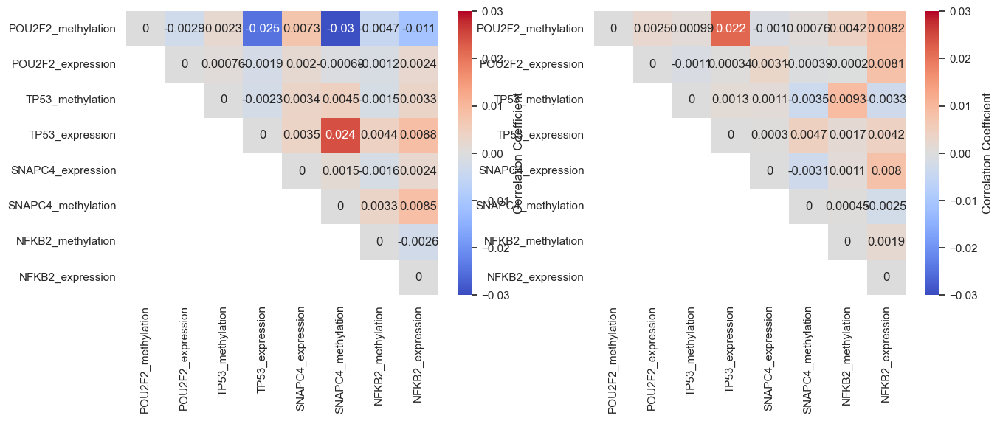

In [474]:
f, ax = plt.subplots(1,2, figsize = (15,5))
sns.heatmap(dragons['cms2'].loc[columns_oi, columns_oi], annot=True, cmap='coolwarm', center=0, cbar_kws={'label': 'Correlation Coefficient'}, vmin = -0.03, vmax = 0.03, mask = np.tril(np.ones(dragons['cms2'].loc[columns_oi, columns_oi].shape), k=-1), ax = ax[0])
sns.heatmap(dragons['cms4'].loc[columns_oi, columns_oi], annot=True, cmap='coolwarm', center=0, cbar_kws={'label': 'Correlation Coefficient'}, vmin = -0.03, vmax = 0.03, mask = np.tril(np.ones(dragons['cms4'].loc[columns_oi, columns_oi].shape), k=-1), ax = ax[1])

<Axes: >

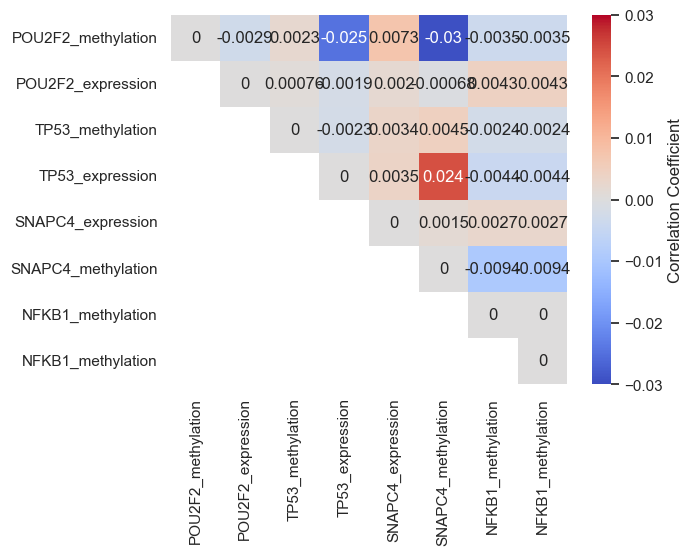

In [464]:
sns.heatmap(dragons['cms2'].loc[columns_oi, columns_oi], annot=True, cmap='coolwarm', center=0, cbar_kws={'label': 'Correlation Coefficient'}, vmin = -0.03, vmax = 0.03, mask = np.tril(np.ones(dragons['cms2'].loc[columns_oi, columns_oi].shape), k=-1))

/var/folders/1b/jphhn26s4zgfr0k1rxj7wfqr0000gn/T/ipykernel_3020/212580184.py:116: UserWarning: Glyph 11035 (\N{BLACK LARGE SQUARE}) missing from font(s) Arial.
  plt.tight_layout()
/var/folders/1b/jphhn26s4zgfr0k1rxj7wfqr0000gn/T/ipykernel_3020/212580184.py:116: UserWarning: Glyph 128314 (\N{UP-POINTING RED TRIANGLE}) missing from font(s) Arial.
  plt.tight_layout()
/Users/violafanfani/miniconda3/envs/m1-ml-py10/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 11035 (\N{BLACK LARGE SQUARE}) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)
/Users/violafanfani/miniconda3/envs/m1-ml-py10/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 128314 (\N{UP-POINTING RED TRIANGLE}) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)


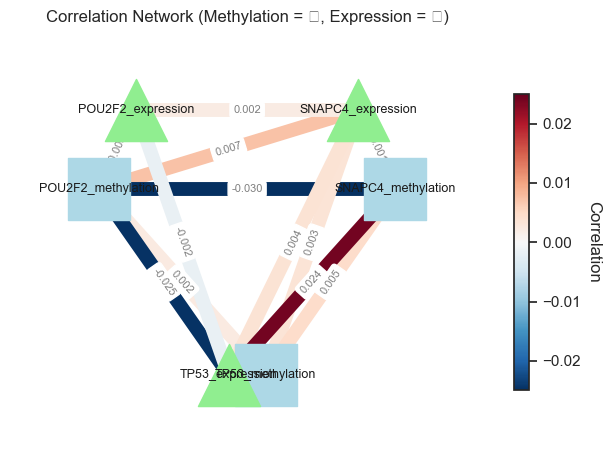

In [413]:
import matplotlib.pyplot as plt
import networkx as nx
import pandas as pd
import numpy as np
import matplotlib.colors as mcolors
import matplotlib.cm as cm

# Step 1: Create the correlation matrix from your data
data = dragons['cms2'].loc[columns_oi, columns_oi]
columns = list(data.keys())
corr_df = pd.DataFrame(data, index=columns)

# Step 2: Build the graph
G = nx.Graph()
threshold = 0.001

# Add nodes with type info
for col in columns:
    node_type = 'methylation' if 'methylation' in col else 'expression'
    G.add_node(col, type=node_type)
    
# Add edges based on threshold
for i in range(len(columns)):
    for j in range(i + 1, len(columns)):
        weight = corr_df.iloc[i, j]
        if abs(weight) >= threshold:
            G.add_edge(columns[i], columns[j], weight=weight)

# Step 3: Set layout
# Step 3: Set layout
pos = {
    'POU2F2_expression':    (-1.2, 0.5),
    'POU2F2_methylation':   (-1.6, 0.2),
    
    'TP53_expression':      (-0.2, -0.5),
    'TP53_methylation':     (0.2, -0.5),
    
    'SNAPC4_expression':    (1.2, 0.5),
    'SNAPC4_methylation':   (1.6, 0.2),
}

# Step 4: Draw nodes by shape
methylation_nodes = [n for n, d in G.nodes(data=True) if d['type'] == 'methylation']
expression_nodes = [n for n, d in G.nodes(data=True) if d['type'] == 'expression']

# Draw methylation as squares
nx.draw_networkx_nodes(
    G, pos,
    nodelist=methylation_nodes,
    node_shape='s',
    node_color='lightblue',
    #edgecolors='black',
    node_size=2000
)

# Draw expression as triangles
nx.draw_networkx_nodes(
    G, pos,
    nodelist=expression_nodes,
    node_shape='^',
    node_color='lightgreen',
    #edgecolors='black',
    node_size=2000
)

# Draw labels
nx.draw_networkx_labels(G, pos, font_size=9)

# Step 5: Draw edges with color by correlation
edges = G.edges(data=True)
weights = [d['weight'] for _, _, d in edges]

# Fixed normalization between -0.025 and 0.025
norm = mcolors.TwoSlopeNorm(vmin=-0.025, vcenter=0, vmax=0.025)
cmap = cm.RdBu_r

# Create edge colors with full opacity
edge_colors = []
for w in weights:
    rgba = list(cmap(norm(w)))  # e.g. [r,g,b,a]
    rgba[3] = 1.0               # set alpha to 1 (fully opaque)
    edge_colors.append(tuple(rgba))


nx.draw_networkx_edges(G, pos, edge_color=edge_colors, width=10)

# Draw edge labels
edge_labels = {(u, v): f"{d['weight']:.3f}" for u, v, d in edges}
nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels, font_size=8, font_color='gray')

# Step 6: Add colorbar
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
ax = plt.gca()
cbar = plt.colorbar(sm, ax=ax, shrink=0.7)
cbar.set_label("Correlation", rotation=270, labelpad=15)

# Final plot tweaks
plt.title("Correlation Network (Methylation = ⬛, Expression = 🔺)")
plt.axis('off')

# Despine (remove frame)
plt.gca().spines[['top', 'right', 'left', 'bottom']].set_visible(False)




ax = plt.gca()
x_vals, y_vals = zip(*pos.values())
x_margin = (max(x_vals) - min(x_vals)) * 0.3  # 10% margin
y_margin = (max(y_vals) - min(y_vals)) * 0.3

ax.set_xlim(min(x_vals) - x_margin, max(x_vals) + x_margin)
ax.set_ylim(min(y_vals) - y_margin, max(y_vals) + y_margin)

plt.tight_layout()
plt.show()


<Axes: >

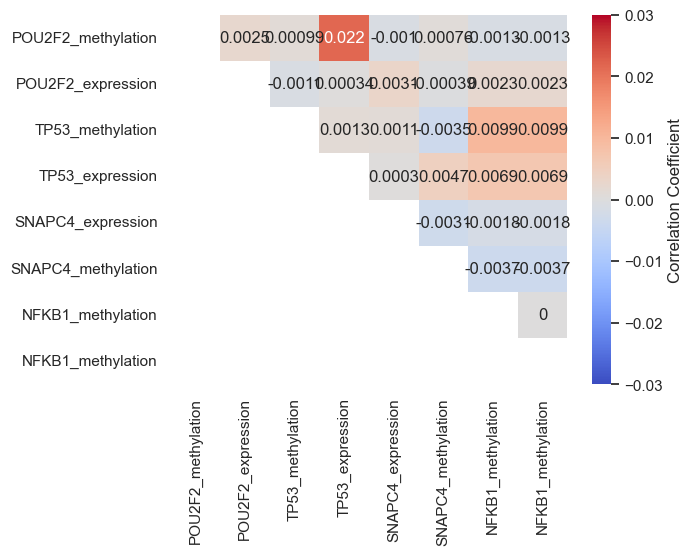

In [465]:
sns.heatmap(dragons['cms4'].loc[columns_oi, columns_oi], annot=True, cmap='coolwarm', center=0, cbar_kws={'label': 'Correlation Coefficient'}, vmin = -0.03, vmax = 0.03, mask = np.tril(np.ones(dragons['cms4'].loc[columns_oi, columns_oi].shape)))

/Users/violafanfani/miniconda3/envs/m1-ml-py10/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 11035 (\N{BLACK LARGE SQUARE}) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)
/Users/violafanfani/miniconda3/envs/m1-ml-py10/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 128314 (\N{UP-POINTING RED TRIANGLE}) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)


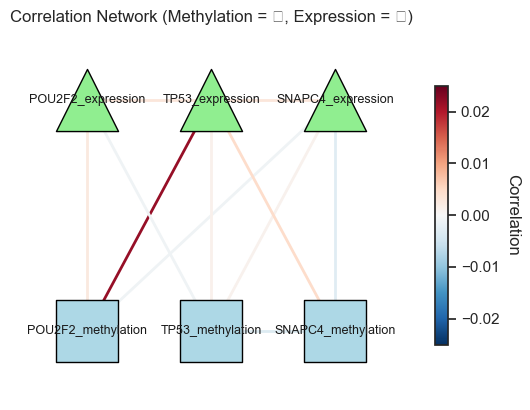

In [398]:
# Step 1: Create the correlation matrix from your data
data = dragons['cms4'].loc[columns_oi, columns_oi]
columns = list(data.keys())
corr_df = pd.DataFrame(data, index=columns)

# Step 2: Build the graph
G = nx.Graph()
threshold = 0.001

# Add nodes with type info
for col in columns:
    node_type = 'methylation' if 'methylation' in col else 'expression'
    G.add_node(col, type=node_type)

# Add edges based on threshold
for i in range(len(columns)):
    for j in range(i + 1, len(columns)):
        weight = corr_df.iloc[i, j]
        if abs(weight) >= threshold:
            G.add_edge(columns[i], columns[j], weight=weight)

# Step 3: Set layout
pos = {
    'POU2F2_expression':    (-1.2, 0.5),
    'POU2F2_methylation':   (-1.2, -0.5),
    
    'TP53_expression':      (0, 0.5),
    'TP53_methylation':     (0, -0.5),
    
    'SNAPC4_expression':    (1.2, 0.5),
    'SNAPC4_methylation':   (1.2, -0.5),
}

# Step 4: Draw nodes by shape
methylation_nodes = [n for n, d in G.nodes(data=True) if d['type'] == 'methylation']
expression_nodes = [n for n, d in G.nodes(data=True) if d['type'] == 'expression']

# Draw methylation as squares
nx.draw_networkx_nodes(
    G, pos,
    nodelist=methylation_nodes,
    node_shape='s',
    node_color='lightblue',
    edgecolors='black',
    node_size=2000
)

# Draw expression as triangles
nx.draw_networkx_nodes(
    G, pos,
    nodelist=expression_nodes,
    node_shape='^',
    node_color='lightgreen',
    edgecolors='black',
    node_size=2000
)

# Draw labels
nx.draw_networkx_labels(G, pos, font_size=9)

# Step 5: Draw edges with color by correlation
edges = G.edges(data=True)
weights = [d['weight'] for _, _, d in edges]

# Colormap setup
norm = mcolors.TwoSlopeNorm(vmin=-0.025, vcenter=0, vmax=0.025)
cmap = cm.RdBu_r
edge_colors = [cmap(norm(w)) for w in weights]

nx.draw_networkx_edges(G, pos, edge_color=edge_colors, width=2)

# Draw edge labels
edge_labels = {(u, v): f"{d['weight']:.3f}" for u, v, d in edges}
#nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels, font_size=8, font_color='gray')

# Step 6: Add colorbar
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
ax = plt.gca()
cbar = plt.colorbar(sm, ax=ax, shrink=0.7)
cbar.set_label("Correlation", rotation=270, labelpad=15)

# Final plot tweaks
plt.title("Correlation Network (Methylation = ⬛, Expression = 🔺)")
plt.axis('off')

# Despine (remove frame)
plt.gca().spines[['top', 'right', 'left', 'bottom']].set_visible(False)


ax = plt.gca()
x_vals, y_vals = zip(*pos.values())
x_margin = (max(x_vals) - min(x_vals)) * 0.3  # 10% margin
y_margin = (max(y_vals) - min(y_vals)) * 0.3

ax.set_xlim(min(x_vals) - x_margin, max(x_vals) + x_margin)
ax.set_ylim(min(y_vals) - y_margin, max(y_vals) + y_margin)

#plt.tight_layout()
plt.show()


## From other paper

In [477]:
a = ['AP1','KLF','EGR','SP','ZNF740','POU2F2','REL','RELA','MZF1','STAT1','STAT3','NFKB1','NFKB2','TP53','TP63','TP53','E2F8','E2F7','MTF1','RELB','YY2','ZNF143','PRDM1','ZBED1','BCL6B','RBPJ']
a

['AP1',
 'KLF',
 'EGR',
 'SP',
 'ZNF740',
 'POU2F2',
 'REL',
 'RELA',
 'MZF1',
 'STAT1',
 'STAT3',
 'NFKB1',
 'NFKB2',
 'TP53',
 'TP63',
 'TP53',
 'E2F8',
 'E2F7',
 'MTF1',
 'RELB',
 'YY2',
 'ZNF143',
 'PRDM1',
 'ZBED1',
 'BCL6B',
 'RBPJ']

In [480]:
a_dragon = [i for i in dragons['cms2'].index if i.split('_')[0] in a]
dragons['cms2'].loc[a_dragon, a_dragon]
dragons['cms4'].loc[a_dragon, a_dragon]

,BCL6B_methylation,E2F7_methylation,E2F8_methylation,MTF1_methylation,MZF1_methylation,NFKB1_methylation,NFKB2_methylation,POU2F2_methylation,PRDM1_methylation,REL_methylation,...,MZF1_expression,NFKB1_expression,NFKB2_expression,POU2F2_expression,PRDM1_expression,REL_expression,RELB_expression,STAT1_expression,TP53_expression,YY2_expression
BCL6B_methylation,0.000000,-0.004689,-0.002699,0.003310,0.003895,-0.001244,0.008737,0.017719,-0.004792,-0.001696,...,0.000748,-0.000059,0.002263,-0.005770,-0.000228,-0.000276,0.001436,-0.001835,0.003937,0.002781
E2F7_methylation,-0.004689,0.000000,-0.000851,0.004515,0.003802,0.002676,0.010596,-0.001526,0.005913,0.003341,...,0.003891,-0.001411,0.001542,0.000319,-0.000428,-0.000410,0.002825,-0.001744,-0.001076,0.006057
E2F8_methylation,-0.002699,-0.000851,0.000000,0.005721,-0.000058,0.002293,0.006917,0.004394,-0.009106,0.009741,...,-0.003266,0.007522,0.005213,0.009261,0.003508,0.003421,0.006085,0.002585,0.003415,0.001834
MTF1_methylation,0.003310,0.004515,0.005721,0.000000,0.000989,-0.000172,0.012243,0.001163,0.005914,-0.005811,...,0.003336,0.003297,-0.000918,0.006070,0.003041,-0.000537,0.000744,-0.004748,0.005411,0.002060
MZF1_methylation,0.003895,0.003802,-0.000058,0.000989,0.000000,0.004032,-0.005158,-0.001053,0.004460,0.007528,...,-0.002708,-0.006252,-0.002064,-0.001630,-0.006588,-0.000467,-0.004520,-0.000619,-0.002296,0.002672
NFKB1_methylation,-0.001244,0.002676,0.002293,-0.000172,0.004032,0.000000,0.000158,-0.001301,0.001148,-0.001140,...,-0.003697,0.003866,0.000058,0.002316,-0.007322,0.002187,0.001592,-0.000641,0.006917,0.001137
NFKB2_methylation,0.008737,0.010596,0.006917,0.012243,-0.005158,0.000158,0.000000,0.004241,0.004075,0.004857,...,0.002585,0.002176,0.001882,-0.000204,-0.000351,0.001250,0.003414,-0.004762,0.001677,0.001940
POU2F2_methylation,0.017719,-0.001526,0.004394,0.001163,-0.001053,-0.001301,0.004241,0.000000,-0.013466,0.008246,...,0.002753,-0.004035,0.008215,0.002450,-0.004318,0.002328,0.000922,0.001109,0.021735,-0.002133
PRDM1_methylation,-0.004792,0.005913,-0.009106,0.005914,0.004460,0.001148,0.004075,-0.013466,0.000000,-0.004660,...,0.002219,-0.005726,-0.002922,-0.000915,-0.012218,-0.002544,-0.002584,-0.006842,0.000903,-0.007085
REL_methylation,-0.001696,0.003341,0.009741,-0.005811,0.007528,-0.001140,0.004857,0.008246,-0.004660,0.000000,...,-0.003000,0.002698,0.005954,-0.002705,0.000628,0.001177,0.003553,0.000195,0.005861,0.005733


<Axes: >

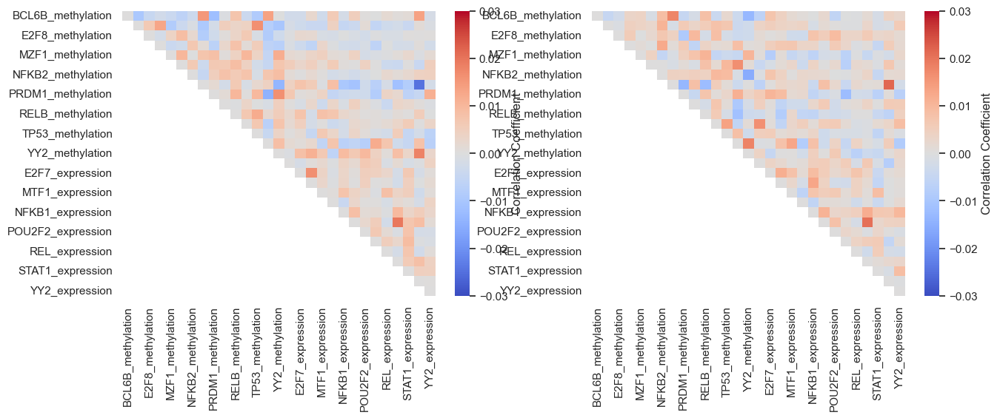

In [482]:
f,ax = plt.subplots(1,2, figsize=(15,5))
sns.heatmap(dragons['cms2'].loc[a_dragon, a_dragon], annot=False, cmap='coolwarm', center=0, cbar_kws={'label': 'Correlation Coefficient'}, vmin = -0.03, vmax = 0.03, mask = np.tril(np.ones(dragons['cms2'].loc[a_dragon, a_dragon].shape), k=-1), ax = ax[0])
sns.heatmap(dragons['cms4'].loc[a_dragon, a_dragon], annot=False, cmap='coolwarm', center=0, cbar_kws={'label': 'Correlation Coefficient'}, vmin = -0.03, vmax = 0.03, mask = np.tril(np.ones(dragons['cms4'].loc[a_dragon, a_dragon].shape), k=-1), ax = ax[1])

<Axes: >

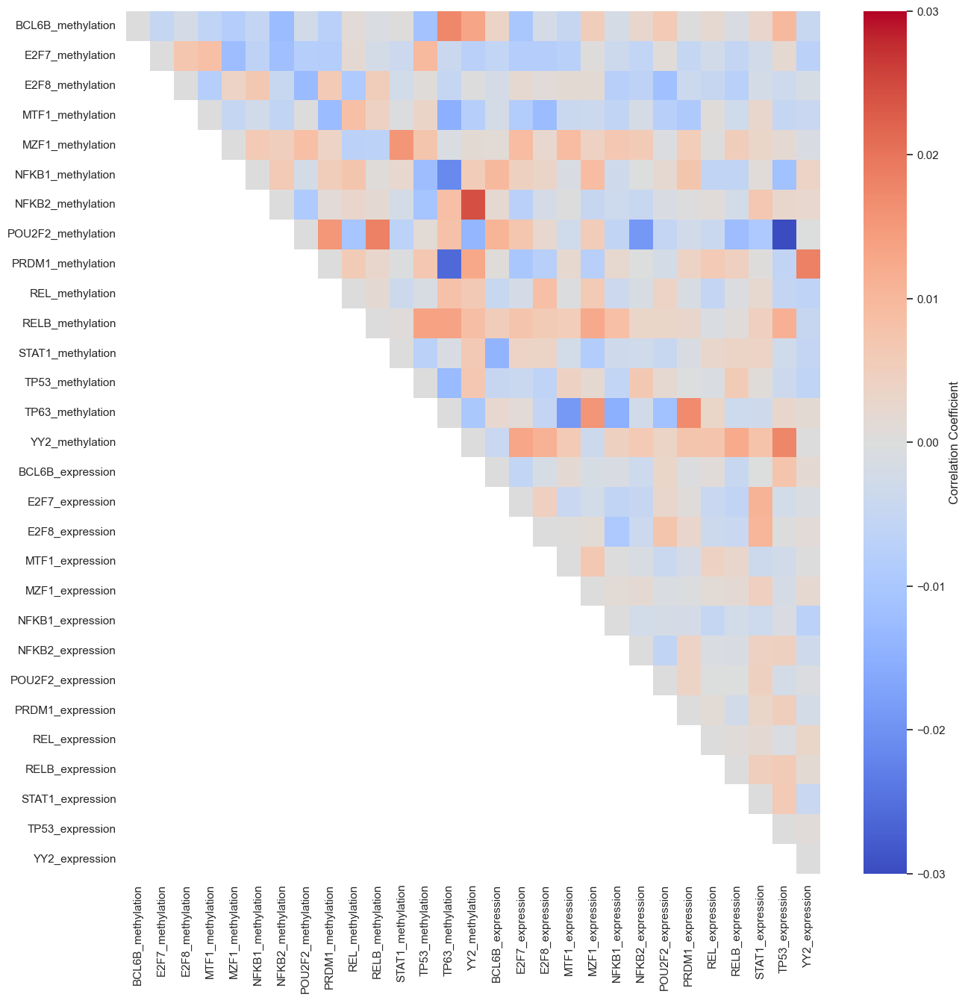

In [485]:
f,ax = plt.subplots(1,1, figsize=(15,15))
sns.heatmap(dragons['cms2'].loc[a_dragon, a_dragon]- dragons['cms4'].loc[a_dragon, a_dragon], annot=False, cmap='coolwarm', center=0, cbar_kws={'label': 'Correlation Coefficient'}, vmin = -0.03, vmax = 0.03, mask = np.tril(np.ones(dragons['cms2'].loc[a_dragon, a_dragon].shape), k=-1), ax = ax)

In [500]:
# Chose 29 rows and columns at random and select the rows and columns from the dragons
import random
random.seed(42)  # For reproducibility
nrandom = 10
null = np.zeros((nrandom, 29*29))
for i in range(nrandom):
    random_indices = random.sample(range(len(dragons['cms2'].index)), 29)
    #random_rows = dragons['cms2'].index[random_indices]
    #random_columns = dragons['cms2'].index[random_indices]
    diff = dragons['cms2'].iloc[random_indices, random_indices].values - dragons['cms4'].iloc[random_indices, random_indices].values
    null[i, :] = diff.flatten()

null.shape

(10, 841)

<Axes: ylabel='Density'>

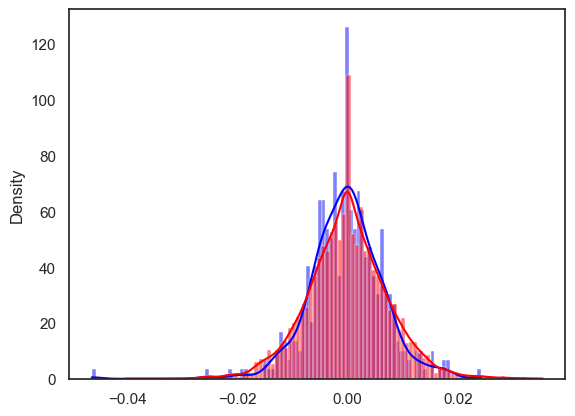

In [510]:
sns.histplot(dragons['cms2'].loc[a_dragon, a_dragon].values.flatten()-dragons['cms4'].loc[a_dragon, a_dragon].values.flatten(), bins=100, kde=True, label='CMS2-CMS4', stat = 'density', color='blue')
sns.histplot(null.flatten(), bins=100, kde=True, label='Null Distribution', color='red', stat = 'density')


In [38]:
dragons['cms4'].loc[columns_oi, columns_oi]

,POU2F2_methylation,POU2F2_expression,TP53_methylation,TP53_expression
POU2F2_methylation,0.000000,0.002450,0.000992,0.021735
POU2F2_expression,0.002450,0.000000,-0.001129,0.000343
TP53_methylation,0.000992,-0.001129,0.000000,0.001333
TP53_expression,0.021735,0.000343,0.001333,0.000000


In [ ]:
dragons['cms2'].loc[:, ['TP53_methylation', 'TP53_expression']]

In [35]:
cms4_meth_cols = [i for i in dragons['cms4'].columns if 'methylation' in i]
cms4_expr_cols = [i for i in dragons['cms4'].columns if 'expression' in i]
# same for cms2
cms2_meth_cols = [i for i in dragons['cms2'].columns if 'methylation' in i]
cms2_expr_cols = [i for i in dragons['cms2'].columns if 'expression' in i]


In [36]:
cms = dragons['cms4'].merge(dragons['cms2'], how='inner', left_index=True, right_index=True, suffixes=('_cms4', '_cms2')).T
cms['subtype'] = ['cms4' if 'cms4' in i else 'cms2' for i in cms.index]
cms['node1'] = [i.split('_')[0] for i in cms.index]
cms

,AC023509.3_methylation,AC092835.1_methylation,AC138696.1_methylation,AEBP1_methylation,AEBP2_methylation,AHDC1_methylation,AIRE_methylation,AKAP8_methylation,AKAP8L_methylation,AKNA_methylation,...,ZNF860_expression,ZNF865_expression,ZNF880_expression,ZSCAN16_expression,ZSCAN22_expression,ZSCAN9_expression,ZXDB_expression,ZXDC_expression,subtype,node1
AC023509.3_methylation_cms4,0.000000,0.011108,0.004494,0.002592,0.002062,-0.000295,-0.009789,-0.001984,-0.014912,0.001344,...,-0.005524,-0.008261,-0.004144,-0.004435,0.003232,-0.003654,-0.000626,0.004203,cms4,AC023509.3
AC092835.1_methylation_cms4,0.011108,0.000000,-0.000793,0.002028,0.003685,-0.003744,-0.006480,0.003413,0.004877,0.002906,...,-0.001120,-0.003921,-0.001629,-0.008124,0.001701,-0.000944,-0.005750,0.005753,cms4,AC092835.1
AC138696.1_methylation_cms4,0.004494,-0.000793,0.000000,-0.001070,0.001865,0.010632,-0.004153,-0.005481,0.008654,0.001408,...,-0.001719,0.000291,0.002323,0.000810,0.003330,-0.002129,0.002084,-0.003577,cms4,AC138696.1
AEBP1_methylation_cms4,0.002592,0.002028,-0.001070,0.000000,0.003630,-0.002109,-0.002940,0.005316,-0.000535,0.001993,...,0.006465,0.001484,-0.003143,0.000178,-0.000613,0.000171,-0.002996,-0.000238,cms4,AEBP1
AEBP2_methylation_cms4,0.002062,0.003685,0.001865,0.003630,0.000000,0.005655,0.006544,-0.003023,-0.010140,0.001949,...,-0.002410,-0.001794,0.002684,-0.000273,-0.001128,0.000634,-0.001507,0.001744,cms4,AEBP2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZSCAN16_expression_cms2,-0.003886,0.000624,-0.003101,-0.003097,-0.002691,0.000562,-0.000263,0.000179,-0.002560,0.000609,...,-0.002027,0.002127,-0.002096,0.000000,0.003321,0.018677,0.000558,-0.001611,cms2,ZSCAN16
ZSCAN22_expression_cms2,-0.002288,-0.003575,-0.003589,-0.001257,0.000671,-0.008611,0.008829,-0.009059,-0.001399,-0.003992,...,0.005722,0.005666,0.005225,0.003321,0.000000,0.004420,0.002249,0.004217,cms2,ZSCAN22
ZSCAN9_expression_cms2,-0.000360,0.002512,-0.001073,-0.002009,-0.000190,0.002566,-0.001283,-0.004518,-0.001940,0.000885,...,0.002011,0.005748,0.000847,0.018677,0.004420,0.000000,0.001024,0.000191,cms2,ZSCAN9
ZXDB_expression_cms2,0.015528,-0.000860,-0.001307,-0.004168,-0.005121,0.000667,0.000381,0.005771,0.005119,-0.004340,...,0.000128,0.003252,-0.002703,0.000558,0.002249,0.001024,0.000000,0.005313,cms2,ZXDB


In [161]:
# Check the correlation between all edges in cms2 and cms4
cms2_edges = dragons['cms2'][cms2_meth_cols + cms2_expr_cols]
cms4_edges = dragons['cms4'][cms4_meth_cols + cms4_expr_cols]
# check the overlapping edges between cms2 and cms4
overlapping_edges = set(cms2_edges.columns).intersection(set(cms4_edges.columns))
# check the correlation between cms2 and cms4 edges
correlations = {}
oe = list(overlapping_edges)
for i in overlapping_edges:
    corr =stats.spearmanr(cms2_edges.loc[oe, i],cms4_edges.loc[oe, i])
    print(f'Correlation between {i} in cms2 and cms4: {corr[0]:.2f}')
    # add the correlation to the correlations dictionary
    correlations[i] = corr[0]
# Create a DataFrame from the correlations dictionary
correlations_df = pd.DataFrame.from_dict(correlations, orient='index', columns=['correlation'])
# Sort the correlations DataFrame by correlation value
correlations_df = correlations_df.sort_values(by='correlation', ascending=False)

    

Correlation between ZNF16_methylation in cms2 and cms4: -0.04
Correlation between KLF4_expression in cms2 and cms4: 0.21
Correlation between SRF_expression in cms2 and cms4: 0.25
Correlation between TAL1_expression in cms2 and cms4: 0.17
Correlation between OSR2_methylation in cms2 and cms4: 0.11
Correlation between ZNF699_methylation in cms2 and cms4: -0.06
Correlation between ZBTB25_methylation in cms2 and cms4: 0.10
Correlation between NFXL1_expression in cms2 and cms4: 0.12
Correlation between ZNF513_expression in cms2 and cms4: 0.20
Correlation between CREBL2_methylation in cms2 and cms4: 0.06
Correlation between ZNF274_expression in cms2 and cms4: 0.11
Correlation between FOXB1_methylation in cms2 and cms4: 0.08
Correlation between KMT2A_methylation in cms2 and cms4: 0.08
Correlation between DACH2_methylation in cms2 and cms4: 0.11
Correlation between ESX1_methylation in cms2 and cms4: 0.08
Correlation between MBD4_methylation in cms2 and cms4: 0.13
Correlation between TBPL2_meth

<Axes: xlabel='correlation', ylabel='Count'>

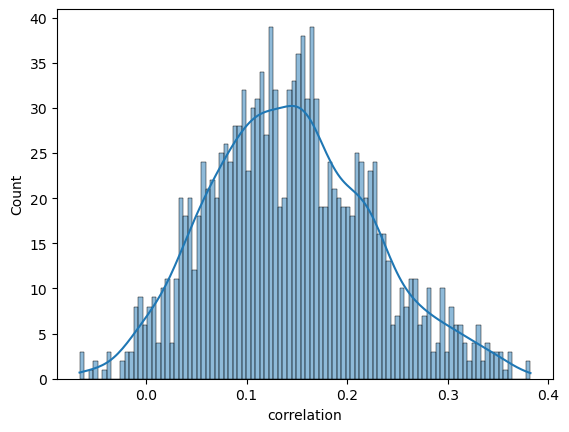

In [167]:
sns.histplot(correlations_df['correlation'], bins=100, kde=True)

In [166]:
correlations_df.sort_values(by='correlation', ascending=True)

,correlation
ZNF562_methylation,-0.066198
HSF2_methylation,-0.063386
ISL2_methylation,-0.062939
ZNF699_methylation,-0.056784
ZFP14_methylation,-0.050073
...,...
HIC1_expression,0.360361
ZNF777_expression,0.361151
PHF1_expression,0.361548
ZNF609_expression,0.378444


In [143]:
cms.T.iloc[:-2,:].loc[:,['ELF4_methylation_cms4','ELF4_methylation_cms2']].sort_values(by='ELF4_methylation_cms2', ascending=False)

,ELF4_methylation_cms4,ELF4_methylation_cms2
ZNF674_methylation,0.043854,0.047178
ZNF81_methylation,0.044439,0.047164
MECP2_methylation,0.043989,0.046994
ZNF41_methylation,0.044161,0.046963
NKRF_methylation,0.043544,0.046775
...,...,...
HOXD13_methylation,-0.00187,-0.012644
FOXO3_methylation,0.000999,-0.012877
MLXIPL_methylation,-0.008208,-0.014084
ZNF283_methylation,-0.01001,-0.0145


<Axes: xlabel='CIC_methylation_cms4', ylabel='CIC_methylation_cms2'>

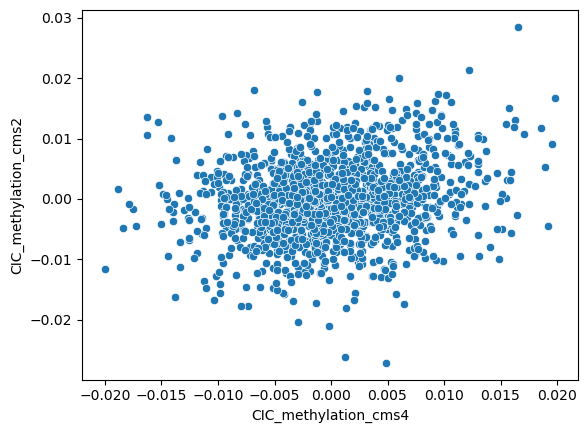

In [164]:
sns.scatterplot(data=cms.T.iloc[:-2,:], x='CIC_methylation_cms4', y='CIC_methylation_cms2')

<Axes: xlabel='correlation', ylabel='Count'>

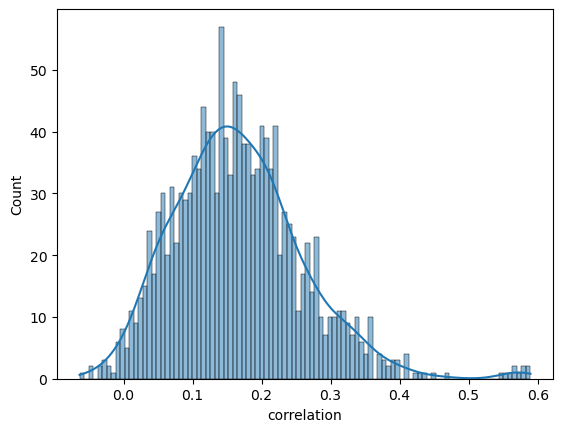

In [126]:
sns.histplot(correlations_df['correlation'], bins=100, kde=True)

In [101]:
dragons['cms4'].loc[:, ['POU2F2_methylation']]
dragons['cms2'].loc[:, ['POU2F2_methylation']]

,POU2F2_methylation
AC023509.3_methylation,-0.005218
AC092835.1_methylation,-0.007668
AC138696.1_methylation,-0.006659
AEBP1_methylation,0.006508
AEBP2_methylation,-0.003934
...,...
ZSCAN16_expression,0.004133
ZSCAN22_expression,0.004509
ZSCAN9_expression,0.008384
ZXDB_expression,-0.004007


Text(0.5, 1.0, 'POU2F2 methylation CMS2 vs CMS4')

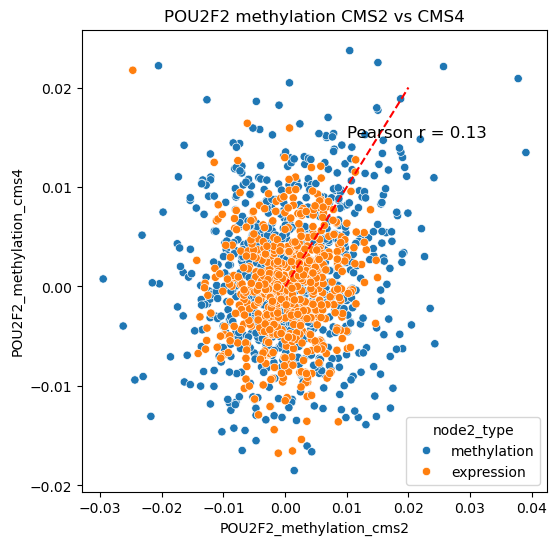

In [113]:
#merge cms2 and cms4 dragons on the index
pou2f2_methylation = dragons['cms2'].loc[:, ['POU2F2_methylation']].merge(dragons['cms4'].loc[:, ['POU2F2_methylation']], left_index=True, right_index=True, suffixes=('_cms2', '_cms4'))
pou2f2_methylation['node2_type'] = pou2f2_methylation.index.str.split('_').str[1]

# scatter plot pou2f2 methylation cms2 vs cms4
f, ax = plt.subplots(figsize=(6, 6))
sns.scatterplot(data=pou2f2_methylation, x='POU2F2_methylation_cms2', y='POU2F2_methylation_cms4', ax=ax, hue = 'node2_type')
# add a line y=x
plt.plot([0, .02], [0, .02], color='red', linestyle='--')
# correlation, calculate the correlation coefficient and show it on the plot
corr = np.corrcoef(pou2f2_methylation['POU2F2_methylation_cms2'], pou2f2_methylation['POU2F2_methylation_cms4'])[0, 1]
plt.text(0.01, 0.015, f'Pearson r = {corr:.2f}', fontsize=12, color='black')
plt.title('POU2F2 methylation CMS2 vs CMS4')

<Axes: ylabel='Count'>

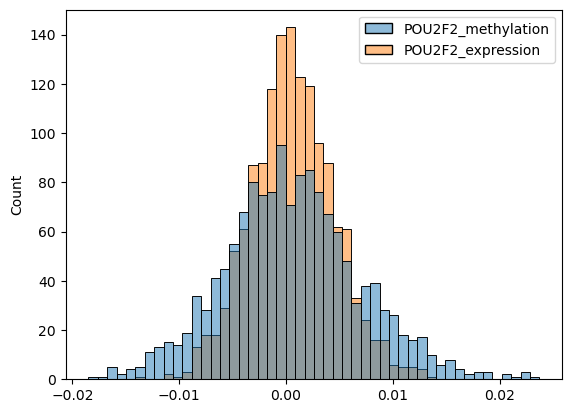

In [95]:
sns.histplot(dragons['cms4'].loc[:, ['POU2F2_methylation', 'POU2F2_expression']].sort_values(by = 'POU2F2_methylation', ascending=False))

In [10]:
# to keep track of all the edges we will create a dataframe where subtypes are in the columns and rows are the edges
dragon = get_long_dragon(dragons)
dragon.head()

                        level_0                 level_1         0
0        AC023509.3_methylation  AC092835.1_methylation  0.010079
1        AC023509.3_methylation  AC138696.1_methylation  0.001609
2        AC023509.3_methylation       AEBP1_methylation -0.001914
3        AC023509.3_methylation       AEBP2_methylation  0.002398
4        AC023509.3_methylation       AHDC1_methylation  0.004454
...                         ...                     ...       ...
1006066      ZSCAN22_expression         ZXDB_expression  0.000783
1006067      ZSCAN22_expression         ZXDC_expression  0.003939
1006068       ZSCAN9_expression         ZXDB_expression -0.000765
1006069       ZSCAN9_expression         ZXDC_expression  0.000768
1006070         ZXDB_expression         ZXDC_expression  0.000498

[1006071 rows x 3 columns]
                          node1                   node2      cms1
0        AC023509.3_methylation  AC092835.1_methylation  0.010079
1        AC023509.3_methylation  AC138696.1_meth

,node1,node2,cms1,cms2,cms3,cms4
0,AC023509.3_methylation,AC092835.1_methylation,0.010079,-0.002448,-0.012452,0.011108
1,AC023509.3_methylation,AC138696.1_methylation,0.001609,0.008164,0.006137,0.004494
2,AC023509.3_methylation,AEBP1_expression,-0.005313,0.002291,0.003407,-0.005202
3,AC023509.3_methylation,AEBP1_methylation,-0.001914,-0.004333,0.000148,0.002592
4,AC023509.3_methylation,AEBP2_expression,0.001178,0.001567,0.001819,0.001794


In [32]:
cms2_data = pd.read_csv("../../tcga-coad-subtype/results/batch-coad-subtype-20240510/tcga_coad_cms2/analysis/dragon/tcga_coad_cms2_dragon_input.tsv", sep='\t', index_col=0)
cms4_data = pd.read_csv("../../tcga-coad-subtype/results/batch-coad-subtype-20240510/tcga_coad_cms4/analysis/dragon/tcga_coad_cms4_dragon_input.tsv", sep='\t', index_col=0)
# Check the data for cms2
cms2_data.loc[:, ['POU2F2_methylation', 'POU2F2_expression', 'TP53_expression', 'TP53_methylation']].sort_values(by='POU2F2_methylation', ascending=True)

,POU2F2_methylation,POU2F2_expression,TP53_expression,TP53_methylation
TCGAbarcode,,,,
TCGA-CK-5912-01A,-2.755679,-0.164359,0.243357,-3.680050
TCGA-AU-3779-01A,-2.664053,1.555611,0.374523,-4.088969
TCGA-G4-6294-01A,-2.637585,-0.307979,0.822872,-3.459991
TCGA-AA-3494-01A,-2.602822,-0.676356,0.542474,-3.366907
TCGA-A6-2680-01A,-2.419650,0.330609,-1.576071,-3.738930
...,...,...,...,...
TCGA-CM-6166-01A,0.139685,-1.776003,-2.318317,-3.455011
TCGA-AZ-6608-01A,0.228158,-1.108854,-2.292037,-3.788695
TCGA-AD-6965-01A,0.445156,0.952358,-1.702325,-3.211742


<Axes: xlabel='POU2F2_methylation', ylabel='TP53_expression'>

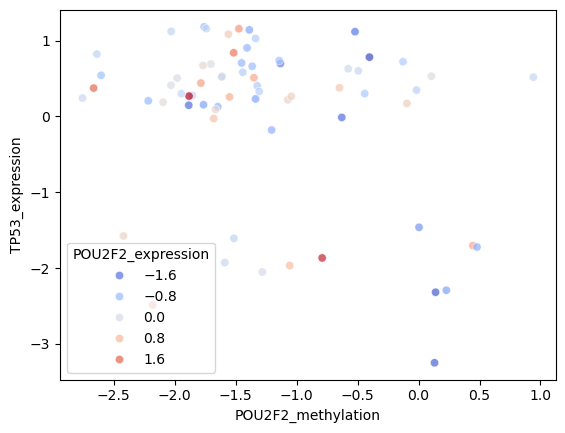

In [37]:
sns.scatterplot(data=cms2_data, x='POU2F2_methylation', hue='POU2F2_expression', y='TP53_expression', sizes=(20, 200), palette = 'coolwarm', alpha=0.7)


In [92]:
[i for i in cms4_data.columns if 'AP1' in i]

['DRAP1_methylation',
 'THAP1_methylation',
 'THAP11_methylation',
 'THAP12_methylation',
 'DRAP1_expression',
 'THAP1_expression',
 'THAP11_expression',
 'THAP12_expression']

In [40]:
sns.scatterplot(data=cms4_data, x='HTERT_methylation', hue='POU2F2_expression', y='TP53_expression', sizes=(20, 200), palette = 'coolwarm', alpha=0.7)


ValueError: Could not interpret value `HTERT_methylation` for `x`. An entry with this name does not appear in `data`.

<Axes: xlabel='POU2F2_methylation', ylabel='TP53_expression'>

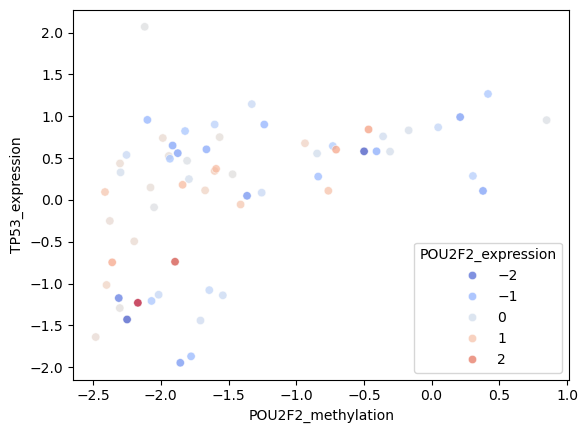

In [38]:
sns.scatterplot(data=cms4_data, x='POU2F2_methylation', hue='POU2F2_expression', y='TP53_expression', sizes=(20, 200), palette = 'coolwarm', alpha=0.7)


<Axes: xlabel='POU2F2_methylation', ylabel='Count'>

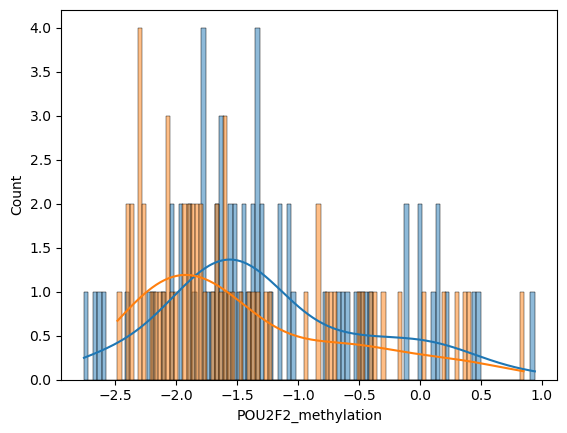

In [33]:
sns.histplot(cms2_data['POU2F2_methylation'], bins=100, kde=True)
sns.histplot(cms4_data['POU2F2_methylation'], bins=100, kde=True)

<Axes: xlabel='TP53_expression', ylabel='Count'>

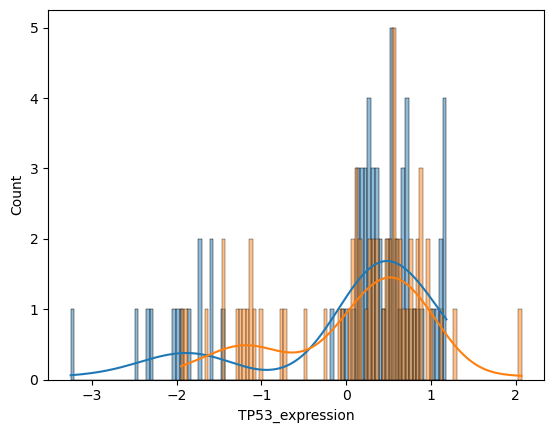

In [34]:
sns.histplot(cms2_data['TP53_expression'], bins=100, kde=True)
sns.histplot(cms4_data['TP53_expression'], bins=100, kde=True)

### HOXA10 and HOXB9 methylation expression

## Check ALPACA and DRAGOn clusters 

In [169]:
# Read clusters from results
ca = pd.read_csv("/Users/violafanfani/Documents/uni-harvard/projects/tcga-data-supplement/results/cms-post/all_cms_dragon_clustA.csv", index_col=0)
ca

,node1,node2,cms1,cms2,cms3,cms4,mean,abs_mean,var,node1_type,node2_type,node1_tf,node2_tf,cms1_abs,cms2_abs,cms3_abs,cms4_abs,same,tf_edge,oi
complete_edge,,,,,,,,,,,,,,,,,,,,
AC023509.3_methylation-ATOH8_expression,AC023509.3_methylation,ATOH8_expression,-0.003581,0.000436,0.001540,0.003505,0.000475,0.002266,0.000009,methylation,expression,AC023509.3,ATOH8,0.003581,0.000436,0.001540,0.003505,0,AC023509.3-ATOH8,False
SRCAP_expression-ZBTB5_expression,SRCAP_expression,ZBTB5_expression,0.001834,-0.000817,0.000371,0.000984,0.000593,0.001002,0.000001,expression,expression,SRCAP,ZBTB5,0.001834,0.000817,0.000371,0.000984,0,SRCAP-ZBTB5,False
SRCAP_expression-ZNF14_expression,SRCAP_expression,ZNF14_expression,0.000819,-0.005128,-0.000245,-0.003323,-0.001969,0.002379,0.000008,expression,expression,SRCAP,ZNF14,0.000819,0.005128,0.000245,0.003323,0,SRCAP-ZNF14,False
SRCAP_expression-ZNF346_expression,SRCAP_expression,ZNF346_expression,-0.000380,-0.001912,-0.000351,0.001492,-0.000288,0.001034,0.000002,expression,expression,SRCAP,ZNF346,0.000380,0.001912,0.000351,0.001492,0,SRCAP-ZNF346,False
SRCAP_expression-ZNF518B_expression,SRCAP_expression,ZNF518B_expression,0.000750,-0.004459,0.001636,0.002351,0.000069,0.002299,0.000010,expression,expression,SRCAP,ZNF518B,0.000750,0.004459,0.001636,0.002351,0,SRCAP-ZNF518B,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZNF292_methylation-ZBTB5_expression,ZNF292_methylation,ZBTB5_expression,0.001228,0.013753,-0.003190,-0.020723,-0.002233,0.009724,0.000203,methylation,expression,ZNF292,ZBTB5,0.001228,0.013753,0.003190,0.020723,0,ZNF292-ZBTB5,True
FOXJ2_methylation-FOXA1_expression,FOXJ2_methylation,FOXA1_expression,-0.009781,0.004980,0.007047,-0.015776,-0.003383,0.009396,0.000124,methylation,expression,FOXJ2,FOXA1,0.009781,0.004980,0.007047,0.015776,0,FOXJ2-FOXA1,True
ZNF280D_methylation-LHX6_expression,ZNF280D_methylation,LHX6_expression,-0.014769,0.009784,-0.004543,-0.009412,-0.004735,0.009627,0.000111,methylation,expression,ZNF280D,LHX6,0.014769,0.009784,0.004543,0.009412,0,ZNF280D-LHX6,True


In [171]:
ca[ca['oi']==True]

,node1,node2,cms1,cms2,cms3,cms4,mean,abs_mean,var,node1_type,node2_type,node1_tf,node2_tf,cms1_abs,cms2_abs,cms3_abs,cms4_abs,same,tf_edge,oi
complete_edge,,,,,,,,,,,,,,,,,,,,
MEOX2_methylation-GATA6_expression,MEOX2_methylation,GATA6_expression,-0.004672,0.015561,-0.003334,-0.015726,-0.002043,0.009823,0.000169,methylation,expression,MEOX2,GATA6,0.004672,0.015561,0.003334,0.015726,0,MEOX2-GATA6,True
TSHZ2_methylation-NR4A2_expression,TSHZ2_methylation,NR4A2_expression,-0.006320,0.015376,0.004932,-0.011009,0.000745,0.009409,0.000140,methylation,expression,TSHZ2,NR4A2,0.006320,0.015376,0.004932,0.011009,0,TSHZ2-NR4A2,True
ZNF699_methylation-POU2F3_expression,ZNF699_methylation,POU2F3_expression,0.003945,0.007217,0.009193,-0.017908,0.000612,0.009566,0.000157,methylation,expression,ZNF699,POU2F3,0.003945,0.007217,0.009193,0.017908,0,ZNF699-POU2F3,True
FOXL1_methylation-GZF1_expression,FOXL1_methylation,GZF1_expression,-0.001421,0.018629,-0.010629,-0.006729,-0.000037,0.009352,0.000169,methylation,expression,FOXL1,GZF1,0.001421,0.018629,0.010629,0.006729,0,FOXL1-GZF1,True
PROX2_methylation-ZNF346_expression,PROX2_methylation,ZNF346_expression,-0.010152,0.007670,-0.006621,-0.012595,-0.005424,0.009259,0.000082,methylation,expression,PROX2,ZNF346,0.010152,0.007670,0.006621,0.012595,0,PROX2-ZNF346,True
EVX1_methylation-ZNF14_expression,EVX1_methylation,ZNF14_expression,0.002046,0.014005,-0.004197,-0.022949,-0.002774,0.010799,0.000238,methylation,expression,EVX1,ZNF14,0.002046,0.014005,0.004197,0.022949,0,EVX1-ZNF14,True
DUXA_methylation-FOXD1_expression,DUXA_methylation,FOXD1_expression,-0.001927,0.015830,0.003292,-0.020377,-0.000795,0.010357,0.000226,methylation,expression,DUXA,FOXD1,0.001927,0.015830,0.003292,0.020377,0,DUXA-FOXD1,True
ZNF274_methylation-FOXJ1_expression,ZNF274_methylation,FOXJ1_expression,-0.012322,0.007666,-0.004350,-0.015223,-0.006057,0.009890,0.000105,methylation,expression,ZNF274,FOXJ1,0.012322,0.007666,0.004350,0.015223,0,ZNF274-FOXJ1,True
ZNF414_methylation-ATOH8_expression,ZNF414_methylation,ATOH8_expression,-0.007554,0.012738,0.006683,-0.010610,0.000314,0.009396,0.000125,methylation,expression,ZNF414,ATOH8,0.007554,0.012738,0.006683,0.010610,0,ZNF414-ATOH8,True


In [ ]:
# Read clusters from results
cd = pd.read_csv("/Users/violafanfani/Documents/uni-harvard/projects/tcga-data-supplement/results/cms-post/all_cms_dragon_clustD.csv", index_col=0)
cd

In [172]:
# Output directory
import os
outputDir = "../results/alpaca-batch-coad-subtype-other-20250624/"
if not os.path.exists(outputDir):
    os.makedirs(outputDir)
# ALPACA membership file
membership_fn = "../data/processed/alpaca-batch-coad-subtype-20240510/membership_csm2_csm4.csv"
# Read membership
membership = pd.read_csv(membership_fn)
membership.head()


,node,module,modularity
0,ALX1_A,1,0.006097
1,ALX3_A,2,0.011064
2,ALX4_A,1,0.005248
3,AR_A,2,0.001445
4,ARGFX_A,2,0.012254


In [173]:
# clean membership table splitting node into node_name and node_type
membership['node_name'] = membership.node.str.split('_').str[0]
membership['node_type'] = membership.node.str.split('_').str[1]
membership.head()

,node,module,modularity,node_name,node_type
0,ALX1_A,1,0.006097,ALX1,A
1,ALX3_A,2,0.011064,ALX3,A
2,ALX4_A,1,0.005248,ALX4,A
3,AR_A,2,0.001445,AR,A
4,ARGFX_A,2,0.012254,ARGFX,A


In [174]:
membership_tf = membership[membership['node_type']=='A']
map_n_tf = membership_tf.loc[:,['module','node_name']].groupby('module').count().rename(columns={'node_name':'n_tf'})
membership_tf = membership_tf.merge(map_n_tf, left_on='module', right_index=True)
membership_tf['raw_modularity'] = membership_tf['modularity'] * membership_tf['n_tf']
membership_tf

,node,module,modularity,node_name,node_type,n_tf,raw_modularity
0,ALX1_A,1,0.006097,ALX1,A,251,1.530413
1,ALX3_A,2,0.011064,ALX3,A,243,2.688537
2,ALX4_A,1,0.005248,ALX4,A,251,1.317150
3,AR_A,2,0.001445,AR,A,243,0.351055
4,ARGFX_A,2,0.012254,ARGFX,A,243,2.977676
...,...,...,...,...,...,...,...
992,ZSCAN4_A,2,0.002642,ZSCAN4,A,243,0.642077
993,ZSCAN5_A,4,0.002277,ZSCAN5,A,267,0.607919
994,ZSCAN5C_A,4,0.000994,ZSCAN5C,A,267,0.265437
995,ZSCAN9_A,1,0.002776,ZSCAN9,A,251,0.696806


In [175]:
ca

,node1,node2,cms1,cms2,cms3,cms4,mean,abs_mean,var,node1_type,node2_type,node1_tf,node2_tf,cms1_abs,cms2_abs,cms3_abs,cms4_abs,same,tf_edge,oi
complete_edge,,,,,,,,,,,,,,,,,,,,
AC023509.3_methylation-ATOH8_expression,AC023509.3_methylation,ATOH8_expression,-0.003581,0.000436,0.001540,0.003505,0.000475,0.002266,0.000009,methylation,expression,AC023509.3,ATOH8,0.003581,0.000436,0.001540,0.003505,0,AC023509.3-ATOH8,False
SRCAP_expression-ZBTB5_expression,SRCAP_expression,ZBTB5_expression,0.001834,-0.000817,0.000371,0.000984,0.000593,0.001002,0.000001,expression,expression,SRCAP,ZBTB5,0.001834,0.000817,0.000371,0.000984,0,SRCAP-ZBTB5,False
SRCAP_expression-ZNF14_expression,SRCAP_expression,ZNF14_expression,0.000819,-0.005128,-0.000245,-0.003323,-0.001969,0.002379,0.000008,expression,expression,SRCAP,ZNF14,0.000819,0.005128,0.000245,0.003323,0,SRCAP-ZNF14,False
SRCAP_expression-ZNF346_expression,SRCAP_expression,ZNF346_expression,-0.000380,-0.001912,-0.000351,0.001492,-0.000288,0.001034,0.000002,expression,expression,SRCAP,ZNF346,0.000380,0.001912,0.000351,0.001492,0,SRCAP-ZNF346,False
SRCAP_expression-ZNF518B_expression,SRCAP_expression,ZNF518B_expression,0.000750,-0.004459,0.001636,0.002351,0.000069,0.002299,0.000010,expression,expression,SRCAP,ZNF518B,0.000750,0.004459,0.001636,0.002351,0,SRCAP-ZNF518B,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZNF292_methylation-ZBTB5_expression,ZNF292_methylation,ZBTB5_expression,0.001228,0.013753,-0.003190,-0.020723,-0.002233,0.009724,0.000203,methylation,expression,ZNF292,ZBTB5,0.001228,0.013753,0.003190,0.020723,0,ZNF292-ZBTB5,True
FOXJ2_methylation-FOXA1_expression,FOXJ2_methylation,FOXA1_expression,-0.009781,0.004980,0.007047,-0.015776,-0.003383,0.009396,0.000124,methylation,expression,FOXJ2,FOXA1,0.009781,0.004980,0.007047,0.015776,0,FOXJ2-FOXA1,True
ZNF280D_methylation-LHX6_expression,ZNF280D_methylation,LHX6_expression,-0.014769,0.009784,-0.004543,-0.009412,-0.004735,0.009627,0.000111,methylation,expression,ZNF280D,LHX6,0.014769,0.009784,0.004543,0.009412,0,ZNF280D-LHX6,True


In [176]:
ca.merge(membership_tf, left_on='node1_tf', right_on = 'node_name').sort_values(by='raw_modularity', ascending=False).head(20)

,node1,node2,cms1,cms2,cms3,cms4,mean,abs_mean,var,node1_type,...,same,tf_edge,oi,node,module,modularity,node_name,node_type,n_tf,raw_modularity
191,MEOX2_expression,ZNF14_expression,0.002234,NaN,NaN,0.006852,0.004543,0.004543,0.000011,expression,...,0,MEOX2-ZNF14,False,MEOX2_A,2,0.009438,MEOX2,A,243,2.293346
49,MEOX2_expression,ZBTB5_expression,0.002107,NaN,NaN,0.010573,0.006340,0.006340,0.000036,expression,...,0,MEOX2-ZBTB5,False,MEOX2_A,2,0.009438,MEOX2,A,243,2.293346
34,MEOX2_methylation,ZNF14_methylation,0.006567,-0.005010,-0.000236,0.000142,0.000366,0.002989,0.000023,methylation,...,0,MEOX2-ZNF14,False,MEOX2_A,2,0.009438,MEOX2,A,243,2.293346
35,MEOX2_methylation,ZNF346_expression,0.002194,-0.001325,0.004663,-0.006182,-0.000163,0.003591,0.000022,methylation,...,0,MEOX2-ZNF346,False,MEOX2_A,2,0.009438,MEOX2,A,243,2.293346
36,MEOX2_methylation,ZNF346_methylation,0.001572,-0.003804,-0.004133,0.001232,-0.001283,0.002685,0.000010,methylation,...,0,MEOX2-ZNF346,False,MEOX2_A,2,0.009438,MEOX2,A,243,2.293346
37,MEOX2_methylation,ZNF518B_expression,0.000080,-0.000774,-0.003119,-0.004869,-0.002170,0.002210,0.000005,methylation,...,0,MEOX2-ZNF518B,False,MEOX2_A,2,0.009438,MEOX2,A,243,2.293346
38,MEOX2_methylation,ZNF518B_methylation,0.002970,0.000560,0.010495,-0.005415,0.002152,0.004860,0.000043,methylation,...,0,MEOX2-ZNF518B,False,MEOX2_A,2,0.009438,MEOX2,A,243,2.293346
39,MEOX2_methylation,ZNF783_expression,0.002765,0.000404,0.000482,-0.001404,0.000562,0.001264,0.000003,methylation,...,0,MEOX2-ZNF783,False,MEOX2_A,2,0.009438,MEOX2,A,243,2.293346
40,MEOX2_methylation,ZNF783_methylation,-0.001373,0.005175,-0.001861,-0.004699,-0.000690,0.003277,0.000017,methylation,...,0,MEOX2-ZNF783,False,MEOX2_A,2,0.009438,MEOX2,A,243,2.293346
42,MEOX2_methylation,ZNF14_expression,-0.003657,0.008255,-0.000705,-0.000988,0.000726,0.003401,0.000027,methylation,...,0,MEOX2-ZNF14,False,MEOX2_A,2,0.009438,MEOX2,A,243,2.293346


In [220]:
top_dragon = pd.read_csv('/Users/violafanfani/Documents/uni-harvard/projects/tcga-data-supplement/results/cms-post/top_dragon_edges_1000.csv', index_col=0)
top_dragon

,cms1,cms2,cms3,cms4,cluster_number,cluster
edge,,,,,,
ZNF345-ZNF790,-0.012222,-0.028967,-0.009026,-0.026827,1,A
HOXB5-HOXB6,-0.006764,-0.020931,-0.013662,-0.022181,1,A
HOXB8-HOXB6,-0.013081,-0.021357,-0.010234,-0.017450,1,A
HOXB8-HOXB5,-0.013158,-0.021508,-0.009058,-0.018268,1,A
HOXB5-HOXB4,-0.008069,-0.022063,-0.012032,-0.019201,1,A
...,...,...,...,...,...,...
ZNF223-MTERF1,0.001222,-0.021014,0.000696,0.008399,2,B
ZNF646-ATMIN,0.010119,-0.014970,-0.002453,0.003783,2,B
HOXD9-ZNF830,-0.003612,-0.004644,-0.008262,-0.014801,1,A


In [234]:
top_dragon['tf1'] = top_dragon.index.str.split('-').str[0]
top_dragon['tf2'] = top_dragon.index.str.split('-').str[1]
top_dragon.sort_values(by = 'cluster')

,cms1,cms2,cms3,cms4,cluster_number,cluster,tf1,tf2
edge,,,,,,,,
ZNF345-ZNF790,-0.012222,-0.028967,-0.009026,-0.026827,1,A,ZNF345,ZNF790
NFATC2-ZNF830,-0.009597,-0.003696,-0.001208,-0.016815,1,A,NFATC2,ZNF830
ZNF785-SP5,-0.004859,0.003895,-0.003689,-0.021122,1,A,ZNF785,SP5
ZNF710-ZNF608,-0.008852,-0.014831,-0.003342,-0.006559,1,A,ZNF710,ZNF608
ZNF304-ZNF880,0.002560,-0.018797,0.000641,-0.011589,1,A,ZNF304,ZNF880
...,...,...,...,...,...,...,...,...
GRHL3-NFATC4,-0.003287,0.013937,-0.008923,0.006879,4,D,GRHL3,NFATC4
BATF-ZNF346,-0.002484,0.010451,-0.005075,0.015015,4,D,BATF,ZNF346
SNAPC4-TP53,-0.003138,0.024152,-0.006478,0.004656,4,D,SNAPC4,TP53


<Axes: ylabel='edge'>

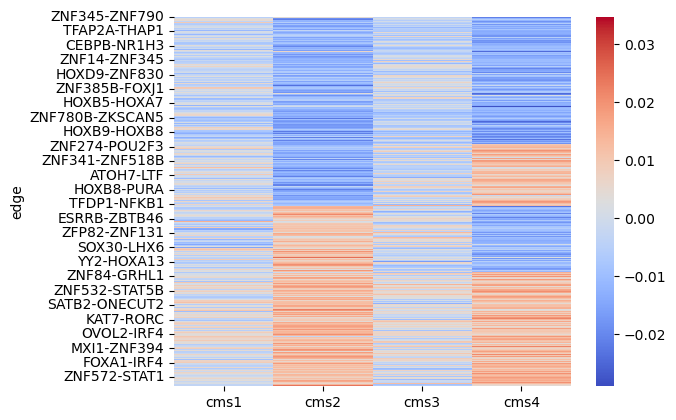

In [233]:
sns.heatmap(top_dragon.sort_values(by = 'cluster').loc[:,['cms1', 'cms2', 'cms3', 'cms4']], cmap='coolwarm')

In [222]:
top_dragon_alpaca = top_dragon.merge(membership_tf.loc[:,["node_name",'module','modularity','raw_modularity']].rename(columns = {'node_name':'tf1','module':'module_tf1', 'modularity':'modularity_tf1','raw_modularity':'raw_modularity_tf1'}), left_on='tf1', right_on='tf1', how= 'left').merge(membership_tf.loc[:,["node_name",'module','modularity','raw_modularity']].rename(columns = {'node_name':'tf2','module':'module_tf2', 'modularity':'modularity_tf2','raw_modularity':'raw_modularity_tf2'}), left_on='tf2', right_on='tf2', how = 'left').sort_values(by='cluster', ascending=False)

In [192]:
top_dragon_alpaca

,cms1,cms2,cms3,cms4,cluster_number,cluster,tf1,tf2,module_tf1,modularity_tf1,module_tf2,modularity_tf2
100,-0.004501,0.019828,-0.005561,0.009264,5,E,HOXC13,ZNF341,1.0,0.005946,4.0,0.012853
121,-0.003138,0.024152,-0.006478,0.004656,5,E,SNAPC4,TP53,NaN,NaN,2.0,0.001361
122,-0.009750,0.013189,0.008299,0.007179,5,E,ATOH7,KAT7,6.0,0.058532,NaN,NaN
67,0.006924,0.016659,0.006193,0.011263,5,E,TFDP1,YY2,4.0,0.001859,8.0,0.001135
124,-0.001595,0.016178,-0.004276,0.016219,5,E,ZNF341,PKNOX1,4.0,0.012853,13.0,0.156065
...,...,...,...,...,...,...,...,...,...,...,...,...
175,-0.005547,0.010889,0.004530,-0.016180,1,A,ZNF329,GRHL3,4.0,0.002852,NaN,NaN
173,-0.011275,0.010901,0.003527,-0.011489,1,A,AC023509.3,RFX2,NaN,NaN,2.0,0.001508
163,-0.001421,0.018629,-0.010629,-0.006729,1,A,FOXL1,GZF1,NaN,NaN,NaN,NaN
127,-0.008393,0.008700,0.010350,-0.010746,1,A,ISL1,NR1I3,NaN,NaN,2.0,0.000923


In [245]:
top_tfs = pd.DataFrame()
membership_tf_ranked = pd.DataFrame()
for k, tab in membership_tf.groupby('module'):
    print(k)
    # select the first 100 edges based on the first 10 tf modularities and the first 10 gene modularities
    print(tab.sort_values('modularity', ascending=False)['node_name'].values[:10].tolist())
    top_tfs = pd.concat([top_tfs, tab.sort_values('modularity', ascending=False).head(10)], axis=0)
    tab['rank'] = tab.modularity.rank(ascending=False)
    tab = tab.sort_values('rank', ascending=True)
    membership_tf_ranked = pd.concat([membership_tf_ranked, tab], axis=0)
    
top_tfs

1
['ZNF334', 'FOXD2', 'HMG20B', 'ZNF33B', 'FOXD3', 'POU3F3', 'VSX2', 'ARID5B', 'NR1H4', 'ZNF25']
2
['LHX9', 'LHX8', 'LBX1', 'PBX4', 'DLX6', 'LHX2', 'SHOX2', 'PRRX1', 'PRRX2', 'SHOX']
3
['ARNT', 'ARNT2', 'BHLHE41', 'ARNTL', 'TFE3', 'BHLHE40', 'MLXIPL', 'MLX', 'SREBF2', 'USF1']
4
['ZNF180', 'ZNF529', 'ZNF341', 'ZNF444', 'ZNF467', 'PRDM9', 'ZNF468', 'ZNF304', 'ZNF383', 'ZNF880']
5
['FOSB', 'FOSL2', 'CREB5', 'ATF3', 'CREM', 'ATF2', 'CREB3L4', 'CREB1', 'FOSL1', 'ATF7']
6
['OLIG3', 'OLIG1', 'ATOH7', 'BHLHE23', 'NEUROD2', 'NEUROG1', 'NEUROG2', 'BHLHE22', 'PPARD', 'RXRA']
7
['HEY1', 'HEY2', 'HEYL', 'HES2', 'HES5', 'HES1', 'HES7', 'MYCN', 'HOXD1', 'HOXC8']
8
['ZNF225', 'ZNF487', 'ZNF235', 'ZNF287', 'ZNF443', 'PRDM6', 'ZNF182', 'ZNF496', 'ZNF181', 'ZNF98']
9
['ELK4', 'ELK3', 'ETV4', 'ETV1', 'ETV3', 'ERF', 'GABPA', 'FLI1', 'FEV', 'ELK1']
10
['GLI3', 'GLI1', 'GLI2']
11
['HOXC9', 'HOXB9', 'HOXA11', 'HOXA10', 'HOXD11', 'KDM2B']
12
['KLF6', 'KLF12', 'KLF14', 'KLF2', 'SP3', 'KLF4', 'KLF3', 'SP9', 'KLF

,node,module,modularity,node_name,node_type,n_tf,raw_modularity
802,ZNF334_A,1,0.010769,ZNF334,A,251,2.703066
154,FOXD2_A,1,0.009720,FOXD2,A,251,2.439805
233,HMG20B_A,1,0.009497,HMG20B,A,251,2.383850
804,ZNF33B_A,1,0.009137,ZNF33B,A,251,2.293408
155,FOXD3_A,1,0.009089,FOXD3,A,251,2.281430
...,...,...,...,...,...,...,...
478,PKNOX2_A,13,0.153524,PKNOX2,A,7,1.074670
632,TGIF2LX_A,13,0.152025,TGIF2LX,A,7,1.064178
633,TGIF2LY_A,13,0.143678,TGIF2LY,A,7,1.005749
355,MEIS2_A,13,0.083718,MEIS2,A,7,0.586027


In [246]:
membership_tf_ranked

,node,module,modularity,node_name,node_type,n_tf,raw_modularity,rank
802,ZNF334_A,1,0.010769,ZNF334,A,251,2.703066,1.0
154,FOXD2_A,1,0.009720,FOXD2,A,251,2.439805,2.0
233,HMG20B_A,1,0.009497,HMG20B,A,251,2.383850,3.0
804,ZNF33B_A,1,0.009137,ZNF33B,A,251,2.293408,4.0
155,FOXD3_A,1,0.009089,FOXD3,A,251,2.281430,5.0
...,...,...,...,...,...,...,...,...
478,PKNOX2_A,13,0.153524,PKNOX2,A,7,1.074670,4.0
632,TGIF2LX_A,13,0.152025,TGIF2LX,A,7,1.064178,5.0
633,TGIF2LY_A,13,0.143678,TGIF2LY,A,7,1.005749,6.0
355,MEIS2_A,13,0.083718,MEIS2,A,7,0.586027,7.0


In [248]:
top_dragon_alpaca = top_dragon.merge(membership_tf_ranked.loc[:,["node_name",'module','modularity','rank']].rename(columns = {'node_name':'tf1','module':'module_tf1', 'modularity':'modularity_tf1','rank':'rank_tf1'}), left_on='tf1', right_on='tf1', how= 'left').merge(membership_tf_ranked.loc[:,["node_name",'module','modularity','rank']].rename(columns = {'node_name':'tf2','module':'module_tf2', 'modularity':'modularity_tf2','rank':'rank_tf2'}), left_on='tf2', right_on='tf2', how = 'left').sort_values(by='cluster', ascending=False)

In [250]:
top_dragon_alpaca['same_module'] = top_dragon_alpaca['module_tf1'] == top_dragon_alpaca['module_tf2']
top_dragon_alpaca[top_dragon_alpaca['same_module']].sort_values(by='rank_tf1', ascending=False).head(20)

,cms1,cms2,cms3,cms4,cluster_number,cluster,tf1,tf2,module_tf1,modularity_tf1,rank_tf1,module_tf2,modularity_tf2,rank_tf2,same_module
925,0.000335,0.014793,0.002273,-0.014172,3,C,ZNF501,ZNF274,4.0,0.000730,259.0,4.0,0.000870,249.0,True
323,-0.007996,0.015766,0.006146,0.005285,4,D,ZNF501,ZBTB42,4.0,0.000730,259.0,4.0,0.003907,87.0,True
462,0.002304,-0.013753,-0.005132,0.012659,2,B,ZNF562,RORC,4.0,0.000774,256.0,4.0,0.001109,232.0,True
37,0.004359,-0.007904,-0.000533,0.031302,2,B,ZNF562,ZFP82,4.0,0.000774,256.0,4.0,0.000975,242.0,True
876,0.003185,-0.008297,-0.009771,0.010498,2,B,ZNF562,ZFP14,4.0,0.000774,256.0,4.0,0.002408,158.0,True
93,-0.001112,0.006101,0.010336,0.021970,4,D,ZNF777,ZNF398,4.0,0.000785,255.0,4.0,0.010201,15.0,True
227,0.007595,0.020942,-0.001142,-0.006614,3,C,ZNF274,ZFP82,4.0,0.000870,249.0,4.0,0.000975,242.0,True
560,0.004747,0.012192,0.005188,0.011111,4,D,ZBTB18,ZNF669,4.0,0.001206,224.0,4.0,0.000822,252.0,True
425,0.005454,-0.017528,-0.003558,-0.007633,1,A,OTX1,ZNF8,1.0,0.001646,215.0,1.0,0.001666,213.0,True
312,0.005202,-0.015984,-0.002901,-0.011215,1,A,PROX2,ATOH1,2.0,0.001009,212.0,2.0,0.003593,80.0,True


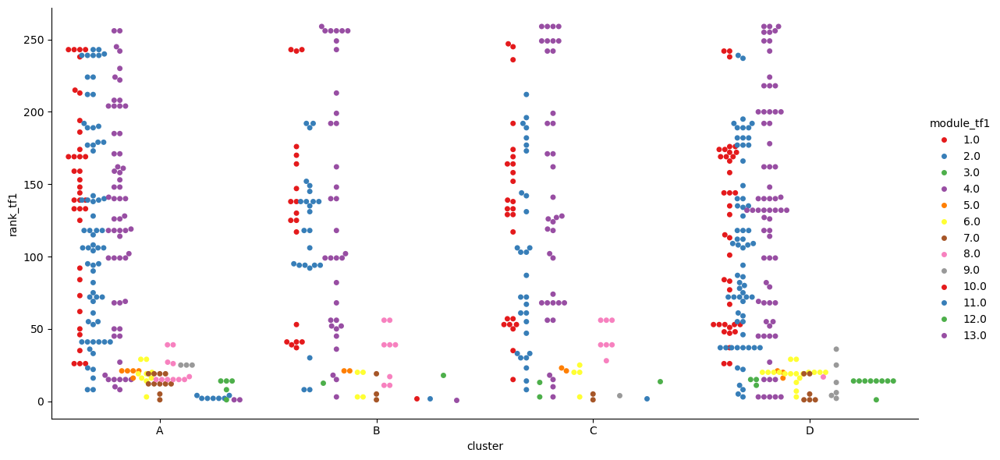

In [261]:
sns.catplot(data = top_dragon_alpaca, x='cluster', y='rank_tf1', kind='swarm', hue = 'module_tf1', palette = 'Set1', dodge=True, height=6, aspect=2, order = ['A', 'B', 'C', 'D'],)

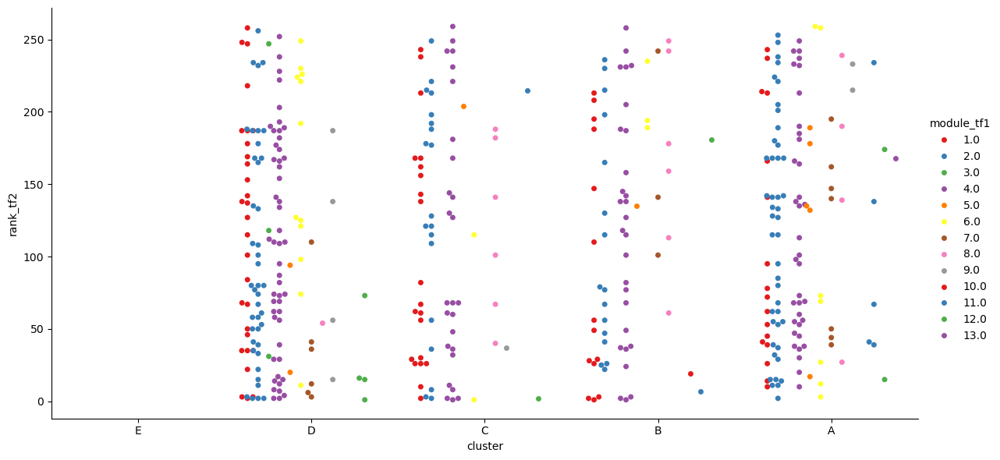

In [259]:
sns.catplot(data = top_dragon_alpaca, x='cluster', y='rank_tf2', kind='swarm', hue = 'module_tf1', palette = 'Set1', dodge=True, height=6, aspect=2)

In [263]:
# Read all dragon
all_dragon = pd.read_csv('/Users/violafanfani/Documents/uni-harvard/projects/tcga-data-supplement/results/cms-post/full_cms_dragon_edges.tsv', index_col=0, sep = '\t')

In [264]:
all_dragon

,node1,node2,cms1,cms2,cms3,cms4,mean,abs_mean,var,node1_type,node2_type,node1_tf,node2_tf,cms1_abs,cms2_abs,cms3_abs,cms4_abs,same
edge,,,,,,,,,,,,,,,,,,
AC023509.3-AC092835.1,AC023509.3_methylation,AC092835.1_methylation,0.010079,-0.002448,-0.012452,0.011108,0.001572,0.009022,1.253803e-04,methylation,methylation,AC023509.3,AC092835.1,0.010079,0.002448,0.012452,0.011108,0
AC023509.3-AC138696.1,AC023509.3_methylation,AC138696.1_methylation,0.001609,0.008164,0.006137,0.004494,0.005101,0.005101,7.673131e-06,methylation,methylation,AC023509.3,AC138696.1,0.001609,0.008164,0.006137,0.004494,0
AC023509.3-AEBP1,AC023509.3_methylation,AEBP1_expression,-0.005313,0.002291,0.003407,-0.005202,-0.001204,0.004053,2.211596e-05,methylation,expression,AC023509.3,AEBP1,0.005313,0.002291,0.003407,0.005202,0
AC023509.3-AEBP1,AC023509.3_methylation,AEBP1_methylation,-0.001914,-0.004333,0.000148,0.002592,-0.000877,0.002247,8.701038e-06,methylation,methylation,AC023509.3,AEBP1,0.001914,0.004333,0.000148,0.002592,0
AC023509.3-AEBP2,AC023509.3_methylation,AEBP2_expression,0.001178,0.001567,0.001819,0.001794,0.001590,0.001590,8.831465e-08,methylation,expression,AC023509.3,AEBP2,0.001178,0.001567,0.001819,0.001794,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZXDC-ZSCAN16,ZXDC_methylation,ZSCAN16_expression,-0.002064,-0.003141,0.000656,0.002289,-0.000565,0.002038,6.173828e-06,methylation,expression,ZXDC,ZSCAN16,0.002064,0.003141,0.000656,0.002289,0
ZXDC-ZSCAN22,ZXDC_methylation,ZSCAN22_expression,-0.003214,0.004883,0.003083,0.008613,0.003341,0.004948,2.440332e-05,methylation,expression,ZXDC,ZSCAN22,0.003214,0.004883,0.003083,0.008613,0
ZXDC-ZSCAN9,ZXDC_methylation,ZSCAN9_expression,-0.001471,0.001704,0.003811,0.008864,0.003227,0.003963,1.883655e-05,methylation,expression,ZXDC,ZSCAN9,0.001471,0.001704,0.003811,0.008864,0


In [268]:
dragon_trans = all_dragon[(all_dragon.node1_type!=all_dragon.node2_type)]
dragon_trans

,node1,node2,cms1,cms2,cms3,cms4,mean,abs_mean,var,node1_type,node2_type,node1_tf,node2_tf,cms1_abs,cms2_abs,cms3_abs,cms4_abs,same
edge,,,,,,,,,,,,,,,,,,
AC023509.3-AEBP1,AC023509.3_methylation,AEBP1_expression,-0.005313,0.002291,0.003407,-0.005202,-0.001204,0.004053,2.211596e-05,methylation,expression,AC023509.3,AEBP1,0.005313,0.002291,0.003407,0.005202,0
AC023509.3-AEBP2,AC023509.3_methylation,AEBP2_expression,0.001178,0.001567,0.001819,0.001794,0.001590,0.001590,8.831465e-08,methylation,expression,AC023509.3,AEBP2,0.001178,0.001567,0.001819,0.001794,0
AC023509.3-AHDC1,AC023509.3_methylation,AHDC1_expression,-0.002381,-0.005991,-0.001529,-0.001857,-0.002939,0.002939,4.262913e-06,methylation,expression,AC023509.3,AHDC1,0.002381,0.005991,0.001529,0.001857,0
AC023509.3-AHR,AC023509.3_methylation,AHR_expression,NaN,NaN,-0.002166,NaN,-0.002166,0.002166,NaN,methylation,expression,AC023509.3,AHR,NaN,NaN,0.002166,NaN,0
AC023509.3-AKAP8L,AC023509.3_methylation,AKAP8L_expression,-0.001239,0.003665,-0.004399,0.005655,0.000921,0.003739,2.096827e-05,methylation,expression,AC023509.3,AKAP8L,0.001239,0.003665,0.004399,0.005655,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZXDC-ZSCAN16,ZXDC_methylation,ZSCAN16_expression,-0.002064,-0.003141,0.000656,0.002289,-0.000565,0.002038,6.173828e-06,methylation,expression,ZXDC,ZSCAN16,0.002064,0.003141,0.000656,0.002289,0
ZXDC-ZSCAN22,ZXDC_methylation,ZSCAN22_expression,-0.003214,0.004883,0.003083,0.008613,0.003341,0.004948,2.440332e-05,methylation,expression,ZXDC,ZSCAN22,0.003214,0.004883,0.003083,0.008613,0
ZXDC-ZSCAN9,ZXDC_methylation,ZSCAN9_expression,-0.001471,0.001704,0.003811,0.008864,0.003227,0.003963,1.883655e-05,methylation,expression,ZXDC,ZSCAN9,0.001471,0.001704,0.003811,0.008864,0


In [269]:
membership_tf_ranked

,node,module,modularity,node_name,node_type,n_tf,raw_modularity,rank
802,ZNF334_A,1,0.010769,ZNF334,A,251,2.703066,1.0
154,FOXD2_A,1,0.009720,FOXD2,A,251,2.439805,2.0
233,HMG20B_A,1,0.009497,HMG20B,A,251,2.383850,3.0
804,ZNF33B_A,1,0.009137,ZNF33B,A,251,2.293408,4.0
155,FOXD3_A,1,0.009089,FOXD3,A,251,2.281430,5.0
...,...,...,...,...,...,...,...,...
478,PKNOX2_A,13,0.153524,PKNOX2,A,7,1.074670,4.0
632,TGIF2LX_A,13,0.152025,TGIF2LX,A,7,1.064178,5.0
633,TGIF2LY_A,13,0.143678,TGIF2LY,A,7,1.005749,6.0
355,MEIS2_A,13,0.083718,MEIS2,A,7,0.586027,7.0


In [294]:
dragon_trans['cms2vscms4'] = dragon_trans['cms2'] - dragon_trans['cms4']
ttt0 = dragon_trans.merge(membership_tf_ranked, left_on = 'node2_tf', right_on = 'node_name', how='inner')
ttt = ttt0.loc[:,['module','cms2','cms4','cms1','cms3']].melt(id_vars=['module'], value_vars=['cms2', 'cms4','cms1','cms3'], value_name='cms', var_name='subtype').sort_values(by='module')
ttt

/var/folders/1b/jphhn26s4zgfr0k1rxj7wfqr0000gn/T/ipykernel_7119/262877564.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dragon_trans['cms2vscms4'] = dragon_trans['cms2'] - dragon_trans['cms4']


,module,subtype,cms
676657,1,cms4,0.008864
631582,1,cms4,NaN
631578,1,cms4,NaN
631575,1,cms4,NaN
631574,1,cms4,NaN
...,...,...,...
884353,14,cms1,0.000091
452462,14,cms4,0.001864
80536,14,cms2,NaN
378985,14,cms4,-0.001492


In [307]:
top0 = dragon_trans.merge(top_tfs, left_on = 'node2_tf', right_on = 'node_name', how='inner')
top0 = top0.merge(top_tfs, left_on = 'node1_tf', right_on = 'node_name', how='inner')

In [308]:
top0

,node1,node2,cms1,cms2,cms3,cms4,mean,abs_mean,var,node1_type,...,node_type_x,n_tf_x,raw_modularity_x,node_y,module_y,modularity_y,node_name_y,node_type_y,n_tf_y,raw_modularity_y
0,ATOH7_methylation,BHLHE22_expression,-0.008465,-0.011976,NaN,0.000340,-0.006700,0.006927,4.025361e-05,methylation,...,A,32,1.634499,ATOH7_A,6,0.058532,ATOH7,A,32,1.873035
1,ATOH7_methylation,BHLHE41_expression,-0.006444,0.000224,-0.002756,-0.006318,-0.003824,0.003936,1.020317e-05,methylation,...,A,17,1.403574,ATOH7_A,6,0.058532,ATOH7,A,32,1.873035
2,ATOH7_methylation,CREB3L4_expression,0.000596,-0.000857,-0.000399,-0.015381,-0.004010,0.004308,5.783753e-05,methylation,...,A,29,1.815623,ATOH7_A,6,0.058532,ATOH7,A,32,1.873035
3,ATOH7_methylation,CREM_expression,0.001290,-0.003575,-0.003341,0.002376,-0.000812,0.002646,9.538412e-06,methylation,...,A,29,1.864707,ATOH7_A,6,0.058532,ATOH7,A,32,1.873035
4,ATOH7_methylation,DLX6_expression,NaN,0.006477,0.007761,NaN,0.007119,0.007119,8.247109e-07,methylation,...,A,243,3.497668,ATOH7_A,6,0.058532,ATOH7,A,32,1.873035
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2605,ZNF880_methylation,ZNF341_expression,-0.000371,-0.001117,-0.004533,-0.012897,-0.004729,0.004729,3.292876e-05,methylation,...,A,267,3.431620,ZNF880_A,4,0.010618,ZNF880,A,267,2.835030
2606,ZNF880_methylation,ZNF385D_expression,0.000276,NaN,NaN,0.000459,0.000367,0.000367,1.668709e-08,methylation,...,A,1,1.000000,ZNF880_A,4,0.010618,ZNF880,A,267,2.835030
2607,ZNF880_methylation,ZNF444_expression,0.000687,0.005499,-0.001646,0.002464,0.001751,0.002574,9.076315e-06,methylation,...,A,267,3.305367,ZNF880_A,4,0.010618,ZNF880,A,267,2.835030
2608,ZNF880_methylation,ZNF467_expression,-0.003410,-0.000115,-0.004332,0.007913,0.000014,0.003942,3.100688e-05,methylation,...,A,267,3.245416,ZNF880_A,4,0.010618,ZNF880,A,267,2.835030


In [341]:
top0['corr_cms2cms4'] = np.corrcoef(top0['cms2'], top0['cms4'])[0, 1]

In [344]:
top0

,node1,node2,cms1,cms2,cms3,cms4,mean,abs_mean,var,node1_type,...,n_tf_x,raw_modularity_x,node_y,module_y,modularity_y,node_name_y,node_type_y,n_tf_y,raw_modularity_y,corr_cms2cms4
0,ATOH7_methylation,BHLHE22_expression,-0.008465,-0.011976,NaN,0.000340,-0.006700,0.006927,4.025361e-05,methylation,...,32,1.634499,ATOH7_A,6,0.058532,ATOH7,A,32,1.873035,NaN
1,ATOH7_methylation,BHLHE41_expression,-0.006444,0.000224,-0.002756,-0.006318,-0.003824,0.003936,1.020317e-05,methylation,...,17,1.403574,ATOH7_A,6,0.058532,ATOH7,A,32,1.873035,NaN
2,ATOH7_methylation,CREB3L4_expression,0.000596,-0.000857,-0.000399,-0.015381,-0.004010,0.004308,5.783753e-05,methylation,...,29,1.815623,ATOH7_A,6,0.058532,ATOH7,A,32,1.873035,NaN
3,ATOH7_methylation,CREM_expression,0.001290,-0.003575,-0.003341,0.002376,-0.000812,0.002646,9.538412e-06,methylation,...,29,1.864707,ATOH7_A,6,0.058532,ATOH7,A,32,1.873035,NaN
4,ATOH7_methylation,DLX6_expression,NaN,0.006477,0.007761,NaN,0.007119,0.007119,8.247109e-07,methylation,...,243,3.497668,ATOH7_A,6,0.058532,ATOH7,A,32,1.873035,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2605,ZNF880_methylation,ZNF341_expression,-0.000371,-0.001117,-0.004533,-0.012897,-0.004729,0.004729,3.292876e-05,methylation,...,267,3.431620,ZNF880_A,4,0.010618,ZNF880,A,267,2.835030,NaN
2606,ZNF880_methylation,ZNF385D_expression,0.000276,NaN,NaN,0.000459,0.000367,0.000367,1.668709e-08,methylation,...,1,1.000000,ZNF880_A,4,0.010618,ZNF880,A,267,2.835030,NaN
2607,ZNF880_methylation,ZNF444_expression,0.000687,0.005499,-0.001646,0.002464,0.001751,0.002574,9.076315e-06,methylation,...,267,3.305367,ZNF880_A,4,0.010618,ZNF880,A,267,2.835030,NaN
2608,ZNF880_methylation,ZNF467_expression,-0.003410,-0.000115,-0.004332,0.007913,0.000014,0.003942,3.100688e-05,methylation,...,267,3.245416,ZNF880_A,4,0.010618,ZNF880,A,267,2.835030,NaN


In [343]:
sns.catplot(top0, x = 'module_x', y = 'corr_cms2vscms4')

ValueError: Could not interpret value `corr_cms2vscms4` for `y`. An entry with this name does not appear in `data`.

<Axes: xlabel='cms4', ylabel='cms2'>

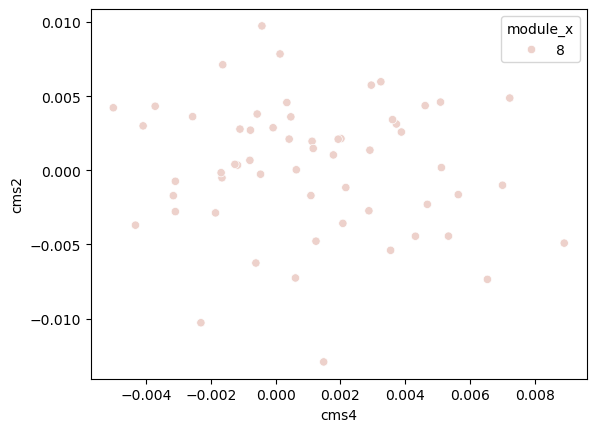

In [340]:
sns.scatterplot(top0[top0['module_x']==8], hue = 'module_x', x = 'cms4',y = 'cms2')

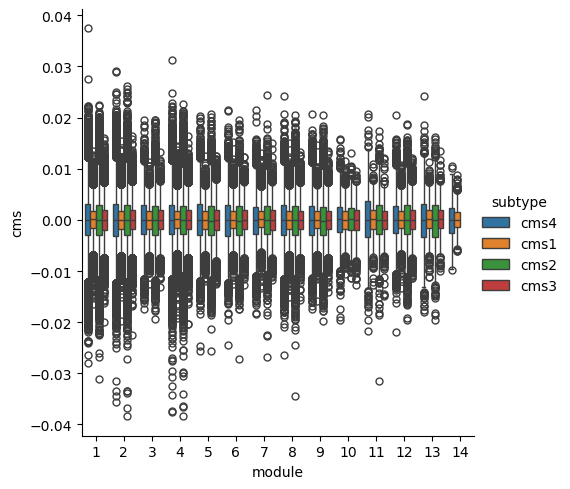

In [291]:
sns.catplot(ttt, x = 'module', y = 'cms', hue ='subtype' , kind = 'box')

In [511]:
## Clusters

In [ ]:
a = ['AP1','KLF','EGR','SP','ZNF740','POU2F2','REL','RELA','MZF1','STAT1','STAT3','NFKB1','NFKB2','TP53','TP63','TP53','E2F8','E2F7','MTF1','RELB','YY2','ZNF143','PRDM1','ZBED1','BCL6B','RBPJ']

In [516]:
clusters = {'cluster_A':'../results/cms-post/all_cms_dragon_clustA.csv',
            'cluster_D':'../results/cms-post/all_cms_dragon_clustD.csv',}
clusterd = pd.read_csv(clusters['cluster_D'], index_col=0)
clustera = pd.read_csv(clusters['cluster_A'], index_col=0)
clusterd 

,node1,node2,cms1,cms2,cms3,cms4,mean,abs_mean,var,node1_type,node2_type,node1_tf,node2_tf,cms1_abs,cms2_abs,cms3_abs,cms4_abs,same,tf_edge,oi
complete_edge,,,,,,,,,,,,,,,,,,,,
NFATC2_methylation-ZNF22_expression,NFATC2_methylation,ZNF22_expression,-0.005934,0.001254,0.004594,-0.001106,-0.000298,0.003222,0.000020,methylation,expression,NFATC2,ZNF22,0.005934,0.001254,0.004594,0.001106,0,NFATC2-ZNF22,False
PITX2_methylation-ZFP82_expression,PITX2_methylation,ZFP82_expression,0.003490,-0.007660,-0.004522,-0.000092,-0.002196,0.003941,0.000024,methylation,expression,PITX2,ZFP82,0.003490,0.007660,0.004522,0.000092,0,PITX2-ZFP82,False
PITX2_methylation-ZFP82_methylation,PITX2_methylation,ZFP82_methylation,-0.000497,0.016627,0.001312,-0.006135,0.002827,0.006143,0.000095,methylation,methylation,PITX2,ZFP82,0.000497,0.016627,0.001312,0.006135,0,PITX2-ZFP82,False
PITX2_methylation-ZNF16_expression,PITX2_methylation,ZNF16_expression,-0.001385,0.007544,0.006383,0.000380,0.003231,0.003923,0.000019,methylation,expression,PITX2,ZNF16,0.001385,0.007544,0.006383,0.000380,0,PITX2-ZNF16,False
PITX2_methylation-ZNF16_methylation,PITX2_methylation,ZNF16_methylation,0.001474,0.004964,-0.017699,0.005572,-0.001422,0.007427,0.000121,methylation,methylation,PITX2,ZNF16,0.001474,0.004964,0.017699,0.005572,0,PITX2-ZNF16,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MYOG_methylation-NFE2L3_expression,MYOG_methylation,NFE2L3_expression,0.004753,-0.011374,-0.008851,0.011738,-0.000933,0.009179,0.000122,methylation,expression,MYOG,NFE2L3,0.004753,0.011374,0.008851,0.011738,0,MYOG-NFE2L3,True
FOXL1_methylation-ZNF584_expression,FOXL1_methylation,ZNF584_expression,-0.008099,-0.007209,-0.006265,0.015607,-0.001492,0.009295,0.000130,methylation,expression,FOXL1,ZNF584,0.008099,0.007209,0.006265,0.015607,0,FOXL1-ZNF584,True
HOXC5_methylation-OTX1_expression,HOXC5_methylation,OTX1_expression,0.002343,-0.015208,0.004414,0.019807,0.002839,0.010443,0.000205,methylation,expression,HOXC5,OTX1,0.002343,0.015208,0.004414,0.019807,0,HOXC5-OTX1,True


In [518]:
clustera[ clustera['node1_tf'].isin(a)]

,node1,node2,cms1,cms2,cms3,cms4,mean,abs_mean,var,node1_type,node2_type,node1_tf,node2_tf,cms1_abs,cms2_abs,cms3_abs,cms4_abs,same,tf_edge,oi
complete_edge,,,,,,,,,,,,,,,,,,,,
YY2_expression-ZBTB5_expression,YY2_expression,ZBTB5_expression,0.000917,0.001214,-0.000594,0.002172,0.000927,0.001224,0.000001,expression,expression,YY2,ZBTB5,0.000917,0.001214,0.000594,0.002172,0,YY2-ZBTB5,False
YY2_expression-ZNF14_expression,YY2_expression,ZNF14_expression,-0.002646,-0.006139,-0.000290,-0.004542,-0.003404,0.003404,0.000006,expression,expression,YY2,ZNF14,0.002646,0.006139,0.000290,0.004542,0,YY2-ZNF14,False
YY2_expression-ZNF518B_expression,YY2_expression,ZNF518B_expression,0.000552,-0.000795,0.001177,0.007560,0.002124,0.002521,0.000014,expression,expression,YY2,ZNF518B,0.000552,0.000795,0.001177,0.007560,0,YY2-ZNF518B,False
YY2_methylation-ZNF518B_expression,YY2_methylation,ZNF518B_expression,-0.000477,0.009711,-0.007850,-0.006085,-0.001175,0.006031,0.000063,methylation,expression,YY2,ZNF518B,0.000477,0.009711,0.007850,0.006085,0,YY2-ZNF518B,False
YY2_methylation-ZNF518B_methylation,YY2_methylation,ZNF518B_methylation,0.001867,-0.011899,0.009145,-0.002375,-0.000815,0.006321,0.000077,methylation,methylation,YY2,ZNF518B,0.001867,0.011899,0.009145,0.002375,0,YY2-ZNF518B,False
YY2_methylation-ZNF783_expression,YY2_methylation,ZNF783_expression,0.006031,-0.004522,-0.000503,0.006926,0.001983,0.004496,0.000030,methylation,expression,YY2,ZNF783,0.006031,0.004522,0.000503,0.006926,0,YY2-ZNF783,False
YY2_methylation-ZNF783_methylation,YY2_methylation,ZNF783_methylation,-0.003949,-0.007843,0.003629,-0.002460,-0.002656,0.004470,0.000023,methylation,methylation,YY2,ZNF783,0.003949,0.007843,0.003629,0.002460,0,YY2-ZNF783,False
YY2_methylation-ZNF346_methylation,YY2_methylation,ZNF346_methylation,0.006496,0.001416,0.000913,-0.002150,0.001669,0.002744,0.000013,methylation,methylation,YY2,ZNF346,0.006496,0.001416,0.000913,0.002150,0,YY2-ZNF346,False
YY2_methylation-ZNF346_expression,YY2_methylation,ZNF346_expression,0.001903,-0.007928,0.003318,0.004188,0.000371,0.004334,0.000031,methylation,expression,YY2,ZNF346,0.001903,0.007928,0.003318,0.004188,0,YY2-ZNF346,False
